In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
color = sns.color_palette()
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.subplots as sp

from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
from sklearn.model_selection import train_test_split, GridSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
import statsmodels.formula.api as SM
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

import warnings
warnings.filterwarnings("ignore")

colours = ['#1f77b4', '#fc6c44', '#2b8a2b', '#fc7c7c', '#9467bd', '#4ba4ad', '#c7ad18', '#7f7f7f', '#69d108'];
axtitle_dict = {'family': 'serif','color':  '#010D36','weight': 'bold','size': 16}
axlab_dict = {'family': 'serif', 'color': 'black','size': 14}

In [2]:
# import io
# from google.colab import files
# uploaded = files.upload()
# df = pd.read_excel(io.BytesIO(uploaded['Customer Churn Data.xlsx']), sheet_name=1)
# df

In [3]:
df = pd.read_excel('Customer Churn Data.xlsx', sheet_name=1)
df

,AccountID,Churn,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
0,20000,1,4,3.0,6.0,Debit Card,Female,3.0,3,Super,2.0,Single,9,1.0,11,1,5,159.93,Mobile
1,20001,1,0,1.0,8.0,UPI,Male,3.0,4,Regular Plus,3.0,Single,7,1.0,15,0,0,120.9,Mobile
2,20002,1,0,1.0,30.0,Debit Card,Male,2.0,4,Regular Plus,3.0,Single,6,1.0,14,0,3,NaN,Mobile
3,20003,1,0,3.0,15.0,Debit Card,Male,2.0,4,Super,5.0,Single,8,0.0,23,0,3,134.07,Mobile
4,20004,1,0,1.0,12.0,Credit Card,Male,2.0,3,Regular Plus,5.0,Single,3,0.0,11,1,3,129.6,Mobile
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,31255,0,10,1.0,34.0,Credit Card,Male,3.0,2,Super,1.0,Married,9,0.0,19,1,4,153.71,Computer
11256,31256,0,13,1.0,19.0,Credit Card,Male,3.0,5,HNI,5.0,Married,7,0.0,16,1,8,226.91,Mobile
11257,31257,0,1,1.0,14.0,Debit Card,Male,3.0,2,Super,4.0,Married,7,1.0,22,1,4,191.42,Mobile
11258,31258,0,23,3.0,11.0,Credit Card,Male,4.0,5,Super,4.0,Married,7,0.0,16,2,9,179.9,Computer


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   AccountID                11260 non-null  int64  
 1   Churn                    11260 non-null  int64  
 2   Tenure                   11158 non-null  object 
 3   City_Tier                11148 non-null  float64
 4   CC_Contacted_LY          11158 non-null  float64
 5   Payment                  11151 non-null  object 
 6   Gender                   11152 non-null  object 
 7   Service_Score            11162 non-null  float64
 8   Account_user_count       11148 non-null  object 
 9   account_segment          11163 non-null  object 
 10  CC_Agent_Score           11144 non-null  float64
 11  Marital_Status           11048 non-null  object 
 12  rev_per_month            11158 non-null  object 
 13  Complain_ly              10903 non-null  float64
 14  rev_growth_yoy        

In [5]:
#Let's check the first & last 5 samples of the data
display('First 5 samples:',df.head().T)
display('Last 5 samples:',df.tail().T)

'First 5 samples:'

,0,1,2,3,4
AccountID,20000,20001,20002,20003,20004
Churn,1,1,1,1,1
Tenure,4,0,0,0,0
City_Tier,3.0,1.0,1.0,3.0,1.0
CC_Contacted_LY,6.0,8.0,30.0,15.0,12.0
Payment,Debit Card,UPI,Debit Card,Debit Card,Credit Card
Gender,Female,Male,Male,Male,Male
Service_Score,3.0,3.0,2.0,2.0,2.0
Account_user_count,3,4,4,4,3
account_segment,Super,Regular Plus,Regular Plus,Super,Regular Plus


'Last 5 samples:'

,11255,11256,11257,11258,11259
AccountID,31255,31256,31257,31258,31259
Churn,0,0,0,0,0
Tenure,10,13,1,23,8
City_Tier,1.0,1.0,1.0,3.0,1.0
CC_Contacted_LY,34.0,19.0,14.0,11.0,22.0
Payment,Credit Card,Credit Card,Debit Card,Credit Card,Credit Card
Gender,Male,Male,Male,Male,Male
Service_Score,3.0,3.0,3.0,4.0,3.0
Account_user_count,2,5,2,5,2
account_segment,Super,HNI,Super,Super,Super


In [6]:
#Dimentions of the dataset
print('The number of rows are ',df.shape[0],'\n''The number of columns (variables) are',df.shape[1])

The number of rows are  11260 
The number of columns (variables) are 19


In [7]:
#Information about the dataset
display(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   AccountID                11260 non-null  int64  
 1   Churn                    11260 non-null  int64  
 2   Tenure                   11158 non-null  object 
 3   City_Tier                11148 non-null  float64
 4   CC_Contacted_LY          11158 non-null  float64
 5   Payment                  11151 non-null  object 
 6   Gender                   11152 non-null  object 
 7   Service_Score            11162 non-null  float64
 8   Account_user_count       11148 non-null  object 
 9   account_segment          11163 non-null  object 
 10  CC_Agent_Score           11144 non-null  float64
 11  Marital_Status           11048 non-null  object 
 12  rev_per_month            11158 non-null  object 
 13  Complain_ly              10903 non-null  float64
 14  rev_growth_yoy        

None

In [8]:
print(' Total duplicates in the data are:', df.duplicated().sum())

 Total duplicates in the data are: 0


In [9]:
# Data Format Checks
format_issues = {}
for column in df.columns:
    if df[column].apply(lambda x: not str(x).replace('.', '', 1).replace('-', '', 1).replace('%', '', 1).isdigit()).any():
        format_issues[column] = df[column]
print("Data Format Issues:")
for column, values in format_issues.items():
    print(f"Column '{column}':")
    print(values)

Data Format Issues:
Column 'Tenure':
0         4
1         0
2         0
3         0
4         0
         ..
11255    10
11256    13
11257     1
11258    23
11259     8
Name: Tenure, Length: 11260, dtype: object
Column 'City_Tier':
0        3.0
1        1.0
2        1.0
3        3.0
4        1.0
        ... 
11255    1.0
11256    1.0
11257    1.0
11258    3.0
11259    1.0
Name: City_Tier, Length: 11260, dtype: float64
Column 'CC_Contacted_LY':
0         6.0
1         8.0
2        30.0
3        15.0
4        12.0
         ... 
11255    34.0
11256    19.0
11257    14.0
11258    11.0
11259    22.0
Name: CC_Contacted_LY, Length: 11260, dtype: float64
Column 'Payment':
0         Debit Card
1                UPI
2         Debit Card
3         Debit Card
4        Credit Card
            ...     
11255    Credit Card
11256    Credit Card
11257     Debit Card
11258    Credit Card
11259    Credit Card
Name: Payment, Length: 11260, dtype: object
Column 'Gender':
0        Female
1          Male
2  

In [10]:
#Let's check unique values in each Categorical column
cat_columns = df.select_dtypes(include = ['object'])

for column in cat_columns:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'Tenure':
[4 0 2 13 11 '#' 9 99 19 20 14 8 26 18 5 30 7 1 23 3 29 6 28 24 25 16 10
 15 22 nan 27 12 21 17 50 60 31 51 61]

Value counts for column 'Payment':
['Debit Card' 'UPI' 'Credit Card' 'Cash on Delivery' 'E wallet' nan]

Value counts for column 'Gender':
['Female' 'Male' 'F' nan 'M']

Value counts for column 'Account_user_count':
[3 4 nan 5 2 '@' 1 6]

Value counts for column 'account_segment':
['Super' 'Regular Plus' 'Regular' 'HNI' 'Regular +' nan 'Super Plus'
 'Super +']

Value counts for column 'Marital_Status':
['Single' 'Divorced' 'Married' nan]

Value counts for column 'rev_per_month':
[9 7 6 8 3 2 4 10 1 5 '+' 130 nan 19 139 102 120 138 127 123 124 116 21
 126 134 113 114 108 140 133 129 107 118 11 105 20 119 121 137 110 22 101
 136 125 14 13 12 115 23 122 117 131 104 15 25 135 111 109 100 103]

Value counts for column 'rev_growth_yoy':
[11 15 14 23 22 16 12 13 17 18 24 19 20 21 25 26 '$' 4 27 28]

Value counts for column 'coupon_used_for_payment'

In [11]:
#Tenure
df['Tenure'] = df['Tenure'].replace('#', np.nan)
df['Tenure'] = pd.to_numeric(df['Tenure'], errors='coerce', downcast='integer')

In [12]:
#Account_user
df['Account_user_count'] = df['Account_user_count'].replace('@', np.nan)
df['Account_user_count'] = pd.to_numeric(df['Account_user_count'], errors='coerce', downcast='integer')

In [13]:
#"rev_per_month"
df['rev_per_month'] = df['rev_per_month'].replace('+', np.nan)
df['rev_per_month'] = pd.to_numeric(df['rev_per_month'], errors='coerce', downcast='integer')

In [14]:
#rev_growth_yoy
df['rev_growth_yoy'] = df['rev_growth_yoy'].replace('$', np.nan)
df['rev_growth_yoy'] = pd.to_numeric(df['rev_growth_yoy'], errors='coerce', downcast='integer')

In [15]:
#coupon_used_for_payment
df['coupon_used_for_payment'] = df['coupon_used_for_payment'].replace(('$','*', '#'), np.nan)
df['coupon_used_for_payment'] = pd.to_numeric(df['coupon_used_for_payment'], errors='coerce', downcast='integer')

In [16]:
#Day_Since_CC_connect
df['Day_Since_CC_connect'] = df['Day_Since_CC_connect'].replace('$' , np.nan)
df['Day_Since_CC_connect'] = pd.to_numeric(df['Day_Since_CC_connect'], errors='coerce', downcast='integer')

In [17]:
#Gender
df['Gender'] = df['Gender'].replace({'F': 'Female', 'M':'Male'})

In [18]:
#account_segment
df['account_segment'] = df['account_segment'].replace({'Regular +': 'Regular Plus', 'Super +':'Super Plus'})

In [19]:
#Cashback
#Definimg custom function to find non-numeric
def has_non_numeric_chars(value):
    try:
        float(value)
        return False
    except ValueError:
        return True

non_numeric_mask = df['cashback'].apply(has_non_numeric_chars)
rows_with_non_numeric = df[non_numeric_mask]
unique_non_numeric_values = rows_with_non_numeric['cashback'].unique()
print(unique_non_numeric_values)

['$']


In [20]:
# We found that there is presence of "$" in the values causing Cashbck to show as Object.
#Let's replace it with Nan
df['cashback'] = df['cashback'].replace('$' , np.nan)
df['cashback'] = pd.to_numeric(df['cashback'], errors='coerce', downcast='float')

In [21]:
#Login_device
#This column has Unexpected value '&&&&' alongside 'Mobile' and 'Computer'. Let's replace it with Nan
df['Login_device'] = df['Login_device'].replace({'&&&&': np.nan })

In [22]:
#Let's check unique values in each Categorical column after changes
cat_columns = df.select_dtypes(include = ['object'])

for column in cat_columns:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'Payment':
['Debit Card' 'UPI' 'Credit Card' 'Cash on Delivery' 'E wallet' nan]

Value counts for column 'Gender':
['Female' 'Male' nan]

Value counts for column 'account_segment':
['Super' 'Regular Plus' 'Regular' 'HNI' nan 'Super Plus']

Value counts for column 'Marital_Status':
['Single' 'Divorced' 'Married' nan]

Value counts for column 'Login_device':
['Mobile' 'Computer' nan]



# Numeric columns

In [23]:
#Dropping Target column & account id for numerical columns
num_columns = df.select_dtypes(include=['float64', 'int64']).drop(columns=['AccountID','Churn'])

In [24]:
#Let's check unique values in each Numeric columns for any inconsistancy
for column in num_columns:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'Tenure':
[ 4.  0.  2. 13. 11. nan  9. 99. 19. 20. 14.  8. 26. 18.  5. 30.  7.  1.
 23.  3. 29.  6. 28. 24. 25. 16. 10. 15. 22. 27. 12. 21. 17. 50. 60. 31.
 51. 61.]

Value counts for column 'City_Tier':
[ 3.  1. nan  2.]

Value counts for column 'CC_Contacted_LY':
[  6.   8.  30.  15.  12.  22.  11.   9.  31.  18.  13.  20.  29.  28.
  26.  14.  10.  25.  27.  17.  23.  33.  19.  35.  24.  16.  32.  21.
  nan  34.   5.   4. 126.   7.  36. 127.  42.  38.  37.  39.  40.  41.
 132.  43. 129.]

Value counts for column 'Service_Score':
[ 3.  2.  1. nan  0.  4.  5.]

Value counts for column 'Account_user_count':
[ 3.  4. nan  5.  2.  1.  6.]

Value counts for column 'CC_Agent_Score':
[ 2.  3.  5.  4. nan  1.]

Value counts for column 'rev_per_month':
[  9.   7.   6.   8.   3.   2.   4.  10.   1.   5.  nan 130.  19. 139.
 102. 120. 138. 127. 123. 124. 116.  21. 126. 134. 113. 114. 108. 140.
 133. 129. 107. 118.  11. 105.  20. 119. 121. 137. 110.  22. 101. 136.
 125.  

In [25]:
# Check Negative values
negative_values = (num_columns < 0).any()
print("Columns with negative values:")
print(negative_values[negative_values].index)

Columns with negative values:
Index([], dtype='object')


In [26]:
#Non -digit entries in Numeric columns other than NAN (Though we already checked this earlier)
non_digit_values = {}
for column in num_columns.columns:
    try:
        num_columns[column].astype(float)
    except ValueError:
        non_digit_values[column] = num_columns[~num_columns[column].str.replace('.', '', 1).str.isnumeric()][column]

print("Columns with non-digit entries:")
print(non_digit_values)

Columns with non-digit entries:
{}


In [27]:
num_columns.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 11 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11042 non-null  float64
 1   City_Tier                11148 non-null  float64
 2   CC_Contacted_LY          11158 non-null  float64
 3   Service_Score            11162 non-null  float64
 4   Account_user_count       10816 non-null  float64
 5   CC_Agent_Score           11144 non-null  float64
 6   rev_per_month            10469 non-null  float64
 7   Complain_ly              10903 non-null  float64
 8   rev_growth_yoy           11257 non-null  float64
 9   coupon_used_for_payment  11257 non-null  float64
 10  Day_Since_CC_connect     10902 non-null  float64
dtypes: float64(11)
memory usage: 967.8 KB


In [28]:
# Change ordinal numeric columns to categorical
df['AccountID'] = df['AccountID'].astype(str)
df['City_Tier'] = df['City_Tier'].astype(str)
df['Complain_ly'] = df['Complain_ly'].astype(str)
df['Service_Score'] = df['Service_Score'].astype(str)
df['Account_user_count'] = df['Account_user_count'].astype(str)
df['CC_Agent_Score'] = df['CC_Agent_Score'].astype(str)

In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   AccountID                11260 non-null  object 
 1   Churn                    11260 non-null  int64  
 2   Tenure                   11042 non-null  float64
 3   City_Tier                11260 non-null  object 
 4   CC_Contacted_LY          11158 non-null  float64
 5   Payment                  11151 non-null  object 
 6   Gender                   11152 non-null  object 
 7   Service_Score            11260 non-null  object 
 8   Account_user_count       11260 non-null  object 
 9   account_segment          11163 non-null  object 
 10  CC_Agent_Score           11260 non-null  object 
 11  Marital_Status           11048 non-null  object 
 12  rev_per_month            10469 non-null  float64
 13  Complain_ly              11260 non-null  object 
 14  rev_growth_yoy        

In [30]:
#Numerical Columns
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Churn,11260.0,0.168384,0.374223,0.0,0.000000,0.00,0.000000,1.0
Tenure,11042.0,11.025086,12.879782,0.0,2.000000,9.00,16.000000,99.0
CC_Contacted_LY,11158.0,17.867091,8.853269,4.0,11.000000,16.00,23.000000,132.0
rev_per_month,10469.0,6.362594,11.909686,1.0,3.000000,5.00,7.000000,140.0
rev_growth_yoy,11257.0,16.193391,3.757721,4.0,13.000000,15.00,19.000000,28.0
coupon_used_for_payment,11257.0,1.790619,1.969551,0.0,1.000000,1.00,2.000000,16.0
Day_Since_CC_connect,10902.0,4.633187,3.697637,0.0,2.000000,3.00,8.000000,47.0
cashback,10787.0,196.236343,178.660522,0.0,147.210007,165.25,200.009995,1997.0


In [31]:
#Categorical Columns
df.select_dtypes(include = ['object']).describe().T

,count,unique,top,freq
AccountID,11260,11260,20000,1
City_Tier,11260,4,1.0,7263
Payment,11151,5,Debit Card,4587
Gender,11152,2,Male,6704
Service_Score,11260,7,3.0,5490
Account_user_count,11260,7,4.0,4569
account_segment,11163,5,Regular Plus,4124
CC_Agent_Score,11260,6,3.0,3360
Marital_Status,11048,3,Married,5860
Complain_ly,11260,3,0.0,7792


# Duplicate values

In [32]:
print(' Total duplicates in the data are:', df.duplicated().sum())

 Total duplicates in the data are: 0


# Missing Values

In [33]:
df = df.applymap(lambda x: np.nan if x == 'nan' else x) #Replacing all string NaN values to Np.nan, in case any

In [34]:
#Let's see how much are the missing values from the datset
RED, BOLD, RESET = '\033[91m', '\033[1m','\033[0m'
total_missing = df.isnull().sum().sum()
total_cells = df.size
missing_percentage = (total_missing / total_cells) * 100
print(f"The total number of missing values are {BOLD}{RED}{total_missing}{RESET}, which is {BOLD}{RED}{missing_percentage:.2f}%{RESET} of total data.")

The total number of missing values are 4361, which is 2.04% of total data.


In [35]:
# Lets check count & % of missing values in the dataset
missing = df.columns[df.isna().any()].tolist()
total_rows = len(df)
for column in missing:
    missing_count = df[column].isna().sum()
    missing_percentage = (missing_count / total_rows) * 100
    print(f"{BOLD}{column}{RESET} has {BOLD}{RED}{missing_count}{RESET} missing values, which is {BOLD}{RED}{missing_percentage:.2f}%{RESET} of the column.")

Tenure has 218 missing values, which is 1.94% of the column.
City_Tier has 112 missing values, which is 0.99% of the column.
CC_Contacted_LY has 102 missing values, which is 0.91% of the column.
Payment has 109 missing values, which is 0.97% of the column.
Gender has 108 missing values, which is 0.96% of the column.
Service_Score has 98 missing values, which is 0.87% of the column.
Account_user_count has 444 missing values, which is 3.94% of the column.
account_segment has 97 missing values, which is 0.86% of the column.
CC_Agent_Score has 116 missing values, which is 1.03% of the column.
Marital_Status has 212 missing values, which is 1.88% of the column.
rev_per_month has 791 missing values, which is 7.02% of the column.
Complain_ly has 357 missing values, which is 3.17% of the column.
rev_growth_yoy has 3 missing values, which is 0.03% of the column.
coupon_used_for_payment has 3 missing values, which is 0.03% of the column.
Day_Since_CC_connect has 358 missing values, which is 3.18

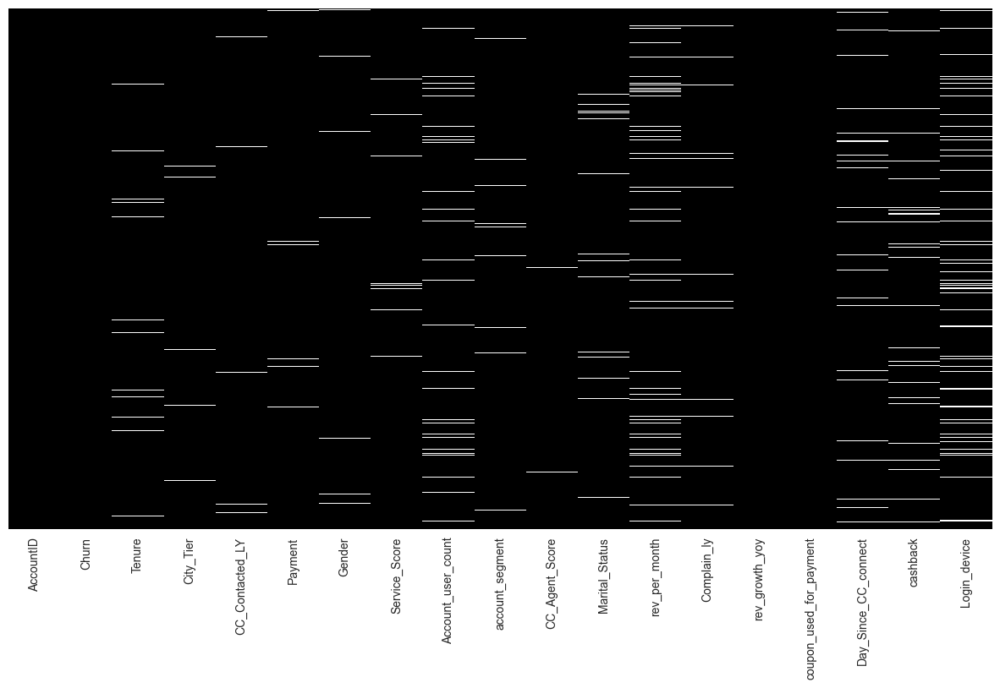

In [36]:
#Plotting missing values across rows & columns
plt.figure(figsize=(15, 8))
plt.rcParams['axes.facecolor'] = 'black'
cmap = sns.color_palette(['black', 'white'])
sns.heatmap(df.isnull(), cbar=False, cmap=cmap,
            yticklabels=False, vmin=0, vmax=1, cbar_kws={'color': 'white'})
plt.show()

# Imputing null values

In [37]:
for column in df:
    print(f"Value counts for column '{column}':")
    print(df[column].unique())
    print()

Value counts for column 'AccountID':
['20000' '20001' '20002' ... '31257' '31258' '31259']

Value counts for column 'Churn':
[1 0]

Value counts for column 'Tenure':
[ 4.  0.  2. 13. 11. nan  9. 99. 19. 20. 14.  8. 26. 18.  5. 30.  7.  1.
 23.  3. 29.  6. 28. 24. 25. 16. 10. 15. 22. 27. 12. 21. 17. 50. 60. 31.
 51. 61.]

Value counts for column 'City_Tier':
['3.0' '1.0' nan '2.0']

Value counts for column 'CC_Contacted_LY':
[  6.   8.  30.  15.  12.  22.  11.   9.  31.  18.  13.  20.  29.  28.
  26.  14.  10.  25.  27.  17.  23.  33.  19.  35.  24.  16.  32.  21.
  nan  34.   5.   4. 126.   7.  36. 127.  42.  38.  37.  39.  40.  41.
 132.  43. 129.]

Value counts for column 'Payment':
['Debit Card' 'UPI' 'Credit Card' 'Cash on Delivery' 'E wallet' nan]

Value counts for column 'Gender':
['Female' 'Male' nan]

Value counts for column 'Service_Score':
['3.0' '2.0' '1.0' nan '0.0' '4.0' '5.0']

Value counts for column 'Account_user_count':
['3.0' '4.0' nan '5.0' '2.0' '1.0' '6.0']

Value 

In [38]:
df_X = df.drop(columns=['Churn','AccountID'], axis = 1)
df_Y = df['Churn']

In [39]:
num_columns = df_X.select_dtypes(include=['number']).columns
cat_columns = df_X.select_dtypes(include = ['object'])

In [40]:
display("Numerical:" , num_columns,  "Categiorical:" , cat_columns.columns)

'Numerical:'

Index(['Tenure', 'CC_Contacted_LY', 'rev_per_month', 'rev_growth_yoy',
       'coupon_used_for_payment', 'Day_Since_CC_connect', 'cashback'],
      dtype='object')

'Categiorical:'

Index(['City_Tier', 'Payment', 'Gender', 'Service_Score', 'Account_user_count',
       'account_segment', 'CC_Agent_Score', 'Marital_Status', 'Complain_ly',
       'Login_device'],
      dtype='object')

# Imputing Categorical Using Mode

In [41]:
#Imputing Categorical Using Mode
for i in cat_columns:
  df_X[i].fillna(df_X[i].mode()[0], inplace = True)

In [42]:
cat_columns = df_X[['City_Tier', 'Payment', 'Gender', 'Service_Score', 'Account_user_count',
               'account_segment', 'CC_Agent_Score', 'Marital_Status', 'Complain_ly',
               'Login_device']]

In [43]:
df_X.isnull().sum()

Tenure                     218
City_Tier                    0
CC_Contacted_LY            102
Payment                      0
Gender                       0
Service_Score                0
Account_user_count           0
account_segment              0
CC_Agent_Score               0
Marital_Status               0
rev_per_month              791
Complain_ly                  0
rev_growth_yoy               3
coupon_used_for_payment      3
Day_Since_CC_connect       358
cashback                   473
Login_device                 0
dtype: int64

# Imputing Numerical Using KNN

In [44]:
#Label encoding for Nominal-categorical colums
from sklearn.preprocessing import LabelEncoder

label_encoders = {}
LE = LabelEncoder()
for i in ['City_Tier', 'CC_Agent_Score', 'Complain_ly','Service_Score','Account_user_count','Payment', 'Gender', 'account_segment','Marital_Status', 'Login_device' ]:
  df_X[i] = LE.fit_transform(df_X[i])
  label_encoders[i] = LE  # Save the label encoder for the columns

In [45]:
df_X.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
0,4.0,2,6.0,2,0,3,2,3,1,2,9.0,1,11.0,1.0,5.0,159.929993,1
1,0.0,0,8.0,4,1,3,3,2,2,2,7.0,1,15.0,0.0,0.0,120.900002,1
2,0.0,0,30.0,2,1,2,3,2,2,2,6.0,1,14.0,0.0,3.0,NaN,1
3,0.0,2,15.0,2,1,2,3,3,4,2,8.0,0,23.0,0.0,3.0,134.070007,1
4,0.0,0,12.0,1,1,2,2,2,4,2,3.0,0,11.0,1.0,3.0,129.600006,1


In [46]:
df_X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11042 non-null  float64
 1   City_Tier                11260 non-null  int32  
 2   CC_Contacted_LY          11158 non-null  float64
 3   Payment                  11260 non-null  int32  
 4   Gender                   11260 non-null  int32  
 5   Service_Score            11260 non-null  int32  
 6   Account_user_count       11260 non-null  int32  
 7   account_segment          11260 non-null  int32  
 8   CC_Agent_Score           11260 non-null  int32  
 9   Marital_Status           11260 non-null  int32  
 10  rev_per_month            10469 non-null  float64
 11  Complain_ly              11260 non-null  int32  
 12  rev_growth_yoy           11257 non-null  float64
 13  coupon_used_for_payment  11257 non-null  float64
 14  Day_Since_CC_connect  

In [47]:
df_Y.info()

<class 'pandas.core.series.Series'>
RangeIndex: 11260 entries, 0 to 11259
Series name: Churn
Non-Null Count  Dtype
--------------  -----
11260 non-null  int64
dtypes: int64(1)
memory usage: 88.1 KB


# Scaling

In [48]:
#Scale the Predictors
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df_X[num_columns] = pd.DataFrame(scaler.fit_transform(df_X[num_columns]), columns=num_columns)

In [49]:
df1 = pd.concat([df_X,df_Y], axis = 1)
df1.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2,-1.340479,2,0,3,2,3,1,2,0.221461,1,-1.382120,-0.401439,0.099207,-0.203224,1,1
1,-0.856038,0,-1.114564,4,1,3,3,2,2,2,0.053522,1,-0.317598,-0.909191,-1.253070,-0.421693,1,1
2,-0.856038,0,1.370505,2,1,2,3,2,2,2,-0.030447,1,-0.583728,-0.909191,-0.441704,NaN,1,1
3,-0.856038,2,-0.323860,2,1,2,3,3,4,2,0.137492,0,1.811447,-0.909191,-0.441704,-0.347974,1,1
4,-0.856038,0,-0.662733,1,1,2,2,2,4,2,-0.282355,0,-1.382120,-0.401439,-0.441704,-0.372995,1,1


In [50]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=5)

In [51]:
df1 = pd.DataFrame(imputer.fit_transform(df1), columns = df1.columns)

In [52]:
df1.isnull().sum()

Tenure                     0
City_Tier                  0
CC_Contacted_LY            0
Payment                    0
Gender                     0
Service_Score              0
Account_user_count         0
account_segment            0
CC_Agent_Score             0
Marital_Status             0
rev_per_month              0
Complain_ly                0
rev_growth_yoy             0
coupon_used_for_payment    0
Day_Since_CC_connect       0
cashback                   0
Login_device               0
Churn                      0
dtype: int64

In [53]:
#Let's check missing values post treatmenr
print('Missing Values in the dataset after treatment :', df1.isnull().sum().sum())

Missing Values in the dataset after treatment : 0


In [54]:
df1.head() #This is out scaled & encoded dataframe for further modeling

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,1.0


In [55]:
#Creating a copy of scaled dataframe df1
df2= df1.copy()

In [56]:
#We will reverse scale the numerical column for Visualization
df2[num_columns] = scaler.inverse_transform(df2[num_columns])

In [57]:
#Storing it in df_temp for Visualization
df_temp = pd.concat([df2[num_columns],cat_columns,df_Y], axis = 1)
df_temp.head()

,Tenure,CC_Contacted_LY,rev_per_month,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,City_Tier,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,Complain_ly,Login_device,Churn
0,4.0,6.0,9.0,11.0,1.0,5.0,159.929993,3.0,Debit Card,Female,3.0,3.0,Super,2.0,Single,1.0,Mobile,1
1,0.0,8.0,7.0,15.0,0.0,0.0,120.900002,1.0,UPI,Male,3.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1
2,0.0,30.0,6.0,14.0,0.0,3.0,128.001999,1.0,Debit Card,Male,2.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1
3,0.0,15.0,8.0,23.0,0.0,3.0,134.070007,3.0,Debit Card,Male,2.0,4.0,Super,5.0,Single,0.0,Mobile,1
4,0.0,12.0,3.0,11.0,1.0,3.0,129.600006,1.0,Credit Card,Male,2.0,3.0,Regular Plus,5.0,Single,0.0,Mobile,1


In [58]:
df_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 18 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11260 non-null  float64
 1   CC_Contacted_LY          11260 non-null  float64
 2   rev_per_month            11260 non-null  float64
 3   rev_growth_yoy           11260 non-null  float64
 4   coupon_used_for_payment  11260 non-null  float64
 5   Day_Since_CC_connect     11260 non-null  float64
 6   cashback                 11260 non-null  float64
 7   City_Tier                11260 non-null  object 
 8   Payment                  11260 non-null  object 
 9   Gender                   11260 non-null  object 
 10  Service_Score            11260 non-null  object 
 11  Account_user_count       11260 non-null  object 
 12  account_segment          11260 non-null  object 
 13  CC_Agent_Score           11260 non-null  object 
 14  Marital_Status        

In [59]:
round(df_temp.describe().T,2)

,count,mean,std,min,25%,50%,75%,max
Tenure,11260.0,11.01,12.81,0.0,2.00,9.00,16.00,99.0
CC_Contacted_LY,11260.0,17.86,8.84,4.0,11.00,16.00,23.00,132.0
rev_per_month,11260.0,6.35,11.57,1.0,3.00,5.00,7.00,140.0
rev_growth_yoy,11260.0,16.19,3.76,4.0,13.00,15.00,19.00,28.0
coupon_used_for_payment,11260.0,1.79,1.97,0.0,1.00,1.00,2.00,16.0
Day_Since_CC_connect,11260.0,4.63,3.68,0.0,2.00,3.00,8.00,47.0
cashback,11260.0,196.10,175.71,0.0,147.18,165.24,200.25,1997.0
Churn,11260.0,0.17,0.37,0.0,0.00,0.00,0.00,1.0


In [60]:
#Categorical COlumns
df_temp.select_dtypes(include = ['object']).describe().T

,count,unique,top,freq
City_Tier,11260,3,1.0,7375
Payment,11260,5,Debit Card,4696
Gender,11260,2,Male,6812
Service_Score,11260,6,3.0,5588
Account_user_count,11260,6,4.0,5013
account_segment,11260,5,Regular Plus,4221
CC_Agent_Score,11260,5,3.0,3476
Marital_Status,11260,3,Married,6072
Complain_ly,11260,2,0.0,8149
Login_device,11260,2,Mobile,8242


# Outlier treatment

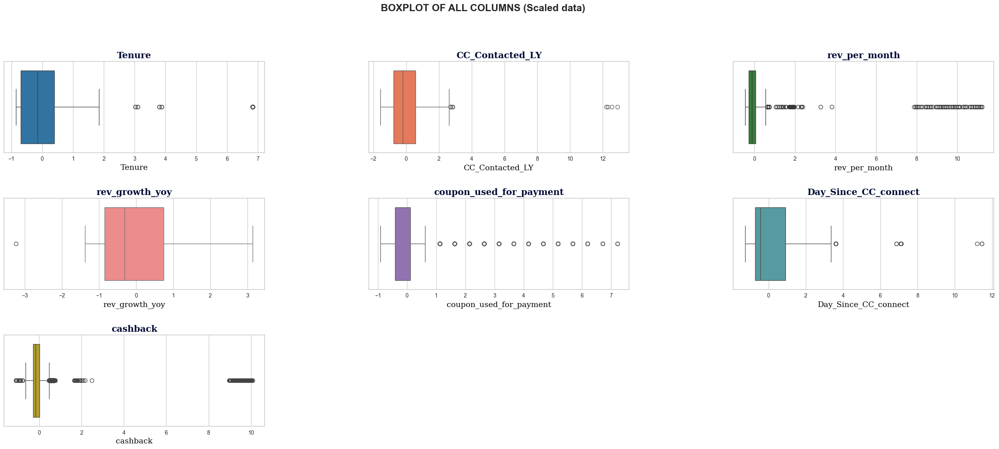

In [61]:
#Outliers in each Columns
plt.rcParams['axes.facecolor'] = 'white'
fig = plt.figure(figsize=[32,24])
fig.suptitle('BOXPLOT OF ALL COLUMNS (Scaled data)', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(num_columns):
    ax1 = fig.add_subplot(6,3, i+1);
    ax1 = sns.boxplot(data = df1, x=col ,  color= colours[i]);
    ax1.set_title(f'{col}', fontdict=axtitle_dict)
    ax1.set_xlabel(f'{col}', fontdict=axlab_dict)

In [62]:
#Checking numbers of observations beyond Upper & Lower Limit
Q1 = df1[num_columns].quantile(0.01)
Q99 = df1[num_columns].quantile(0.99)
UL = Q99
LL = Q1
outliers = ((df1[num_columns] > UL) | (df1[num_columns] < LL)).sum()
print("Number of Outlier Observations Beyond Upper & Lower Limit for Each Column:")
display(outliers)

Number of Outlier Observations Beyond Upper & Lower Limit for Each Column:


Tenure                       0
CC_Contacted_LY             80
rev_per_month              113
rev_growth_yoy              52
coupon_used_for_payment     98
Day_Since_CC_connect        94
cashback                   226
dtype: int64

In [63]:
#Function which returns the Upper and Lower limit to detect outliers for each feature
def treat_outlier(col):
    q1  , q99 = np.percentile(col, [1, 99])
    return q1, q99

for i in num_columns:
    LR, UR  = treat_outlier(df1[i])
    df1[i] = np.where(df1[i] > UR, UR, df1[i])
    df1[i] = np.where(df1[i] < LR, LR, df1[i])

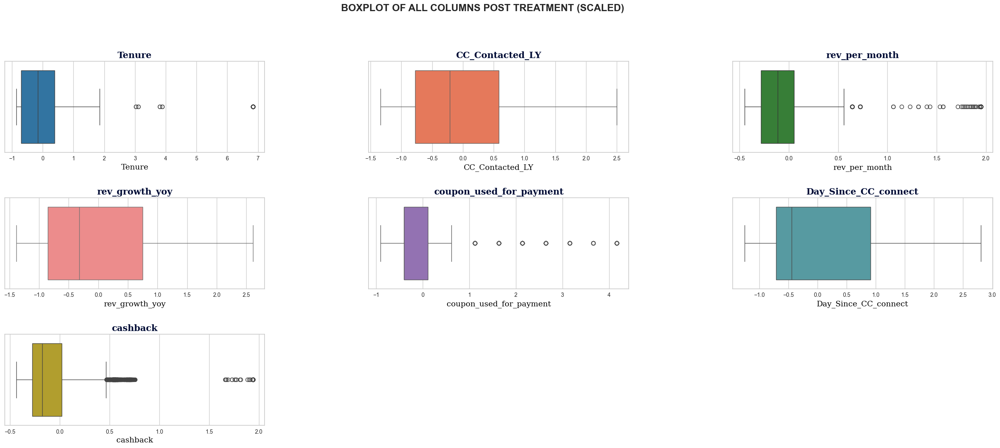

In [64]:
#Outliers in each Columns
plt.rcParams['axes.facecolor'] = 'white'
fig = plt.figure(figsize=[32,24])
fig.suptitle('BOXPLOT OF ALL COLUMNS POST TREATMENT (SCALED)', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92);
fig.subplots_adjust(hspace=0.5, wspace=0.4);
for i ,col in enumerate(num_columns):
    ax1 = fig.add_subplot(6,3, i+1);
    ax1 = sns.boxplot(data = df1, x=col ,  color= colours[i]);
    ax1.set_title(f'{col}', fontdict=axtitle_dict)
    ax1.set_xlabel(f'{col}', fontdict=axlab_dict)

In [65]:
df1

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,-0.079592,0.0,1.822336,1.0,1.0,3.0,1.0,3.0,0.0,1.0,0.221461,0.0,0.746924,-0.401439,-0.171249,-0.238040,0.0,0.0
11256,0.153341,0.0,0.127971,1.0,1.0,3.0,4.0,0.0,4.0,1.0,0.053522,0.0,-0.051467,-0.401439,0.910573,0.171695,1.0,0.0
11257,-0.778394,0.0,-0.436818,2.0,1.0,3.0,1.0,3.0,3.0,1.0,0.053522,1.0,1.545316,-0.401439,-0.171249,-0.026959,1.0,0.0
11258,0.929787,2.0,-0.775691,1.0,1.0,4.0,4.0,3.0,3.0,1.0,0.053522,0.0,-0.051467,0.106314,1.181028,-0.091442,0.0,0.0


# EDA

## univariate

In [66]:
# Distribution of Target Variable
fig = px.pie(
    df_temp.assign(ClassMap=df.Churn.map({0: "Not Churn", 1: "Churn"})),
    names="ClassMap", hole=0.5,
    color_discrete_sequence=["#79a5db", "#e0a580"])
fig.update_layout(
    height=540,width=900,
    title_font_size=18, plot_bgcolor='#ffffff', paper_bgcolor='#ffffff',  showlegend=False,)
fig.add_annotation(
    x=0.5, y=0.5, align="center", xref="paper",
    yref="paper", showarrow=False, font_size=22, text="Target<br>Variable",)
fig.update_traces(
    hovertemplate=None, textposition="outside", texttemplate="%{label}<br>%{value} - %{percent}",
    textfont_size=16,rotation=-20, marker_line_width=25,  marker_line_color='#ffffff',)
fig.show()

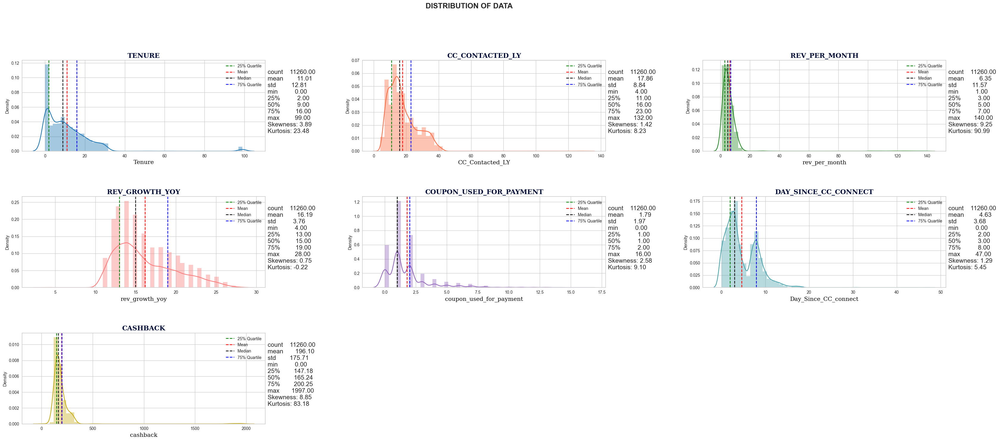

In [67]:
num_columns = df_temp.select_dtypes(include=['float64', 'int64']).columns.drop('Churn')

# Distribution of Numeric Columns
plt.rcParams['axes.facecolor'] = 'white'
fig = plt.figure(figsize=[40, 32])
fig.suptitle('DISTRIBUTION OF DATA', fontsize=18, fontweight='bold')
fig.subplots_adjust(top=0.92)
fig.subplots_adjust(hspace=0.5, wspace=0.4)
for i, col in enumerate(num_columns):
    ax = fig.add_subplot(6, 3, i + 1)
    # Plot the histogram
    sns.distplot(df_temp[col], color=colours[i], ax=ax)
    ax.axvline(df_temp[col].quantile(q=0.25), color='green', linestyle='--', label='25% Quartile')
    ax.axvline(df_temp[col].mean(), color='red', linestyle='--', label='Mean')
    ax.axvline(df_temp[col].median(), color='black', linestyle='--', label='Median')
    ax.axvline(df_temp[col].quantile(q=0.75), color='blue', linestyle='--', label='75% Quartile')
    skewness = round(df_temp[col].skew(), 2)
    kurtosis = round(df_temp[col].kurtosis(), 2)
    description_lines = [line for line in str(df_temp[col].describe().round(2)).split('\n') if 'Name' not in line and 'dtype' not in line]
    description_text = '\n'.join(description_lines)
    description_text += f"\nSkewness: {skewness:.2f}\nKurtosis: {kurtosis:.2f}"
    ax.annotate(description_text, xy=(1.01, 0.2), xycoords='axes fraction', fontsize=15)
    ax.set_xlabel(f'{col}', fontdict=axlab_dict)
    ax.set_title(f'{col.upper()}', fontdict=axtitle_dict)
    ax.legend(fontsize=10)
plt.show()

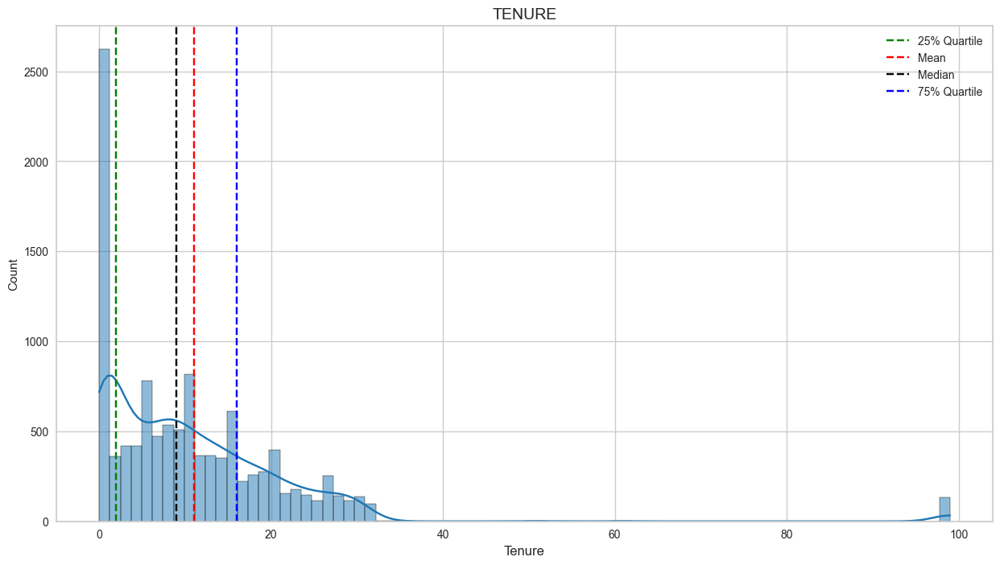

Descriptive Statistics for Tenure:
count    11260.00
mean        11.01
std         12.81
min          0.00
25%          2.00
50%          9.00
75%         16.00
max         99.00
Skewness: 3.89
Kurtosis: 23.48




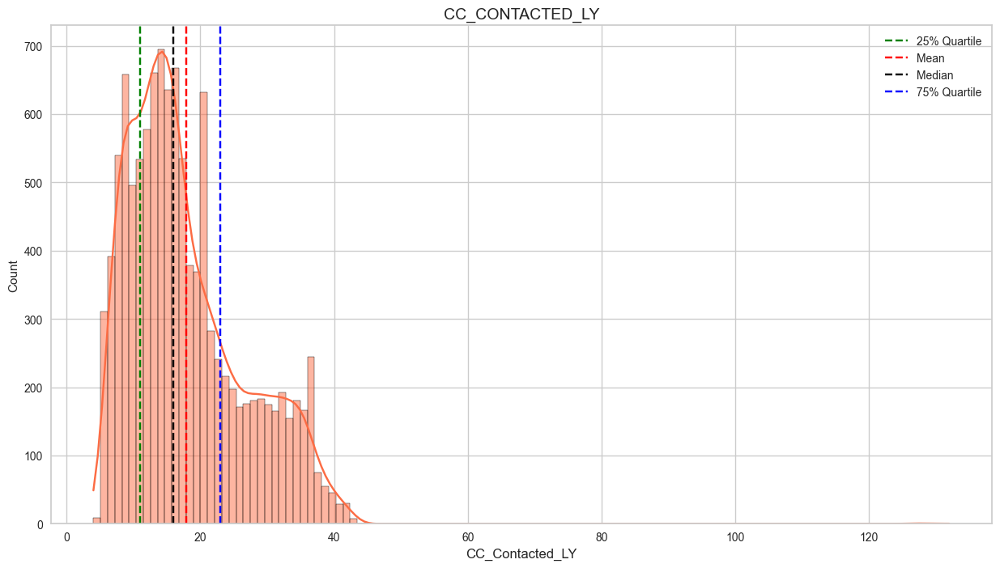

Descriptive Statistics for CC_Contacted_LY:
count    11260.00
mean        17.86
std          8.84
min          4.00
25%         11.00
50%         16.00
75%         23.00
max        132.00
Skewness: 1.42
Kurtosis: 8.23




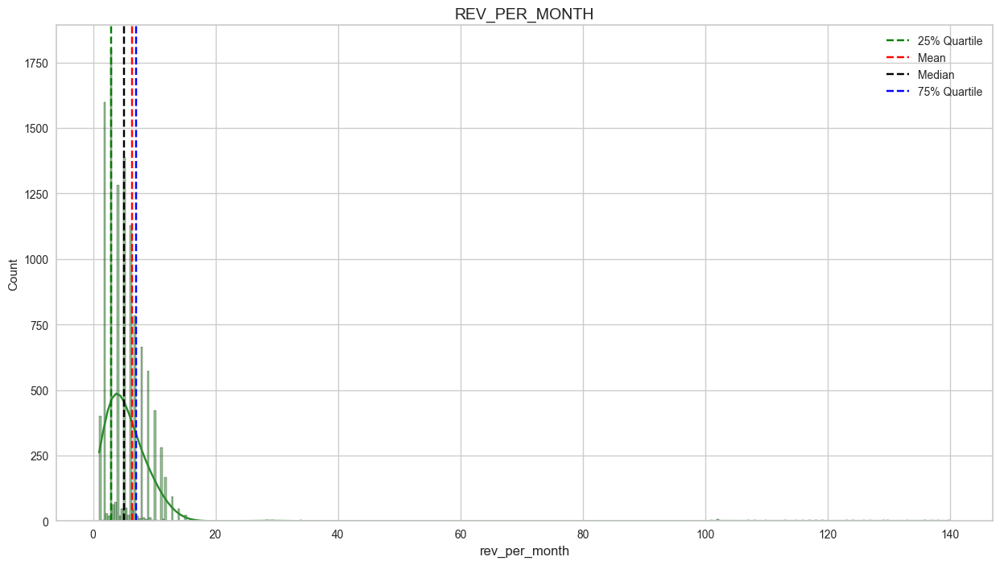

Descriptive Statistics for rev_per_month:
count    11260.00
mean         6.35
std         11.57
min          1.00
25%          3.00
50%          5.00
75%          7.00
max        140.00
Skewness: 9.25
Kurtosis: 90.99




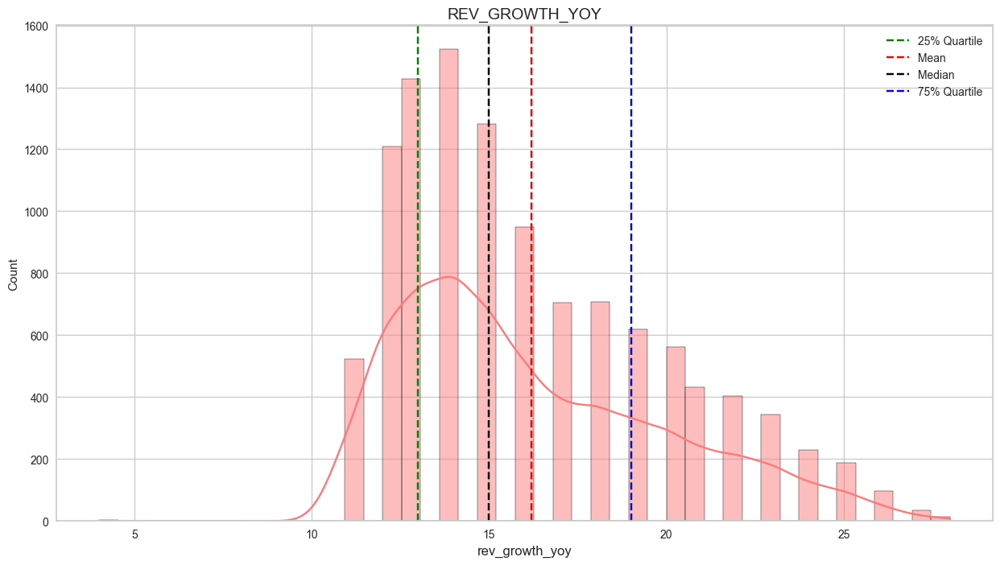

Descriptive Statistics for rev_growth_yoy:
count    11260.00
mean        16.19
std          3.76
min          4.00
25%         13.00
50%         15.00
75%         19.00
max         28.00
Skewness: 0.75
Kurtosis: -0.22




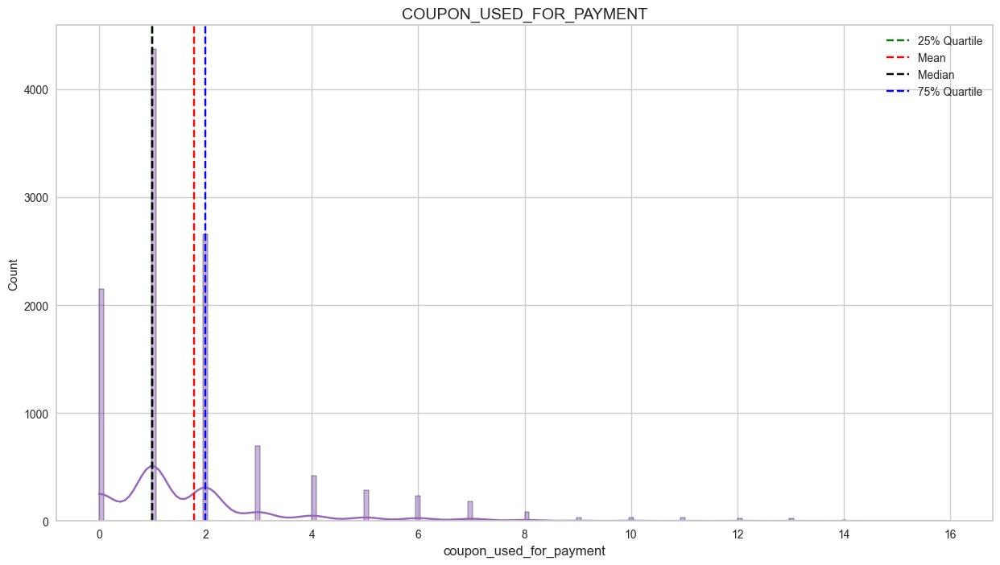

Descriptive Statistics for coupon_used_for_payment:
count    11260.00
mean         1.79
std          1.97
min          0.00
25%          1.00
50%          1.00
75%          2.00
max         16.00
Skewness: 2.58
Kurtosis: 9.10




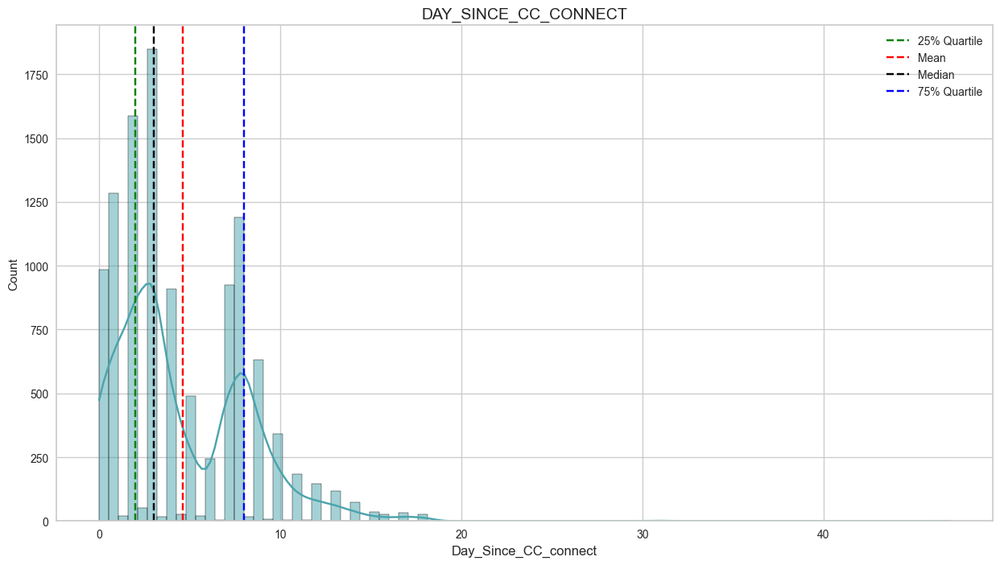

Descriptive Statistics for Day_Since_CC_connect:
count    11260.00
mean         4.63
std          3.68
min          0.00
25%          2.00
50%          3.00
75%          8.00
max         47.00
Skewness: 1.29
Kurtosis: 5.45




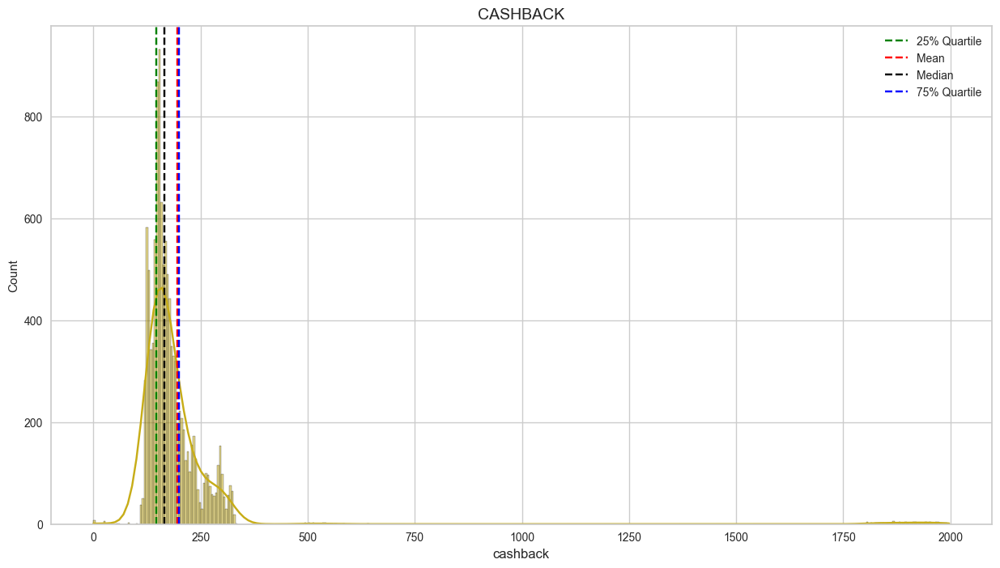

Descriptive Statistics for cashback:
count    11260.00
mean       196.10
std        175.71
min          0.00
25%        147.18
50%        165.24
75%        200.25
max       1997.00
Skewness: 8.85
Kurtosis: 83.18




In [68]:
num_columns = df_temp.select_dtypes(include=['float64', 'int64']).columns.drop('Churn')

# Distribution of Numeric Columns
plt.rcParams['axes.facecolor'] = 'white'

for i, col in enumerate(num_columns):
    # Plot the histogram
    plt.figure(figsize=(15, 8))
    sns.histplot(df_temp[col], kde=True, color=colours[i])
    plt.axvline(df_temp[col].quantile(q=0.25), color='green', linestyle='--', label='25% Quartile')
    plt.axvline(df_temp[col].mean(), color='red', linestyle='--', label='Mean')
    plt.axvline(df_temp[col].median(), color='black', linestyle='--', label='Median')
    plt.axvline(df_temp[col].quantile(q=0.75), color='blue', linestyle='--', label='75% Quartile')

    skewness = round(df_temp[col].skew(), 2)
    kurtosis = round(df_temp[col].kurtosis(), 2)

    description_lines = [line for line in str(df_temp[col].describe().round(2)).split('\n') if 'Name' not in line and 'dtype' not in line]
    description_text = '\n'.join(description_lines)
    description_text += f"\nSkewness: {skewness:.2f}\nKurtosis: {kurtosis:.2f}"

    plt.xlabel(f'{col}', fontsize=12)
    plt.title(f'{col.upper()}', fontsize=14)
    plt.legend(fontsize=10)
    plt.show()

    # Print descriptive statistics
    print(f"Descriptive Statistics for {col}:")
    print(description_text)
    print("\n" + "="*50 + "\n")

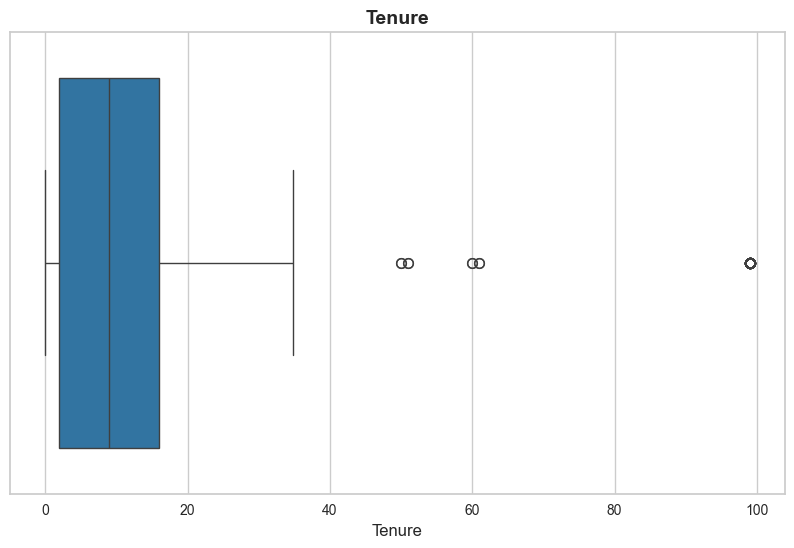

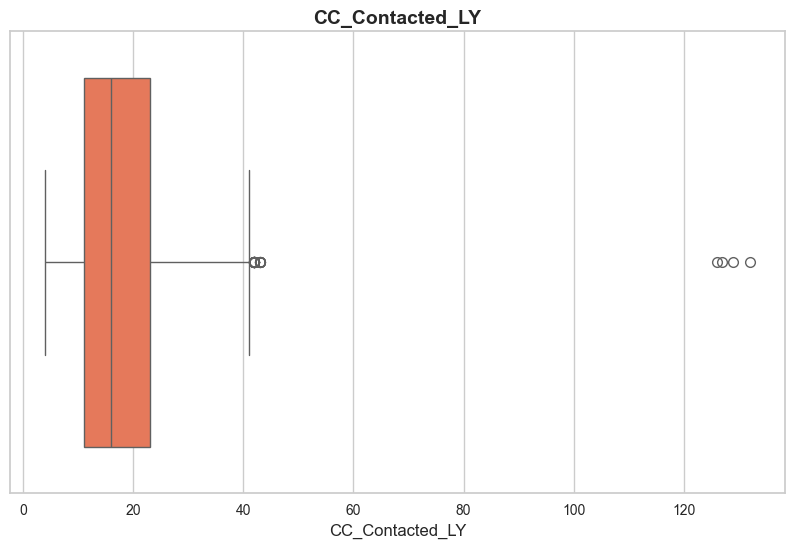

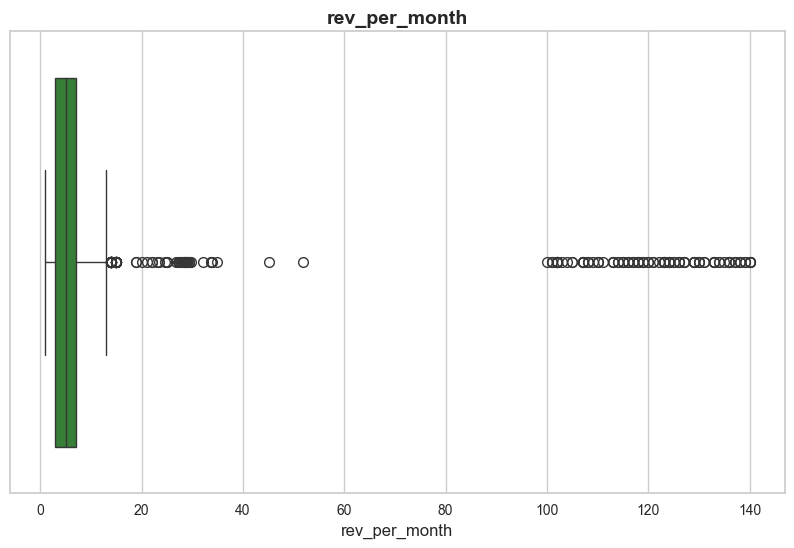

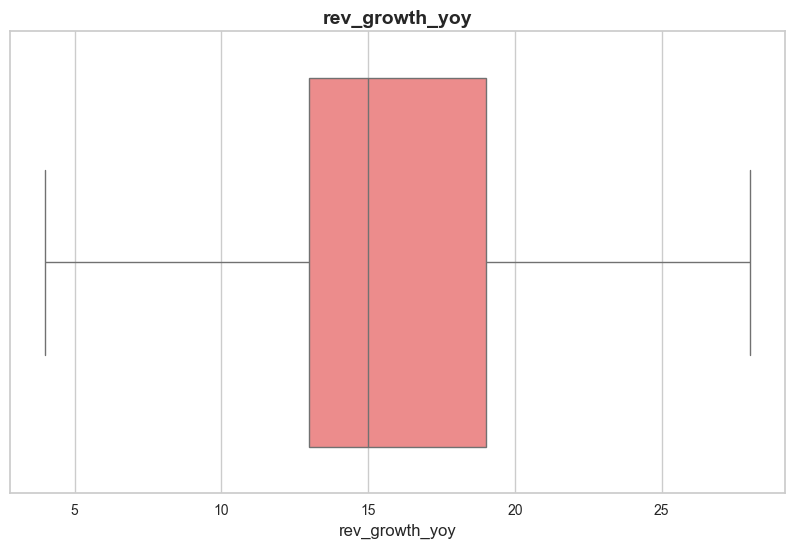

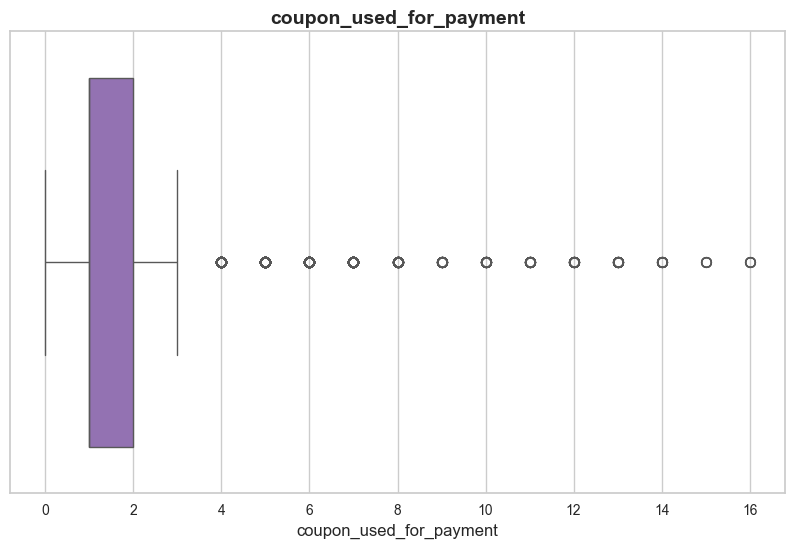

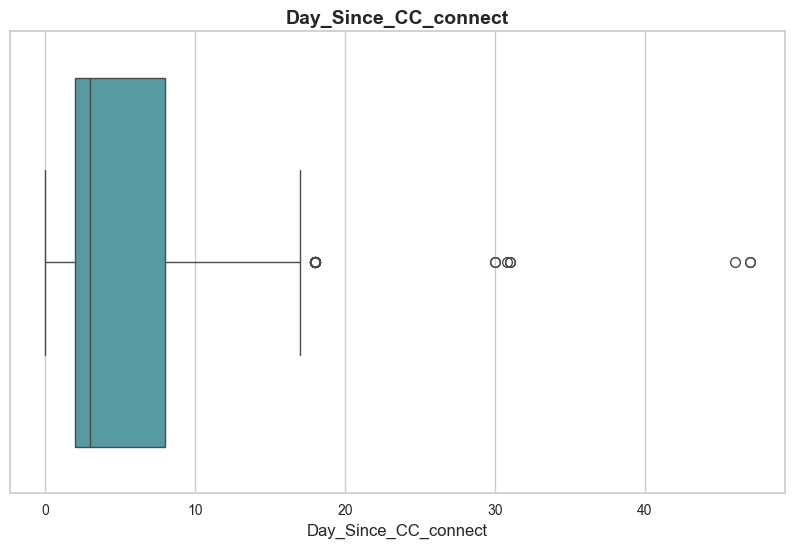

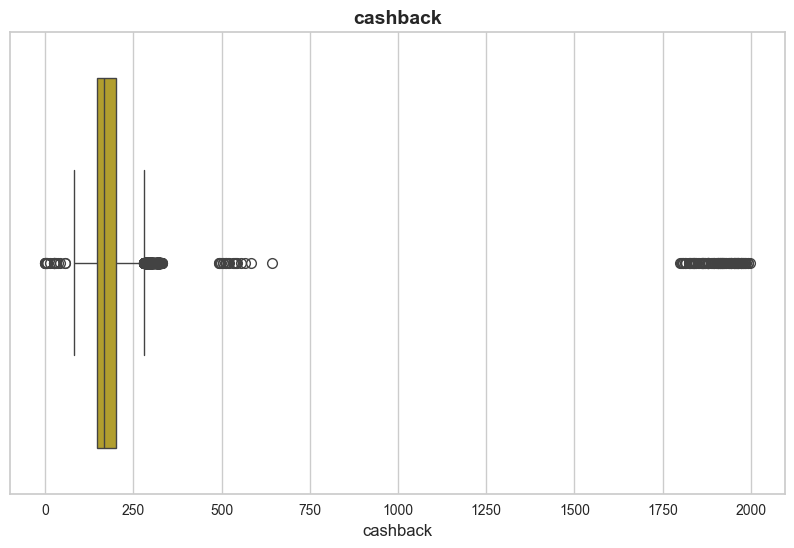

In [69]:
axtitle_dict = {'fontsize': 14, 'fontweight': 'bold'}
axlab_dict = {'fontsize': 12}

for i, col in enumerate(num_columns):
    plt.figure(figsize=[10, 6])
    ax = sns.boxplot(data=df_temp, x=col, color=colours[i])
    ax.set_title(f'{col}', fontdict=axtitle_dict)
    ax.set_xlabel(f'{col}', fontdict=axlab_dict)
    plt.show()

**Key Pointers from Univeariate Analysis**

---
---
1. **Tenure**:
   - The tenure values have a wide range from 0 to 99 months, indicating variability in customer loyalty.
   - The distribution is positively skewed (skewness 3.90), suggesting that more customers have shorter tenure.
   - There are significant outliers on the higher end (kurtosis 23.37), which might represent long-term loyal customers or data anomalies.

2. **CC_Contacted_LY**:
   - The number of CC contacts in the last year ranges from 4 to 132, indicating variation in customer interactions.
   - The distribution is moderately positively skewed (skewness 1.42), suggesting that most customers had relatively fewer contacts.
   - There are some outliers with a higher number of contacts (kurtosis 8.23), indicating potential high engagement customers or data anomalies.

3. **rev_per_month**:
   - Monthly revenue varies significantly, with values ranging from 1 to 140.
   - The distribution is highly positively skewed (skewness 9.09), indicating that most customers generate lower revenue.
   - There are many extreme outliers (kurtosis 86.96), potentially representing high-revenue customers or data anomalies.

4. **rev_growth_yoy**:
   - Year-over-year revenue growth percentages range from 4% to 28%.
   - The distribution is moderately positively skewed (skewness 0.75), suggesting steady growth rates.
   - The kurtosis value is close to zero (kurtosis -0.22), indicating a distribution with lighter tails and fewer outliers.

5. **coupon_used_for_payment**:
   - Most customers use 1 to 2 coupons for payments, with a range of 0 to 16.
   - The distribution is positively skewed (skewness 2.58), indicating that a significant portion of customers uses coupons for payment.
   - The kurtosis value is relatively high (kurtosis 9.10), suggesting a distribution with some outliers related to coupon usage.

6. **Day_Since_CC_connect**:
   - The number of days since the last customer care connect spans from 0 to 47 days.
   - The distribution is positively skewed (skewness 1.27), indicating that most customers recently connected contact center.
   - The kurtosis value is 5.33, suggesting a distribution with some customers having longer periods since the last connect.

7. **cashback**:
   - Cashback values vary widely from 0 to 1997.
   - The distribution is highly positively skewed (skewness 8.77), indicating that most customers receive lower cashback amounts.
   - There are numerous extreme outliers (kurtosis 81.11), which could represent customers with exceptionally high cashback or anomalies in the data.

# categorical columns

In [70]:
cat_colums = df_temp.select_dtypes(include = ['object'])

In [71]:
import plotly.express as px

config = {
    'toImageButtonOptions': {
        'format': 'svg',  # one of png, svg, jpeg, webp
        'filename': 'custom_image',
        'height': 500,
        'width': 700,
        'scale': 1  # Multiply title/legend/axis/canvas sizes by this factor
    }
}

def univariateAnalysis_category(cols):
    print('__' * 41)
    colors = ['#79a5db', '#e0a580', '#6fab90', '#896ca8', '#ADD8E6']
    value_counts = df_temp[cols].value_counts().reset_index()
    value_counts.columns = [cols, 'count']  # Rename columns for compatibility with px.bar

    # Bar plot
    fig = px.bar(
        value_counts, x=cols,
        y='count', title=f'Distribution of {cols}', labels={'count': "Count"}, color_discrete_sequence=[colors])
    fig.update_traces(text=value_counts['count'], textposition='outside')

    # Adjust y-axis range to ensure highest bar is fully visible
    y_max = value_counts['count'].max()
    fig.update_layout(
        yaxis=dict(range=[0, y_max * 1.1]),  # Add 10% headroom above the highest bar
        width=1000, height=500,
        plot_bgcolor='#fcfaf7',
        paper_bgcolor='#fcfaf7'
    )
    fig.update_xaxes(title_text=cols)
    fig.show(config=config)

    # Donut chart
    percentage = (value_counts['count'] / value_counts['count'].sum()) * 100
    fig = px.pie(
        values=percentage, names=value_counts[cols],
        labels={'names': 'Categories', 'values': 'Percentage'}, hole=0.5, color_discrete_sequence=colors)
    fig.add_annotation(x=0.5, y=0.5, align="center", xref="paper",
                       yref="paper", showarrow=False, font_size=18, text=f'{cols}')
    fig.update_layout(legend=dict(x=0.9, y=0.5))
    fig.update_layout(width=1000, height=500)
    fig.update_layout(plot_bgcolor='#fcfaf7', paper_bgcolor='#fcfaf7')
    fig.show(config=config)

for x in cat_columns:
    univariateAnalysis_category(x)

__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


In [72]:
def univariateAnalysis_category(cols):
    print('__' * 41)
    print(f"Univariate Analysis for {cols}:\n")
    colors = ['#79a5db', '#e0a580', '#6fab90', '#896ca8', '#ADD8E6']
    value_counts = df_temp[cols].value_counts().reset_index()
    value_counts.columns = [cols, 'count']  # Rename columns for compatibility with px.bar

    # Print the value counts
    print(f"Value Counts for {cols}:\n")
    print(value_counts.to_string(index=False))
    print()

    # Calculate and print percentages
    percentage = (value_counts['count'] / value_counts['count'].sum()) * 100
    percentage_df = pd.DataFrame({cols: value_counts[cols], 'percentage': percentage})
    print(f"Percentage Distribution for {cols}:\n")
    print(percentage_df.to_string(index=False))
    print()

    # Descriptive statistics
    desc_stats = df_temp[cols].describe()
    print(f"Descriptive Statistics for {cols}:\n")
    print(desc_stats.to_string())
    print()

for x in cat_columns:
    univariateAnalysis_category(x)

__________________________________________________________________________________
Univariate Analysis for City_Tier:

Value Counts for City_Tier:

City_Tier  count
      1.0   7375
      3.0   3405
      2.0    480

Percentage Distribution for City_Tier:

City_Tier  percentage
      1.0   65.497336
      3.0   30.239787
      2.0    4.262877

Descriptive Statistics for City_Tier:

count     11260
unique        3
top         1.0
freq       7375

__________________________________________________________________________________
Univariate Analysis for Payment:

Value Counts for Payment:

         Payment  count
      Debit Card   4696
     Credit Card   3511
        E wallet   1217
Cash on Delivery   1014
             UPI    822

Percentage Distribution for Payment:

         Payment  percentage
      Debit Card   41.705151
     Credit Card   31.181172
        E wallet   10.808171
Cash on Delivery    9.005329
             UPI    7.300178

Descriptive Statistics for Payment:

count      

**Key inferences:**

---
---

- Approximately 65.50% of customers are in City Tier 1 while around 30.24% of customers are in City Tier 3.
- The data suggests that most customers prefer "Debit Card"(41.71%) and "Credit Card"(31.18%) as payment method
- 60.50% of customers are male(Majority)
-  A significant portion of customers have "Service_Score" of 3.0 (49.63%)suggesting relatively neutral score.
- "Regular Plus" and "Super" are the most common account segments, making up 37.49% and 36.07% of the customer base, respectively.
- 38.35% customers having score 4 & 5 suggesting a ratio of Satisfied users while 30.78% havings core 1& 2 suggesting a high dissatisfaction.
- Account_user_count: Most customers have 3 to 4 account users, with a range of 1 to 6 users.
- Most customers (72.37%) did not file any complaints in the last year which indicates a good sign of less customers facing issues.
- A large portion of customers use mobile devices(73.20%) for login.


# Bivariate Analysis

In [73]:
config = {
    'toImageButtonOptions': {
        'format': 'svg',  # one of png, svg, jpeg, webp
        'filename': 'custom_image',
        'height': 500,
        'width': 700,
        'scale': 1  # Multiply title/legend/axis/canvas sizes by this factor
    }
}

color_map = {'Not Churn': '#79a5db', 'Churn': '#e0a580'}
print('Bivariate Analysis : Distribution of Columns with Churn ')

for column in cat_columns:
    print('__' * 41)

    # Prepare the data for the bar chart
    bar_data = df_temp.groupby([column, 'Churn']).size().reset_index(name='count')
    bar_data['Churn'] = bar_data['Churn'].map({0: 'Not Churn', 1: 'Churn'})

    # Create the bar chart
    fig_bar = px.bar(bar_data, x=column, y='count', color='Churn', title=f'Distribution of {column} on customer churn ',
                     color_discrete_map=color_map, text='count', labels={'count': 'Count'})
    fig_bar.update_layout(width=1000, height=500)
    fig_bar.update_layout(plot_bgcolor='#fcfaf7', paper_bgcolor='#fcfaf7')
    fig_bar.update_traces(textposition='outside')
    fig_bar.update_yaxes(range=[0, bar_data['count'].max() * 1.5])  # Adjust y-axis range
    fig_bar.show(config=config)

    # Sunburst chart
    sunburst_data = df_temp.groupby([column, 'Churn']).size().reset_index(name='count')
    sunburst_data['Churn'] = sunburst_data['Churn'].map({0: 'Not Churn', 1: 'Churn'})
    fig_sunburst = px.sunburst(sunburst_data, path=[column, 'Churn'], values='count', color='Churn',
                               color_discrete_map=color_map)
    fig_sunburst.update_layout(width=1000, height=500)
    fig_sunburst.update_layout(plot_bgcolor='#fcfaf7', paper_bgcolor='#fcfaf7')
    fig_sunburst.update_traces(textinfo='label + percent parent')
    fig_sunburst.show(config=config)

Bivariate Analysis : Distribution of Columns with Churn 
__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


__________________________________________________________________________________


In [74]:
color_map = {'Not Churn': '#79a5db', 'Churn': '#e0a580'}
print('Bivariate Analysis : Distribution of Columns with Churn ')

for column in cat_columns:
    print('__' * 41)

    # Print title
    print(f"Distribution of {column} on customer churn")

    # Prepare the data for the bar chart
    bar_data = df_temp.groupby([column, 'Churn']).size().reset_index(name='count')
    bar_data['Churn'] = bar_data['Churn'].map({0: 'Not Churn', 1: 'Churn'})

    # Calculate percentage of each category within each group for bar chart
    bar_data['percentage'] = bar_data.groupby(column)['count'].transform(lambda x: x / x.sum() * 100)

    # Print bar chart data
    print("Bar Chart Data:")
    print(bar_data)

    # Print a separator
    print('=' * 100)

    # # Print title for sunburst chart
    # print(f"Sunburst chart for {column}")

    # # Prepare the data for the sunburst chart
    # sunburst_data = df_temp.groupby([column, 'Churn']).size().reset_index(name='count')
    # sunburst_data['Churn'] = sunburst_data['Churn'].map({0: 'Not Churn', 1: 'Churn'})

    # # Calculate percentage of each category within each group for sunburst chart
    # sunburst_data['percentage'] = sunburst_data.groupby(column)['count'].transform(lambda x: x / x.sum() * 100)

    # # Print sunburst chart data with percentage
    # print("Sunburst Chart Data:")
    # print(sunburst_data)

    # # Print a separator
    # print('=' * 100)

Bivariate Analysis : Distribution of Columns with Churn 
__________________________________________________________________________________
Distribution of City_Tier on customer churn
Bar Chart Data:
  City_Tier      Churn  count  percentage
0       1.0  Not Churn   6302   85.450847
1       1.0      Churn   1073   14.549153
2       2.0  Not Churn    384   80.000000
3       2.0      Churn     96   20.000000
4       3.0  Not Churn   2678   78.649046
5       3.0      Churn    727   21.350954
__________________________________________________________________________________
Distribution of Payment on customer churn
Bar Chart Data:
            Payment      Churn  count  percentage
0  Cash on Delivery  Not Churn    760   74.950690
1  Cash on Delivery      Churn    254   25.049310
2       Credit Card  Not Churn   3012   85.787525
3       Credit Card      Churn    499   14.212475
4        Debit Card  Not Churn   3972   84.582624
5        Debit Card      Churn    724   15.417376
6          E wa

**Key Inferences**

---
---

- Payment method, City_Tier, and account segment seem to be strong indicators of customer churn.
- Customers who use 'Cash on Delivery' and belong to City_Tier 1.0 have the highest churn rates.
- 'Regular Plus' account segment and 'CC_Agent_Score' of 5.0 are associated with higher churn.
- Gender, marital status, and login device appear to have a relatively lower impact on customer churn, but there are still variations.
- It's essential to focus on improving the customer experience for the high-churn-rate segments and tailor retention strategies accordingly.

**Let's check in Each Variable**

**City_Tier:**
- City_Tier 1.0 has the highest percentage of churn (14.55%) followed by City_Tier 3.0 (21.35%).
- City_Tier 2.0 has the lowest churn at 20.00%.

**Payment:**
- Customers who use 'Cash on Delivery' as their payment method have the highest churn rate (25.05%).
- 'Credit Card' and 'Debit Card' users have lower churn rates compared to 'Cash on Delivery' users.
- 'E wallet' and 'UPI' users have relatively lower churn rates.

**Gender:**
- Churn is slightly higher among 'Male' customers (17.72%) compared to 'Female' customers (15.49%).

**Account Segment:**
- 'Regular Plus' account segment has the highest churn rate (27.13%).
- 'Regular' and 'Super' segments have the lowest churn rates.
- 'Super Plus' and 'HNI' segments also have relatively low churn rates.

**CC_Agent_Score:**
- Customers with 'CC_Agent_Score' of 5.0 have the highest churn rate (23.82%).
- 'CC_Agent_Score' of 1.0 and 2.0 have the lowest churn rates (11.47% and 12.63% respectively).
- As 'CC_Agent_Score' decreases, the churn rate increases.

**Marital Status:**
- Customers with 'Single' marital status have the highest churn rate (26.90%).
- 'Married' customers have a lower churn rate (11.61%).
- 'Divorced' customers have a moderate churn rate (14.63%).

**Complain_ly:**
- Customers who have complained in the last year ('Complain_ly' = 1.0) have a significantly higher churn rate (31.76%).
- Customers who did not complain ('Complain_ly' = 0.0) have a lower churn rate (11.14%).

**Login Device:**
- Customers who use 'Computer' as their login device have a higher churn rate (19.78%).
- Customers who use 'Mobile' devices have a relatively lower churn rate (15.76%).


Bivariate Analysis : Distribution of Columns with Churn 


<Figure size 800x550 with 0 Axes>

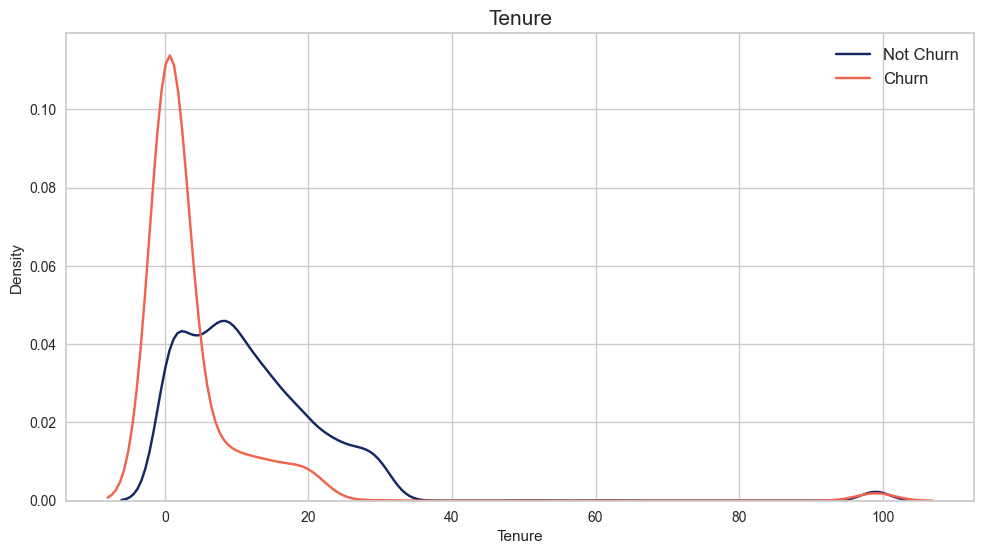

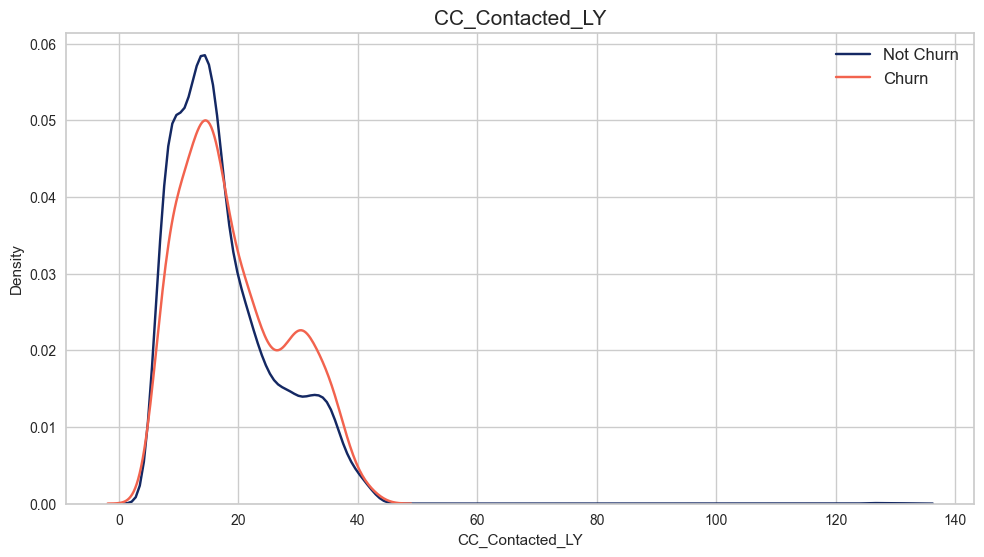

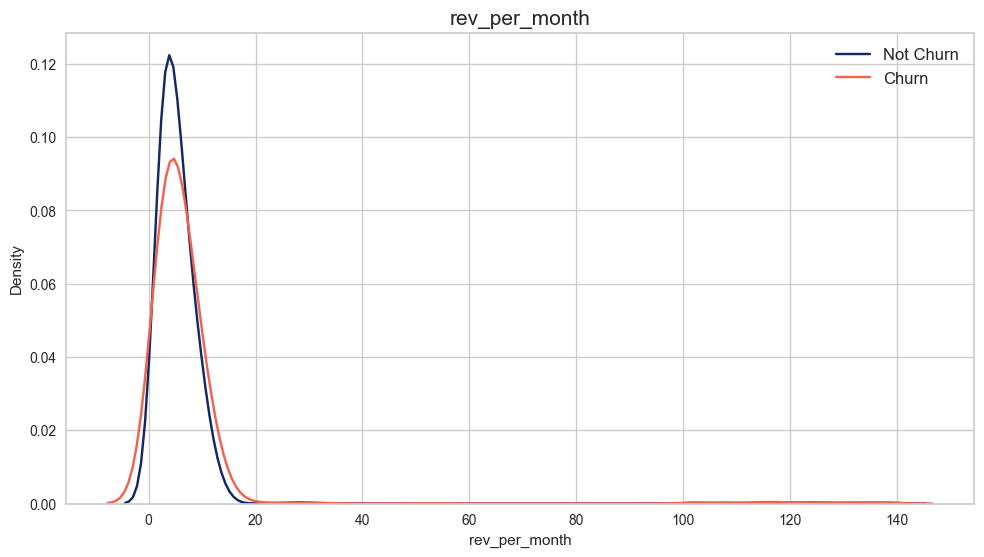

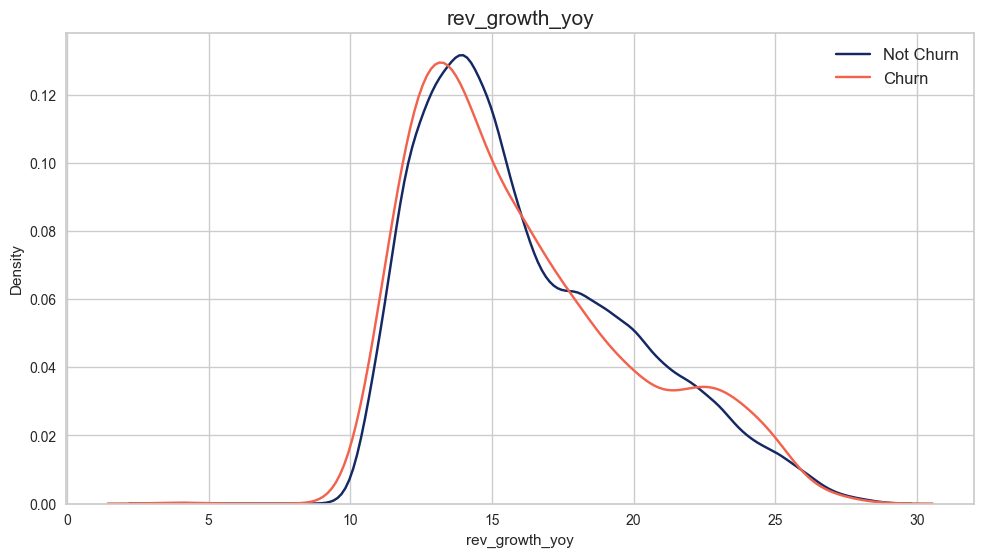

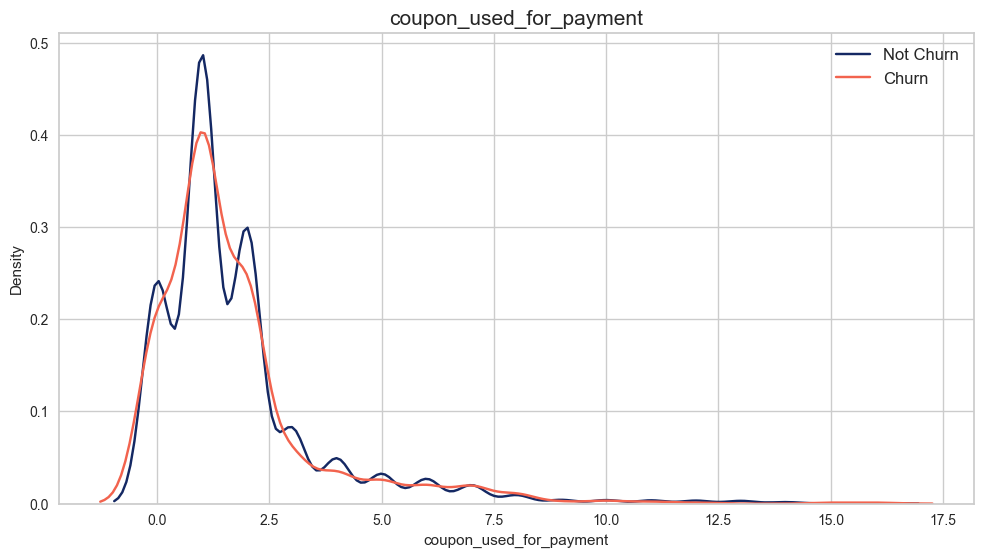

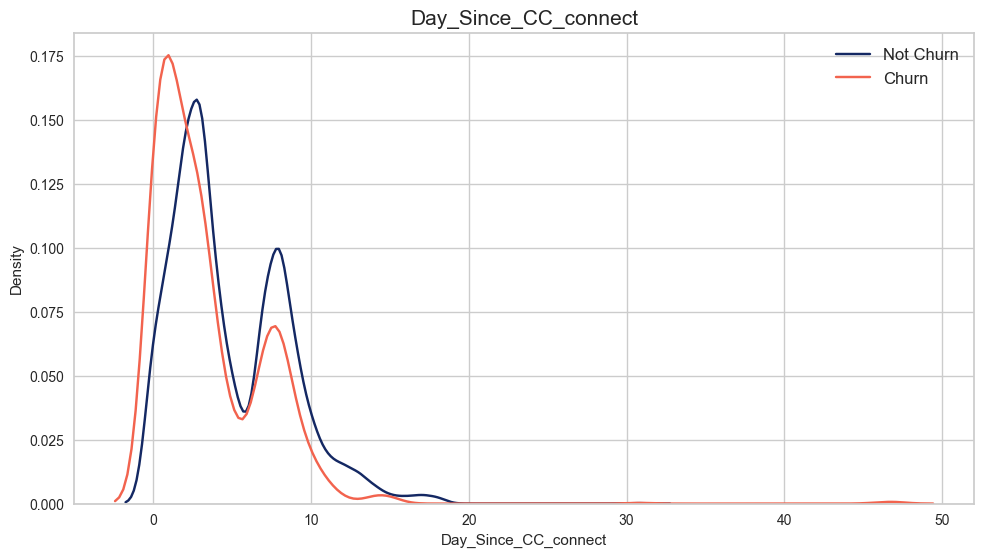

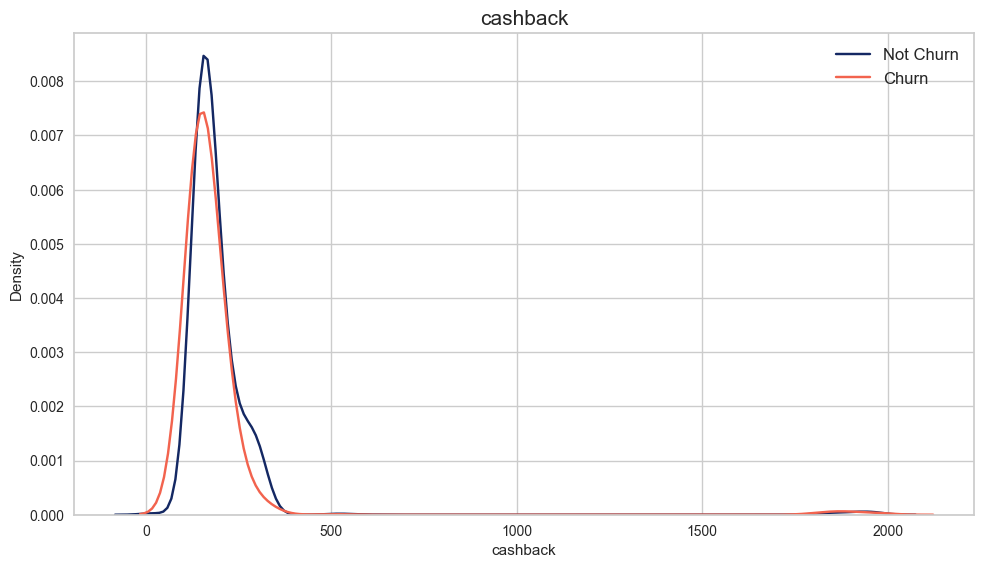

In [75]:
print('Bivariate Analysis : Distribution of Columns with Churn ')

# Adjust spacing between subplots
plt.subplots_adjust(top=0.92, hspace=0.5)

for i, col in enumerate(num_columns):
    plt.figure(figsize=[10, 37])  # Set figure size before creating each subplot
    plt.subplot(len(num_columns), 1, i+1)  # Create subplot
    sns.distplot(df_temp[df_temp['Churn'] == 0][col], color='#142863', hist=False, label='Not Churn')
    sns.distplot(df_temp[df_temp['Churn'] == 1][col], color='#f2634e', hist=False, label='Churn')
    plt.title(col, fontdict={'fontsize': 15})  # Set subplot title
    plt.legend(fontsize=12)  # Add legend

    # Add some space between subplots
    plt.tight_layout()

    # Display the plot
    plt.show()

In [76]:
print('Bivariate Analysis : Distribution of Columns with Churn ')

for col in num_columns:
    print('__' * 41)
    print(f"Column: {col}")

    # Calculate statistics for Not Churn
    not_churn_stats = df_temp[df_temp['Churn'] == 0][col].describe()
    print("Not Churn Statistics:")
    print(not_churn_stats)

    # Calculate statistics for Churn
    churn_stats = df_temp[df_temp['Churn'] == 1][col].describe()
    print("\nChurn Statistics:")
    print(churn_stats)

    print('\n')

Bivariate Analysis : Distribution of Columns with Churn 
__________________________________________________________________________________
Column: Tenure
Not Churn Statistics:
count    9364.000000
mean       12.352584
std        12.545700
min         0.000000
25%         5.000000
50%        10.000000
75%        17.000000
max        99.000000
Name: Tenure, dtype: float64

Churn Statistics:
count    1896.000000
mean        4.366878
std        11.993463
min         0.000000
25%         0.000000
50%         1.000000
75%         3.000000
max        99.000000
Name: Tenure, dtype: float64


__________________________________________________________________________________
Column: CC_Contacted_LY
Not Churn Statistics:
count    9364.000000
mean       17.568240
std         8.797233
min         5.000000
25%        11.000000
50%        15.000000
75%        22.000000
max       132.000000
Name: CC_Contacted_LY, dtype: float64

Churn Statistics:
count    1896.000000
mean       19.287447
std         

In [77]:
config = {
    'toImageButtonOptions': {
        'format': 'svg',  # one of png, svg, jpeg, webp
        'filename': 'custom_image',
        'height': 500,
        'width': 700,
        'scale': 1  # Multiply title/legend/axis/canvas sizes by this factor
    }
}

def plot_hist(df_temp, feature):
    print('__' * 60)
    color_map = {0: '#79a5db', 1: '#f2634e'}
    fig = px.histogram(df_temp, x=feature, color="Churn", marginal="box",
                       barmode ="overlay", color_discrete_map=color_map, histnorm ='density')
    fig.update_layout(title_font_color="black", legend_title_font_color="black",
        title={ 'text': feature+" histogram",'x':0.5,
            'xanchor': 'center','yanchor': 'top'},
        paper_bgcolor="#fcfaf7",
        plot_bgcolor='#fcfaf7',
        font_color="black")
    fig.update_layout(height=700, width=1000)
    fig.show(config=config)
for col in num_columns:
  plot_hist(df, col)

________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


In [78]:
from scipy.stats import gaussian_kde
config = {
    'toImageButtonOptions': {
        'format': 'svg',  # one of png, svg, jpeg, webp
        'filename': 'custom_image',
        'height': 500,
        'width': 700,
        'scale': 1  # Multiply title/legend/axis/canvas sizes by this factor
    }
}

def plot_hist(df_temp, feature):
    print('__' * 60)
    color_map = {0: '#79a5db', 1: '#f2634e'}

    # Create the histogram
    fig = px.histogram(df_temp, x=feature, color="Churn", marginal="box",
                       barmode="overlay", color_discrete_map=color_map, histnorm='probability density')

    # Add KDE line
    for churn_value in df_temp["Churn"].unique():
        subset = df_temp[df_temp["Churn"] == churn_value][feature].dropna()
        kde = gaussian_kde(subset)
        x_range = np.linspace(subset.min(), subset.max(), 1000)
        kde_values = kde(x_range)
        kde_line = go.Scatter(x=x_range, y=kde_values, mode='lines',
                              line=dict(color=color_map[churn_value], width=2),
                              name=f'KDE - Churn {churn_value}')
        fig.add_trace(kde_line)

    fig.update_layout(
        title_font_color="black",
        legend_title_font_color="black",
        title={
            'text': feature + " histogram",
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        paper_bgcolor="#fcfaf7",
        plot_bgcolor='#fcfaf7',
        font_color="black",
        height=700,
        width=1000
    )
    fig.show(config=config)

for col in num_columns:
    plot_hist(df_temp, col)


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


________________________________________________________________________________________________________________________


In [79]:
def plot_hist(df_temp, feature):
    print('__' * 60)
    print(f"Feature: {feature} Histogram")

    # Calculate statistics for Not Churn
    not_churn_data = df_temp[df_temp['Churn'] == 0][feature]
    not_churn_stats = not_churn_data.describe()

    # Calculate statistics for Churn
    churn_data = df_temp[df_temp['Churn'] == 1][feature]
    churn_stats = churn_data.describe()

    # Print statistics
    print("Not Churn Statistics:")
    print(not_churn_stats)
    print("\nChurn Statistics:")
    print(churn_stats)
    print('\n')

# Loop through each numeric column to generate histograms and print statistics
for col in num_columns:
    plot_hist(df_temp, col)

________________________________________________________________________________________________________________________
Feature: Tenure Histogram
Not Churn Statistics:
count    9364.000000
mean       12.352584
std        12.545700
min         0.000000
25%         5.000000
50%        10.000000
75%        17.000000
max        99.000000
Name: Tenure, dtype: float64

Churn Statistics:
count    1896.000000
mean        4.366878
std        11.993463
min         0.000000
25%         0.000000
50%         1.000000
75%         3.000000
max        99.000000
Name: Tenure, dtype: float64


________________________________________________________________________________________________________________________
Feature: CC_Contacted_LY Histogram
Not Churn Statistics:
count    9364.000000
mean       17.568240
std         8.797233
min         5.000000
25%        11.000000
50%        15.000000
75%        22.000000
max       132.000000
Name: CC_Contacted_LY, dtype: float64

Churn Statistics:
count    1896

**Key Inferences**

---
---

- Tenure and customer contact with customer care (CC_Contacted_LY) have a significant impact on churn. Customers with longer tenure and more contact with customer care are less likely to churn.
- Account user count, monthly revenue, and year-over-year revenue growth also influence churn. Fewer account users, lower monthly revenue, and lower revenue growth are associated with higher churn.
- The use of coupons for payment and the time since the last contact with customer care are additional factors affecting churn.
- Cashback also plays a role, with higher cashback amounts associated with lower churn.


**Let's check for each variable**

**Tenure:**
- Customers with lower tenure (recent customers) have a higher churn rate.
- Customers with longer tenure (loyal customers) have a lower churn rate.

**CC_Contacted_LY:**
- Customers with lower CC_Contacted_LY (less contact with customer care last year) have a higher churn rate.
- Customers with higher CC_Contacted_LY (more contact with customer care last year) have a lower churn rate.

**Account_user_count:**
- Customers with fewer account users tend to have a higher churn rate.
- Customers with more account users have a lower churn rate.

**rev_per_month:**
- Customers with lower monthly revenue tend to have a higher churn rate.
- Customers with higher monthly revenue have a lower churn rate.

**rev_growth_yoy:**
- Customers with lower year-over-year revenue growth tend to have a higher churn rate.
- Customers with higher year-over-year revenue growth have a lower churn rate.

**coupon_used_for_payment:**
- Customers who use fewer coupons for payment tend to have a higher churn rate.
- Customers who use more coupons for payment have a lower churn rate.

**Day_Since_CC_connect:**
- Customers with a shorter time since the last contact with customer care tend to have a higher churn rate.
- Customers with a longer time since the last contact with customer care have a lower churn rate.

**cashback:**
- Customers with lower cashback amounts tend to have a higher churn rate.
- Customers with higher cashback amounts have a lower churn rate.


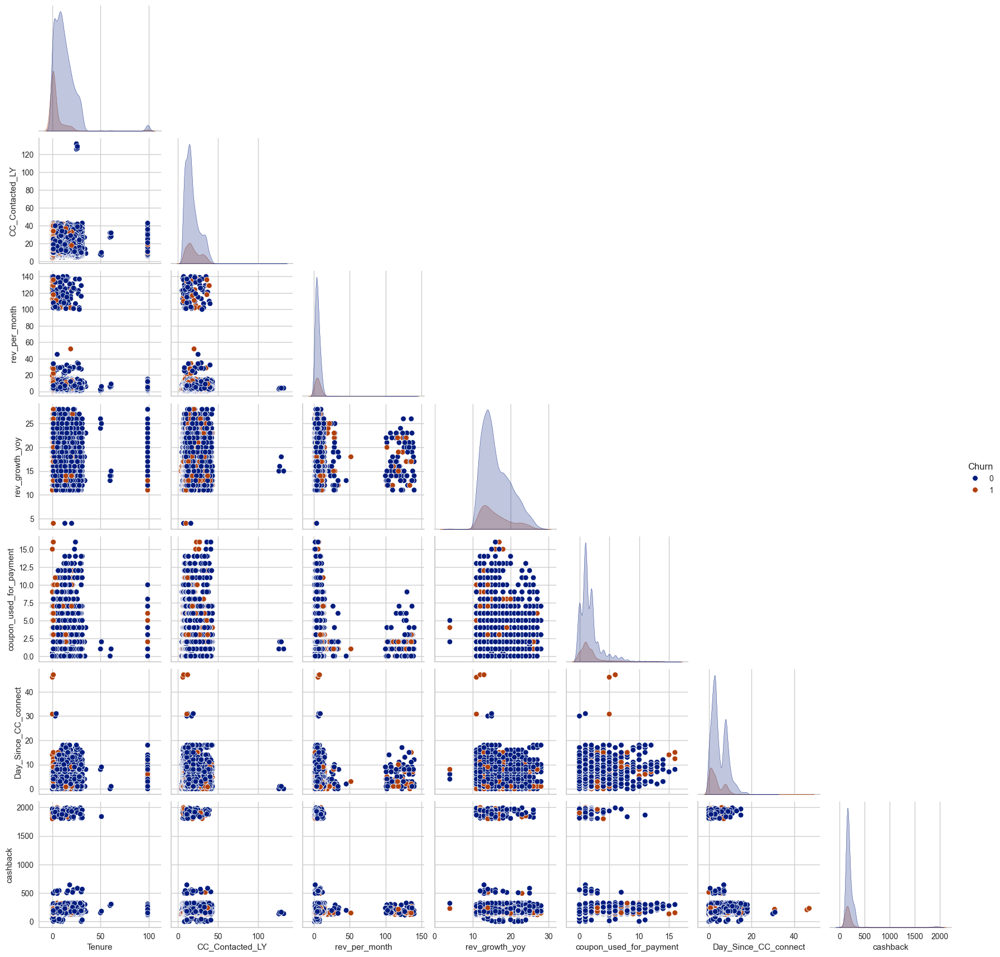

In [80]:
#Pairplot
sns.pairplot(df_temp, corner=True, hue= 'Churn', palette='dark')
plt.show()

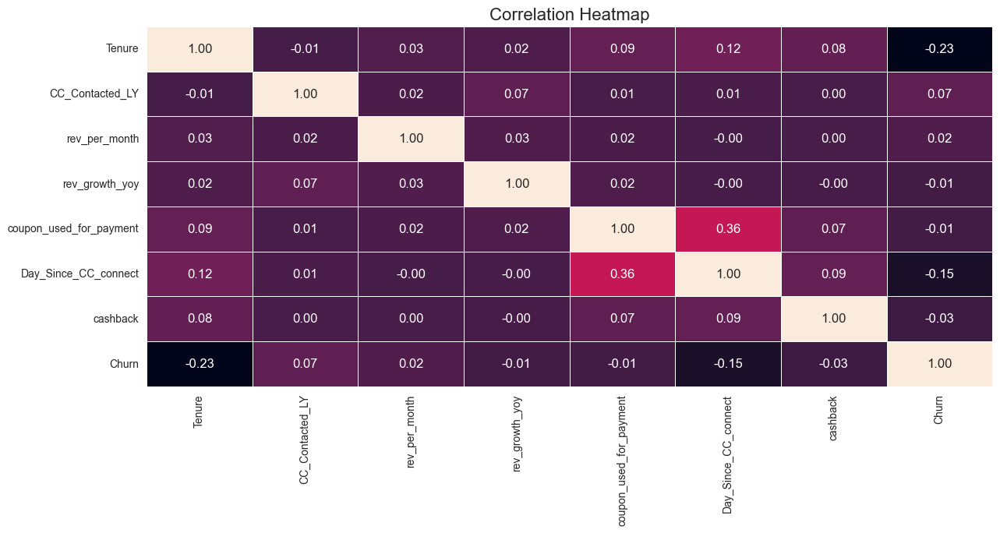

In [81]:
# Filter numeric columns for correlation computation
numeric_columns = df_temp.select_dtypes(include=['float64', 'int64']).columns
# Compute correlation matrix
corr = df_temp[numeric_columns].corr(method='pearson')
# Plot correlation heatmap
plt.figure(figsize=(14, 6))
sns.heatmap(corr, annot=True, fmt='.2f', cbar=None, linewidth=0.5)
plt.title('Correlation Heatmap', fontsize=16)
plt.show()

In [82]:
# Filter numeric columns for correlation computation
numeric_columns = df_temp.select_dtypes(include=['float64', 'int64']).columns

# Compute correlation matrix
corr = df_temp[numeric_columns].corr(method='pearson')

# Create a list to store correlation pairs and values
correlation_list = []

# Populate correlation list with unique pairs and their correlations
for i, col1 in enumerate(corr.columns):
    for j, col2 in enumerate(corr.columns):
        if i < j:  # Ensures we only consider unique pairs and not self-correlations
            correlation = corr.iloc[i, j]
            correlation_list.append((col1, col2, correlation))

# Sort correlation list by correlation value in descending order
correlation_list.sort(key=lambda x: abs(x[2]), reverse=True)

# Print correlation matrix in descending order
print('Correlation Heatmap (Descending Order):')
print('__' * 30)
seen_pairs = set()
for col1, col2, correlation in correlation_list:
    pair = tuple(sorted((col1, col2)))  # Ensure pair is sorted to avoid duplicates like ('A', 'B') and ('B', 'A')
    if pair not in seen_pairs:
        print(f"{col1} - {col2}: {correlation:.2f}")
        seen_pairs.add(pair)

# Example of printed output for each pair:
# Feature1 - Feature2: correlation_value (sorted by absolute correlation value)

Correlation Heatmap (Descending Order):
____________________________________________________________
coupon_used_for_payment - Day_Since_CC_connect: 0.36
Tenure - Churn: -0.23
Day_Since_CC_connect - Churn: -0.15
Tenure - Day_Since_CC_connect: 0.12
Tenure - coupon_used_for_payment: 0.09
Day_Since_CC_connect - cashback: 0.09
Tenure - cashback: 0.08
coupon_used_for_payment - cashback: 0.07
CC_Contacted_LY - Churn: 0.07
CC_Contacted_LY - rev_growth_yoy: 0.07
cashback - Churn: -0.03
Tenure - rev_per_month: 0.03
rev_per_month - rev_growth_yoy: 0.03
rev_per_month - Churn: 0.02
Tenure - rev_growth_yoy: 0.02
rev_growth_yoy - coupon_used_for_payment: 0.02
CC_Contacted_LY - rev_per_month: 0.02
rev_per_month - coupon_used_for_payment: 0.02
coupon_used_for_payment - Churn: -0.01
rev_growth_yoy - Churn: -0.01
CC_Contacted_LY - Day_Since_CC_connect: 0.01
Tenure - CC_Contacted_LY: -0.01
CC_Contacted_LY - coupon_used_for_payment: 0.01
rev_per_month - cashback: 0.00
CC_Contacted_LY - cashback: 0.00
rev_

**Multicollinearity**

---
---

- Tenure, the time since the last contact with customer care (Day_Since_CC_connect), and cashback appear to have the most significant impact on churn. Customers with longer tenure, recent contact with customer care, and higher cashback are less likely to churn.
- Other variables, such as CC_Contacted_LY, Account_user_count, and usage of coupons for payment, have weaker correlations with churn and may have a less pronounced impact.
- Monthly revenue and year-over-year revenue growth do not have strong correlations with churn, indicating that these factors may not be the primary drivers of customer churn.


1. **Positive Relationships:**
   - Customers with longer tenure tend to generate higher monthly revenue and have been using their credit cards for a longer period.
   - There is a strong positive relationship between monthly revenue and cashback, indicating that customers who generate more revenue receive higher cashback.
   - In higher city tiers, customers are more likely to use E-wallets for payments.

2. **Negative Relationships:**
   - Longer-tenured customers are less likely to belong to the "Regular Plus" account segment and are slightly less likely to be married.
   - Customers in higher city tiers are less likely to be in the "Regular Plus" account segment.
   - Customers receiving higher cashback are less likely to be in the "Regular Plus" account segment.

3. **Low Relationships:**
   - Gender does not strongly correlate with most variables, suggesting that it may not significantly impact other customer behaviors.
   - Contacting customer care in the last year does not show strong correlations with other variables, indicating that this activity might not strongly influence other aspects of customer behavior.


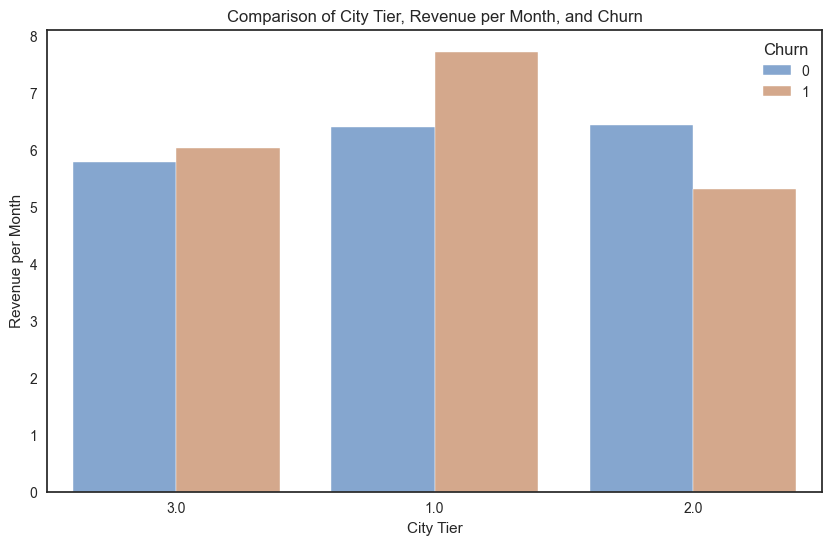

In [83]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
sns.barplot(data=df_temp, x="City_Tier", y="rev_per_month", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("City Tier")
plt.ylabel("Revenue per Month")
plt.title("Comparison of City Tier, Revenue per Month, and Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

In [84]:
print("Comparison of City Tier, Revenue per Month, and Churn")
print("=" * 50)

# Group the data by City_Tier and Churn, then calculate the mean revenue per month
grouped_data = df_temp.groupby(['City_Tier', 'Churn'])['rev_per_month'].mean().reset_index()

# Define a mapping for the Churn column for readability
churn_map = {0: 'Not Churn', 1: 'Churn'}
grouped_data['Churn'] = grouped_data['Churn'].map(churn_map)

# Print the results
for city_tier in grouped_data['City_Tier'].unique():
    print(f"\nCity Tier: {city_tier}")
    for churn_status in ['Not Churn', 'Churn']:
        mean_revenue = grouped_data[(grouped_data['City_Tier'] == city_tier) & (grouped_data['Churn'] == churn_status)]['rev_per_month'].values[0]
        print(f"  {churn_status}: Mean Revenue per Month = {mean_revenue:.2f}")


Comparison of City Tier, Revenue per Month, and Churn

City Tier: 1.0
  Not Churn: Mean Revenue per Month = 6.40
  Churn: Mean Revenue per Month = 7.72

City Tier: 2.0
  Not Churn: Mean Revenue per Month = 6.43
  Churn: Mean Revenue per Month = 5.31

City Tier: 3.0
  Not Churn: Mean Revenue per Month = 5.79
  Churn: Mean Revenue per Month = 6.03


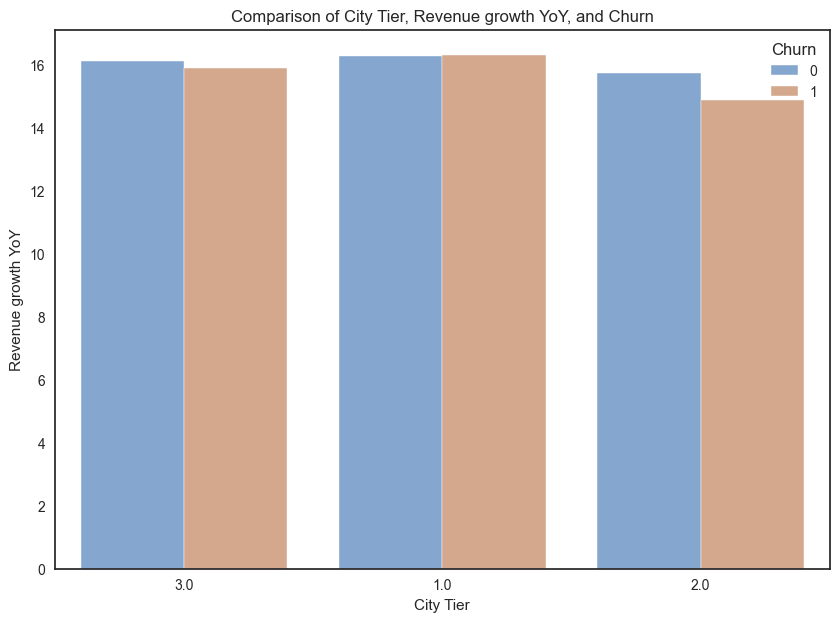

In [85]:
sns.set_style("white")
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x="City_Tier", y="rev_growth_yoy", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("City Tier")
plt.ylabel("Revenue growth YoY")
plt.title("Comparison of City Tier, Revenue growth YoY, and Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

In [86]:
print("Comparison of City Tier, Revenue Growth YoY, and Churn")
print("=" * 50)

# Group the data by City_Tier and Churn, then calculate the mean revenue growth YoY
grouped_data = df_temp.groupby(['City_Tier', 'Churn'])['rev_growth_yoy'].mean().reset_index()

# Define a mapping for the Churn column for readability
churn_map = {0: 'Not Churn', 1: 'Churn'}
grouped_data['Churn'] = grouped_data['Churn'].map(churn_map)

# Print the results
for city_tier in grouped_data['City_Tier'].unique():
    print(f"\nCity Tier: {city_tier}")
    for churn_status in ['Not Churn', 'Churn']:
        mean_revenue_growth = grouped_data[(grouped_data['City_Tier'] == city_tier) & (grouped_data['Churn'] == churn_status)]['rev_growth_yoy'].values[0]
        print(f"  {churn_status}: Mean Revenue Growth YoY = {mean_revenue_growth:.2f}")


Comparison of City Tier, Revenue Growth YoY, and Churn

City Tier: 1.0
  Not Churn: Mean Revenue Growth YoY = 16.29
  Churn: Mean Revenue Growth YoY = 16.31

City Tier: 2.0
  Not Churn: Mean Revenue Growth YoY = 15.74
  Churn: Mean Revenue Growth YoY = 14.88

City Tier: 3.0
  Not Churn: Mean Revenue Growth YoY = 16.11
  Churn: Mean Revenue Growth YoY = 15.90


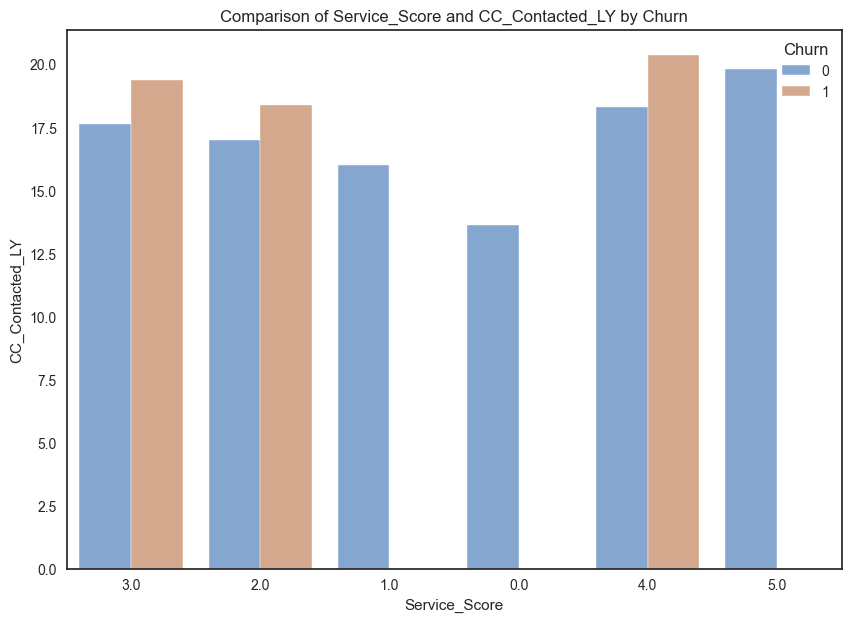

In [87]:
x = "Service_Score"
y = "CC_Contacted_LY"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

In [88]:
x = "Service_Score"
y = "CC_Contacted_LY"

print(f"Comparison of {x} and {y} by Churn")
print("=" * 60)

# Group the data by Service_Score and Churn, then calculate the mean CC_Contacted_LY
grouped_data = df_temp.groupby([x, 'Churn'])[y].mean().reset_index()

# Define a mapping for the Churn column for readability
churn_map = {0: 'Not Churn', 1: 'Churn'}
grouped_data['Churn'] = grouped_data['Churn'].map(churn_map)

# Print the results
for service_score in grouped_data[x].unique():
    print(f"\nService Score: {service_score}")
    for churn_status in ['Not Churn', 'Churn']:
        mean_contacted = grouped_data[(grouped_data[x] == service_score) & (grouped_data['Churn'] == churn_status)][y].values
        if mean_contacted:
            mean_contacted = mean_contacted[0]
            print(f"  {churn_status}: Mean {y} = {mean_contacted:.2f}")
        else:
            print(f"  {churn_status}: No data")

Comparison of Service_Score and CC_Contacted_LY by Churn

Service Score: 0.0
  Not Churn: Mean CC_Contacted_LY = 13.62
  Churn: No data

Service Score: 1.0
  Not Churn: Mean CC_Contacted_LY = 15.99
  Churn: No data

Service Score: 2.0
  Not Churn: Mean CC_Contacted_LY = 16.98
  Churn: Mean CC_Contacted_LY = 18.38

Service Score: 3.0
  Not Churn: Mean CC_Contacted_LY = 17.64
  Churn: Mean CC_Contacted_LY = 19.37

Service Score: 4.0
  Not Churn: Mean CC_Contacted_LY = 18.29
  Churn: Mean CC_Contacted_LY = 20.35

Service Score: 5.0
  Not Churn: Mean CC_Contacted_LY = 19.80
  Churn: No data


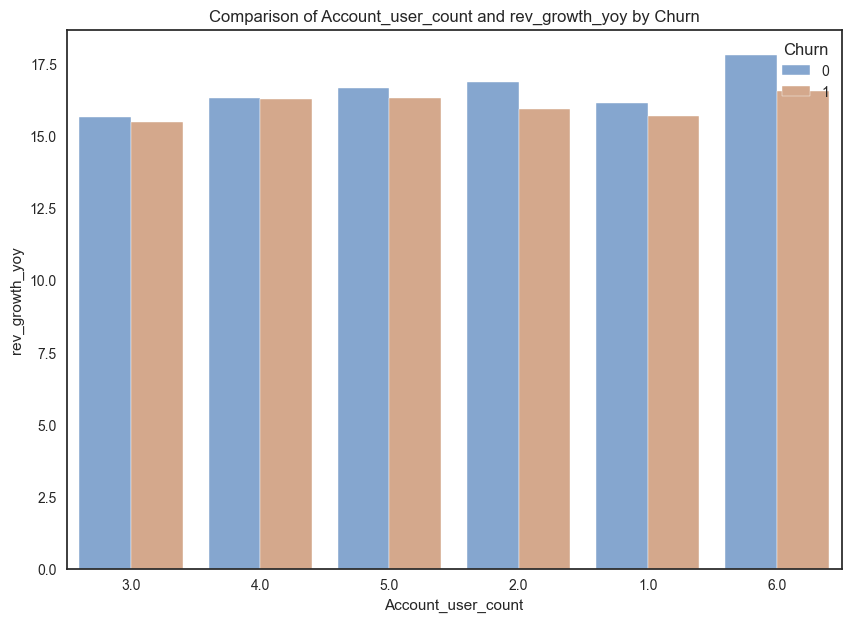

In [89]:
x = "Account_user_count"
y = "rev_growth_yoy"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

In [90]:
x = "Account_user_count"
y = "rev_growth_yoy"

print(f"Comparison of {x} and {y} by Churn")
print("=" * 60)

# Group the data by Account_user_count and Churn, then calculate the mean rev_growth_yoy
grouped_data = df_temp.groupby([x, 'Churn'])[y].mean().reset_index()

# Define a mapping for the Churn column for readability
churn_map = {0: 'Not Churn', 1: 'Churn'}
grouped_data['Churn'] = grouped_data['Churn'].map(churn_map)

# Print the results
for account_user_count in grouped_data[x].unique():
    print(f"\nAccount User Count: {account_user_count}")
    for churn_status in ['Not Churn', 'Churn']:
        mean_rev_growth = grouped_data[(grouped_data[x] == account_user_count) & (grouped_data['Churn'] == churn_status)][y].values
        if mean_rev_growth:
            mean_rev_growth = mean_rev_growth[0]
            print(f"  {churn_status}: Mean {y} = {mean_rev_growth:.2f}")
        else:
            print(f"  {churn_status}: No data")


Comparison of Account_user_count and rev_growth_yoy by Churn

Account User Count: 1.0
  Not Churn: Mean rev_growth_yoy = 16.13
  Churn: Mean rev_growth_yoy = 15.70

Account User Count: 2.0
  Not Churn: Mean rev_growth_yoy = 16.86
  Churn: Mean rev_growth_yoy = 15.92

Account User Count: 3.0
  Not Churn: Mean rev_growth_yoy = 15.64
  Churn: Mean rev_growth_yoy = 15.48

Account User Count: 4.0
  Not Churn: Mean rev_growth_yoy = 16.31
  Churn: Mean rev_growth_yoy = 16.29

Account User Count: 5.0
  Not Churn: Mean rev_growth_yoy = 16.68
  Churn: Mean rev_growth_yoy = 16.31

Account User Count: 6.0
  Not Churn: Mean rev_growth_yoy = 17.80
  Churn: Mean rev_growth_yoy = 16.56


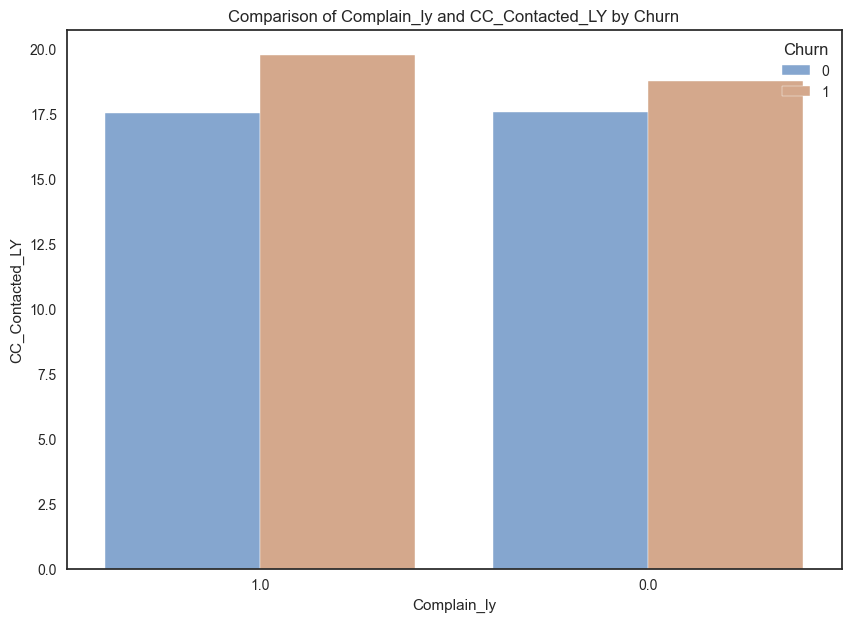

In [91]:
x = "Complain_ly"
y = "CC_Contacted_LY"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

In [92]:
x = "Complain_ly"
y = "CC_Contacted_LY"

print(f"Comparison of {x} and {y} by Churn")
print("=" * 60)

# Group the data by Complain_ly and Churn, then calculate the mean CC_Contacted_LY
grouped_data = df_temp.groupby([x, 'Churn'])[y].mean().reset_index()

# Define a mapping for the Churn column for readability
churn_map = {0: 'Not Churn', 1: 'Churn'}
grouped_data['Churn'] = grouped_data['Churn'].map(churn_map)

# Print the results
for complain_ly in grouped_data[x].unique():
    print(f"\nComplain Last Year: {complain_ly}")
    for churn_status in ['Not Churn', 'Churn']:
        mean_cc_contacted = grouped_data[(grouped_data[x] == complain_ly) & (grouped_data['Churn'] == churn_status)][y].values
        if mean_cc_contacted:
            mean_cc_contacted = mean_cc_contacted[0]
            print(f"  {churn_status}: Mean {y} = {mean_cc_contacted:.2f}")
        else:
            print(f"  {churn_status}: No data")

Comparison of Complain_ly and CC_Contacted_LY by Churn

Complain Last Year: 0.0
  Not Churn: Mean CC_Contacted_LY = 17.58
  Churn: Mean CC_Contacted_LY = 18.78

Complain Last Year: 1.0
  Not Churn: Mean CC_Contacted_LY = 17.54
  Churn: Mean CC_Contacted_LY = 19.76


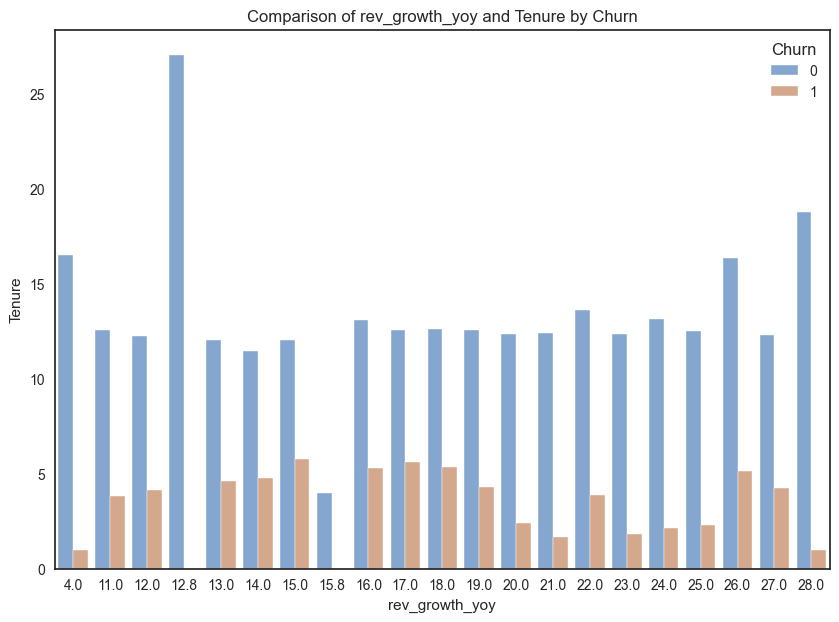

In [93]:
x = "rev_growth_yoy"
y = "Tenure"
plt.figure(figsize=(10, 7))
sns.barplot(data=df_temp, x=x, y=y, hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel(df_temp[x].name)
plt.ylabel(df_temp[y].name)
plt.title(f"Comparison of {df_temp[x].name} and {df_temp[y].name} by Churn")
plt.legend(title="Churn", loc="upper right")
plt.show()

In [94]:
x = "rev_growth_yoy"
y = "Tenure"

print(f"Comparison of {x} and {y} by Churn")
print("=" * 60)

# Group the data by rev_growth_yoy and Churn, then calculate the mean Tenure
grouped_data = df_temp.groupby([x, 'Churn'])[y].mean().reset_index()

# Define a mapping for the Churn column for readability
churn_map = {0: 'Not Churn', 1: 'Churn'}
grouped_data['Churn'] = grouped_data['Churn'].map(churn_map)

# Print the results
for rev_growth in grouped_data[x].unique():
    print(f"\nRevenue Growth YoY: {rev_growth}")
    for churn_status in ['Not Churn', 'Churn']:
        mean_tenure = grouped_data[(grouped_data[x] == rev_growth) & (grouped_data['Churn'] == churn_status)][y].values
        if mean_tenure:
            mean_tenure = mean_tenure[0]
            print(f"  {churn_status}: Mean {y} = {mean_tenure:.2f}")
        else:
            print(f"  {churn_status}: No data")

Comparison of rev_growth_yoy and Tenure by Churn

Revenue Growth YoY: 4.0
  Not Churn: Mean Tenure = 16.50
  Churn: Mean Tenure = 1.00

Revenue Growth YoY: 11.0
  Not Churn: Mean Tenure = 12.54
  Churn: Mean Tenure = 3.83

Revenue Growth YoY: 12.0
  Not Churn: Mean Tenure = 12.23
  Churn: Mean Tenure = 4.14

Revenue Growth YoY: 12.8
  Not Churn: Mean Tenure = 27.00
  Churn: No data

Revenue Growth YoY: 13.0
  Not Churn: Mean Tenure = 12.03
  Churn: Mean Tenure = 4.61

Revenue Growth YoY: 14.0
  Not Churn: Mean Tenure = 11.45
  Churn: Mean Tenure = 4.74

Revenue Growth YoY: 15.0
  Not Churn: Mean Tenure = 12.01
  Churn: Mean Tenure = 5.77

Revenue Growth YoY: 15.8
  Not Churn: Mean Tenure = 4.00
  Churn: No data

Revenue Growth YoY: 16.0
  Not Churn: Mean Tenure = 13.06
  Churn: Mean Tenure = 5.28

Revenue Growth YoY: 17.0
  Not Churn: Mean Tenure = 12.57
  Churn: Mean Tenure = 5.61

Revenue Growth YoY: 18.0
  Not Churn: Mean Tenure = 12.61
  Churn: Mean Tenure = 5.37

Revenue Growth Yo

# Clustering

In [95]:
clust_df= df1.drop('Churn', axis=1)
clust_df.head()

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0


Elbow Method to determine the number of clusters to be formed:


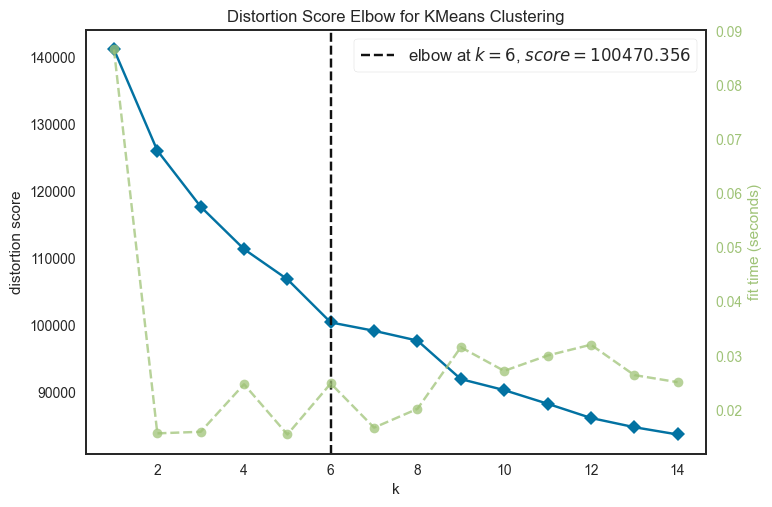

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [96]:

# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
k = range(1, 15)
km = KMeans(max_iter=1000, random_state=42)
Elbow_M = KElbowVisualizer(km, k=k)
Elbow_M.fit(clust_df)
Elbow_M.show()

In [97]:
from sklearn.metrics import silhouette_score, silhouette_samples

for i in range(2, 9):
  k_means = KMeans(n_clusters = i, random_state = 42)
  k_means.fit(clust_df)
  labels = k_means.labels_
  print('k =', i)
  print('Silhouette Score =', silhouette_score(clust_df, labels))
  print('Minimum Sil Width =', silhouette_samples(clust_df, labels).min(), '\n')

k = 2
Silhouette Score = 0.11751475444935973
Minimum Sil Width = 0.005476549899927271 

k = 3
Silhouette Score = 0.10443266009228731
Minimum Sil Width = -0.05861420891302987 

k = 4
Silhouette Score = 0.10661709644235459
Minimum Sil Width = -0.13488267895357747 

k = 5
Silhouette Score = 0.07744608418309015
Minimum Sil Width = -0.16977462258043263 

k = 6
Silhouette Score = 0.10381578469535342
Minimum Sil Width = -0.10496041429352 

k = 7
Silhouette Score = 0.08728016809162874
Minimum Sil Width = -0.14989766880923686 

k = 8
Silhouette Score = 0.07381085344749214
Minimum Sil Width = -0.2420166222586028 



In [98]:
# K =2
k_means = KMeans(n_clusters = 2, random_state = 42)
k_means.fit(clust_df)
clust_df['Clusters_2'] = k_means.labels_

In [99]:
aggdata = clust_df.groupby('Clusters_2').mean()
aggdata['freq'] = clust_df['Clusters_2'].value_counts().sort_index()
display( round(aggdata,2))

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,freq
Clusters_2,,,,,,,,,,,,,,,,,,
0,-0.01,0.63,0.00,1.74,0.59,2.91,2.69,2.16,2.84,1.16,-0.06,0.26,-0.03,-0.00,-0.01,-0.07,0.73,7794
1,0.02,0.68,-0.02,1.81,0.63,2.88,2.73,2.20,0.34,1.18,-0.09,0.30,0.06,-0.03,-0.02,-0.07,0.73,3466


In [100]:
aggdata[num_columns] = pd.DataFrame(scaler.inverse_transform(aggdata[num_columns]), columns = aggdata[num_columns].columns)
display( round(aggdata,2).T)

Clusters_2,0,1
Tenure,10.91,11.23
City_Tier,0.63,0.68
CC_Contacted_LY,17.88,17.68
Payment,1.74,1.81
Gender,0.59,0.63
Service_Score,2.91,2.88
Account_user_count,2.69,2.73
account_segment,2.16,2.20
CC_Agent_Score,2.84,0.34
Marital_Status,1.16,1.18


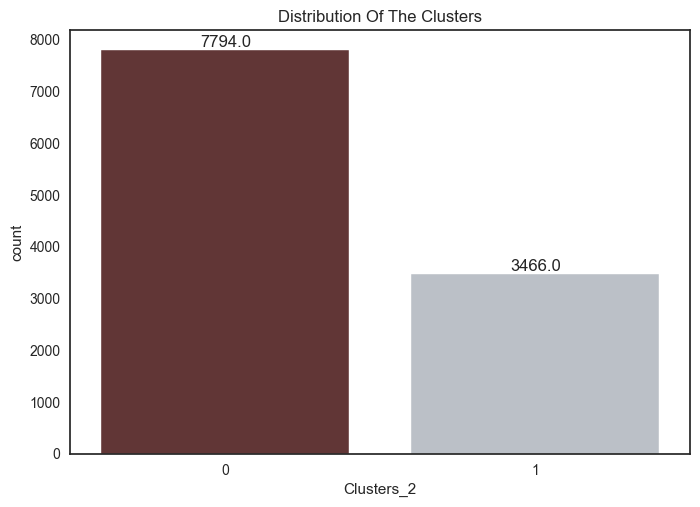

In [101]:
#Plotting countplot of clusters
sns.set_style("white")
pal = ["#682F2F","#B9C0C9", "#9F8A78","#F3AB60"]
pl = sns.countplot(x=clust_df["Clusters_2"], palette= pal)
pl.set_title("Distribution Of The Clusters")
for p in pl.patches:
    pl.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='bottom')
plt.show()

In [102]:
df_temp= pd.concat((df_temp, clust_df['Clusters_2']), axis=1)
df_temp.head()

,Tenure,CC_Contacted_LY,rev_per_month,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,City_Tier,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,Complain_ly,Login_device,Churn,Clusters_2
0,4.0,6.0,9.0,11.0,1.0,5.0,159.929993,3.0,Debit Card,Female,3.0,3.0,Super,2.0,Single,1.0,Mobile,1,1
1,0.0,8.0,7.0,15.0,0.0,0.0,120.900002,1.0,UPI,Male,3.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1,0
2,0.0,30.0,6.0,14.0,0.0,3.0,128.001999,1.0,Debit Card,Male,2.0,4.0,Regular Plus,3.0,Single,1.0,Mobile,1,0
3,0.0,15.0,8.0,23.0,0.0,3.0,134.070007,3.0,Debit Card,Male,2.0,4.0,Super,5.0,Single,0.0,Mobile,1,0
4,0.0,12.0,3.0,11.0,1.0,3.0,129.600006,1.0,Credit Card,Male,2.0,3.0,Regular Plus,5.0,Single,0.0,Mobile,1,0


In [103]:
df_temp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11260 entries, 0 to 11259
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Tenure                   11260 non-null  float64
 1   CC_Contacted_LY          11260 non-null  float64
 2   rev_per_month            11260 non-null  float64
 3   rev_growth_yoy           11260 non-null  float64
 4   coupon_used_for_payment  11260 non-null  float64
 5   Day_Since_CC_connect     11260 non-null  float64
 6   cashback                 11260 non-null  float64
 7   City_Tier                11260 non-null  object 
 8   Payment                  11260 non-null  object 
 9   Gender                   11260 non-null  object 
 10  Service_Score            11260 non-null  object 
 11  Account_user_count       11260 non-null  object 
 12  account_segment          11260 non-null  object 
 13  CC_Agent_Score           11260 non-null  object 
 14  Marital_Status        

In [104]:
# clust_profile=df_temp
# clust_profile=clust_profile.groupby('Clusters_2').mean()
# clust_profile['freq']=df_temp.Clusters_2.value_counts().sort_index()
# np.round(clust_profile,2).T

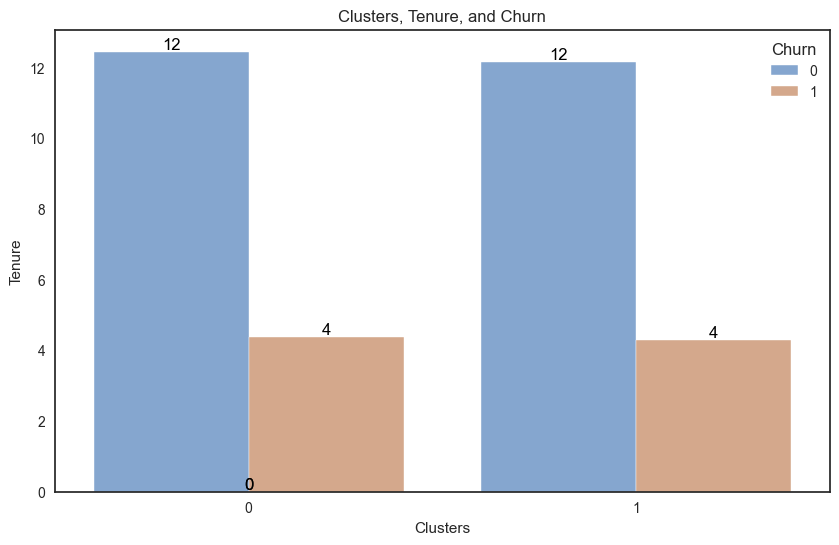

In [105]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="Tenure", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("Tenure")
plt.title("Clusters, Tenure, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

In [106]:
# Calculate mean Tenure for each combination of Clusters_2 and Churn
cluster_churn_means = df_temp.groupby(['Clusters_2', 'Churn'])['Tenure'].mean().unstack()

print("Mean Tenure for each Cluster and Churn status:")
for cluster in cluster_churn_means.index:
    print(f"\nCluster {cluster}:")
    for churn_status in cluster_churn_means.columns:
        mean_tenure = cluster_churn_means.loc[cluster, churn_status]
        churn_label = "Churned" if churn_status == 1 else "Not Churned"
        print(f"  {churn_label}: {mean_tenure:.0f}")

Mean Tenure for each Cluster and Churn status:

Cluster 0:
  Not Churned: 12
  Churned: 4

Cluster 1:
  Not Churned: 12
  Churned: 4


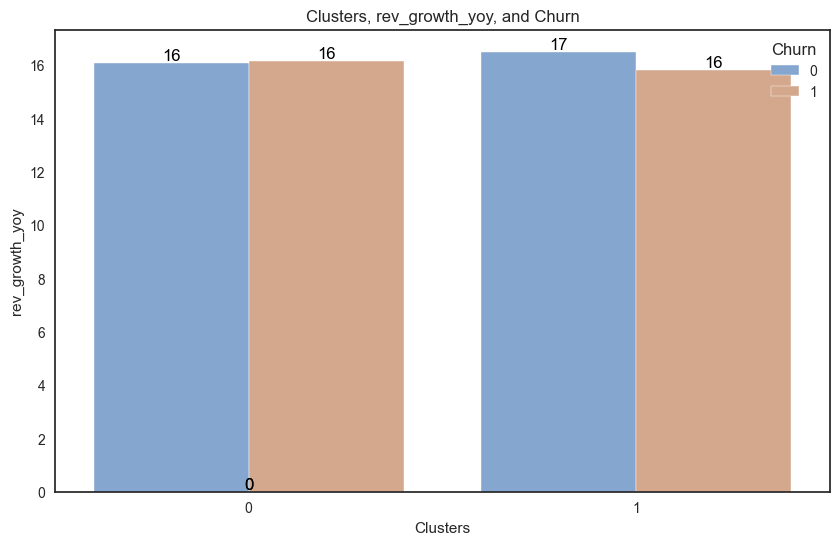

In [107]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="rev_growth_yoy", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("rev_growth_yoy")
plt.title("Clusters, rev_growth_yoy, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

In [108]:
# Calculate mean rev_growth_yoy for each combination of Clusters_2 and Churn
cluster_churn_means = df_temp.groupby(['Clusters_2', 'Churn'])['rev_growth_yoy'].mean().unstack()

print("Mean rev_growth_yoy for each Cluster and Churn status:")
for cluster in cluster_churn_means.index:
    print(f"\nCluster {cluster}:")
    for churn_status in cluster_churn_means.columns:
        mean_rev_growth = cluster_churn_means.loc[cluster, churn_status]
        churn_label = "Churned" if churn_status == 1 else "Not Churned"
        print(f"  {churn_label}: {mean_rev_growth:.1f}")

Mean rev_growth_yoy for each Cluster and Churn status:

Cluster 0:
  Not Churned: 16.1
  Churned: 16.2

Cluster 1:
  Not Churned: 16.5
  Churned: 15.8


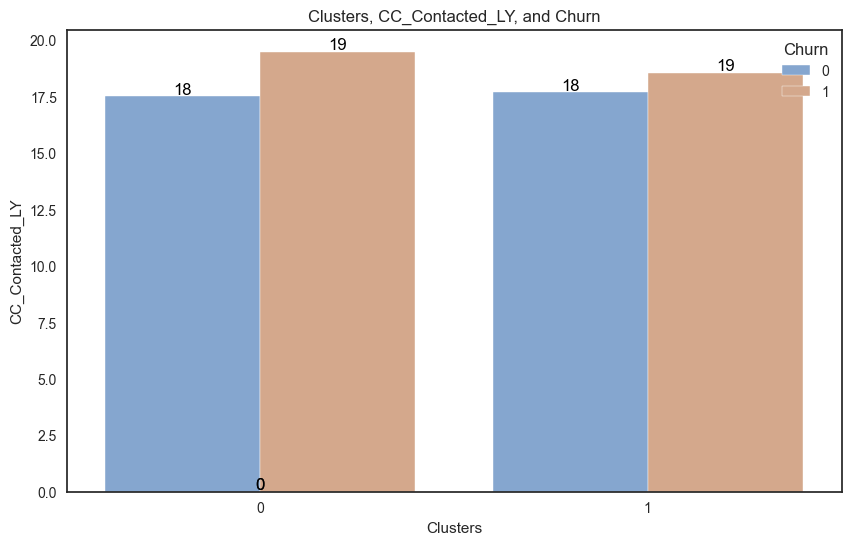

In [109]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="CC_Contacted_LY", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("CC_Contacted_LY")
plt.title("Clusters, CC_Contacted_LY, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

In [110]:
# Calculate mean CC_Contacted_LY for each combination of Clusters_2 and Churn
cluster_churn_means = df_temp.groupby(['Clusters_2', 'Churn'])['CC_Contacted_LY'].mean().unstack()

print("Mean CC_Contacted_LY for each Cluster and Churn status:")
for cluster in cluster_churn_means.index:
    print(f"\nCluster {cluster}:")
    for churn_status in cluster_churn_means.columns:
        mean_contacts = cluster_churn_means.loc[cluster, churn_status]
        churn_label = "Churned" if churn_status == 1 else "Not Churned"
        print(f"  {churn_label}: {mean_contacts:.1f}")

Mean CC_Contacted_LY for each Cluster and Churn status:

Cluster 0:
  Not Churned: 17.5
  Churned: 19.5

Cluster 1:
  Not Churned: 17.7
  Churned: 18.6


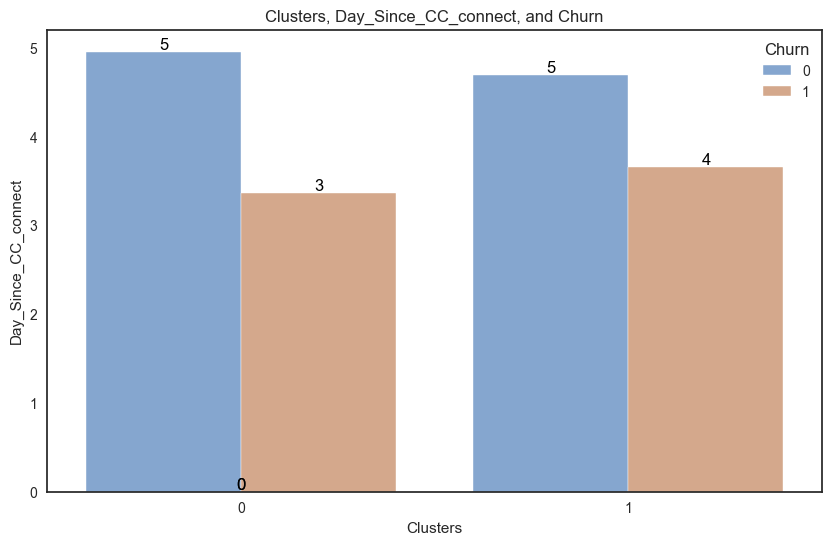

In [111]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="Day_Since_CC_connect", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("Day_Since_CC_connect")
plt.title("Clusters, Day_Since_CC_connect, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

In [112]:
# Calculate mean Day_Since_CC_connect for each combination of Clusters_2 and Churn
cluster_churn_means = df_temp.groupby(['Clusters_2', 'Churn'])['Day_Since_CC_connect'].mean().unstack()

print("Mean Day_Since_CC_connect for each Cluster and Churn status:")
for cluster in cluster_churn_means.index:
    print(f"\nCluster {cluster}:")
    for churn_status in cluster_churn_means.columns:
        mean_days = cluster_churn_means.loc[cluster, churn_status]
        churn_label = "Churned" if churn_status == 1 else "Not Churned"
        print(f"  {churn_label}: {mean_days:.1f}")

Mean Day_Since_CC_connect for each Cluster and Churn status:

Cluster 0:
  Not Churned: 5.0
  Churned: 3.4

Cluster 1:
  Not Churned: 4.7
  Churned: 3.7


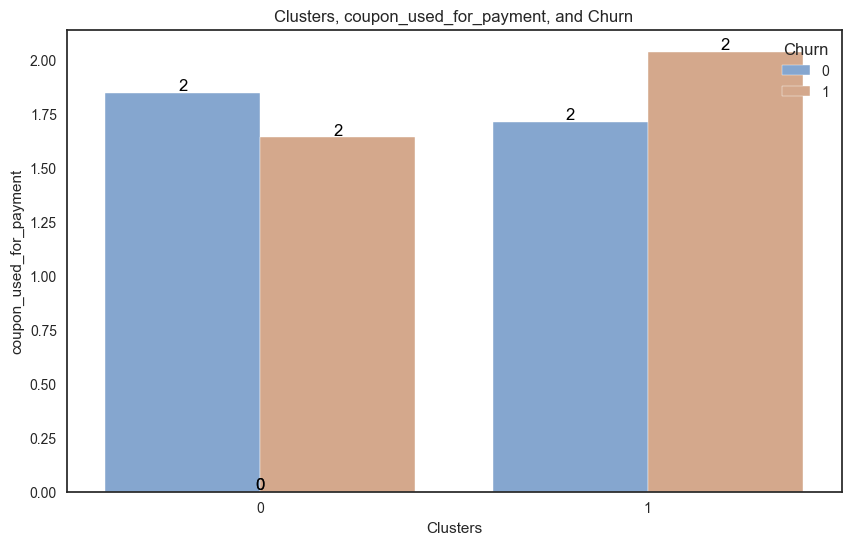

In [113]:
sns.set_style("white")
plt.figure(figsize=(10, 6))
ax = sns.barplot(data=df_temp, x="Clusters_2", y="coupon_used_for_payment", hue="Churn", errorbar=None, palette={0: '#79a5db', 1: '#e0a580'})
plt.xlabel("Clusters")
plt.ylabel("coupon_used_for_payment")
plt.title("Clusters, coupon_used_for_payment, and Churn")

for p in ax.patches:
    ax.annotate(f'{p.get_height():.0f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', fontsize=12, color='black', xytext=(0, 5), textcoords='offset points')

plt.legend(title="Churn", loc="upper right")
plt.show()

In [114]:
# Calculate mean coupon_used_for_payment for each combination of Clusters_2 and Churn
cluster_churn_means = df_temp.groupby(['Clusters_2', 'Churn'])['coupon_used_for_payment'].mean().unstack()

print("Mean coupon_used_for_payment for each Cluster and Churn status:")
for cluster in cluster_churn_means.index:
    print(f"\nCluster {cluster}:")
    for churn_status in cluster_churn_means.columns:
        mean_coupon_used = cluster_churn_means.loc[cluster, churn_status]
        churn_label = "Churned" if churn_status == 1 else "Not Churned"
        print(f"  {churn_label}: {mean_coupon_used:.1f}")

Mean coupon_used_for_payment for each Cluster and Churn status:

Cluster 0:
  Not Churned: 1.8
  Churned: 1.6

Cluster 1:
  Not Churned: 1.7
  Churned: 2.0


## **EDA Summary**

---



**Executive Summary:**

1. **Data Collection and Preprocessing:**
   - The dataset appears to be derived from a DTH (Direct-To-Home) service provider, containing records over an unspecified period, possibly in Indian states with payments in Rupees via UPI.
   - Data preprocessing was performed to address missing values, correct data types, and standardize data. Anomalies and unexpected values were resolved.
   
2. **Exploratory Data Analysis:**
   - The dataset consists of 11,260 rows and 19 columns with a binary target variable, "Churn," representing customer attrition.
   - Key findings include class imbalance with only 16.8% of customers marked as churned.
   - Numerical features exhibit varying distributions, such as positively skewed tenure, moderate-skewed revenue, and highly skewed cashback.
   - Categorical variables like "City_Tier" show that the majority of customers are in Tier 1 cities, and payment methods like "Debit Card" and "Credit Card" are popular.
   
3. **Bivariate Analysis:**
   - Analysis of categorical variables indicated relationships between features and churn, highlighting the impact of "City_Tier," "Payment," and "Complain_ly" on customer attrition.
   - In numerical features, lower tenure, higher CC contacts in the last year, lower monthly revenue, and higher cashback amounts were associated with higher churn rates.

4. **Data Preparation:**
   - Unwanted variables were removed, and missing values were imputed using appropriate methods, with 2.04% of the data containing missing values.
   - Outliers were treated by capping values at the 1st and 99th percentiles. Standard scaling was applied to the dataset.

**Business Insights:**

1. **Churn Analysis:**
   - The class imbalance, with only 16.8% churned customers, indicates the need to focus on retaining existing customers to maintain business stability.
   
2. **Demographics and Churn:**
   - Customers from City_Tier 3 have a higher churn rate, suggesting that tailored offerings or incentives may be needed to retain these customers.
   - Churn rates differ based on payment methods and gender. Efforts should be made to engage male customers more effectively.

3. **Service and Customer Care:**
   - The "Service_Score" analysis shows that higher scores don't necessarily lead to lower churn. Service quality may need improvement.
   - Customers who complained in the last year had a significantly higher churn rate, indicating a need to address their issues promptly.

4. **Engagement and Loyalty:**
   - Increasing the number of account users leads to a higher churn rate. Strategies for retaining multi-user accounts should be explored.
   - Encouraging customers to use mobile devices for logins may reduce churn, as mobile users exhibit a lower attrition rate.

**Recommendations:**

1. **Balancing Churn Rate:**
   - Implement strategies to retain existing customers, including offering personalized deals and promotions.
   
2. **Customized Service Quality:**
   - Enhance services for specific segments, like "Regular Plus" customers, who have a higher churn rate. Address service quality issues identified in the data.
   
3. **Prompt Complaint Resolution:**
   - Improve customer care and promptly address customer complaints to prevent churn.
   
4. **Multi-User Account Strategies:**
   - Create incentives or tailored offerings for multi-user accounts to reduce attrition.
   
5. **Mobile Login Promotion:**
   - Promote mobile login to lower churn by making it more convenient for customers.


# Model Building

In [115]:
df1.shape

(11260, 18)

In [116]:
df1

,Tenure,City_Tier,CC_Contacted_LY,Payment,Gender,Service_Score,Account_user_count,account_segment,CC_Agent_Score,Marital_Status,rev_per_month,Complain_ly,rev_growth_yoy,coupon_used_for_payment,Day_Since_CC_connect,cashback,Login_device,Churn
0,-0.545460,2.0,-1.340479,2.0,0.0,3.0,2.0,3.0,1.0,2.0,0.221461,1.0,-1.382120,-0.401439,0.099207,-0.203224,1.0,1.0
1,-0.856038,0.0,-1.114564,4.0,1.0,3.0,3.0,2.0,2.0,2.0,0.053522,1.0,-0.317598,-0.909191,-1.253070,-0.421693,1.0,1.0
2,-0.856038,0.0,1.370505,2.0,1.0,2.0,3.0,2.0,2.0,2.0,-0.030447,1.0,-0.583728,-0.909191,-0.441704,-0.381940,1.0,1.0
3,-0.856038,2.0,-0.323860,2.0,1.0,2.0,3.0,3.0,4.0,2.0,0.137492,0.0,1.811447,-0.909191,-0.441704,-0.347974,1.0,1.0
4,-0.856038,0.0,-0.662733,1.0,1.0,2.0,2.0,2.0,4.0,2.0,-0.282355,0.0,-1.382120,-0.401439,-0.441704,-0.372995,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11255,-0.079592,0.0,1.822336,1.0,1.0,3.0,1.0,3.0,0.0,1.0,0.221461,0.0,0.746924,-0.401439,-0.171249,-0.238040,0.0,0.0
11256,0.153341,0.0,0.127971,1.0,1.0,3.0,4.0,0.0,4.0,1.0,0.053522,0.0,-0.051467,-0.401439,0.910573,0.171695,1.0,0.0
11257,-0.778394,0.0,-0.436818,2.0,1.0,3.0,1.0,3.0,3.0,1.0,0.053522,1.0,1.545316,-0.401439,-0.171249,-0.026959,1.0,0.0
11258,0.929787,2.0,-0.775691,1.0,1.0,4.0,4.0,3.0,3.0,1.0,0.053522,0.0,-0.051467,0.106314,1.181028,-0.091442,0.0,0.0


In [117]:
# Split Predictors & response
X = df1.drop('Churn', axis=1)
y= df1['Churn']

In [118]:
#Train & Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size =0.3, random_state=42)

In [119]:
print("Shape of Train dataset:", X_train.shape)
print("Shape of Test dataset:",X_test.shape)

Shape of Train dataset: (7882, 17)
Shape of Test dataset: (3378, 17)


## Variables after SMOTE

In [120]:
# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Note: Do not apply SMote to the test data
X_test_smote, y_test_smote = X_test, y_test

In [121]:
# Check the distribution of the target variable in the training data
print("Original training data class distribution:\n", y_train.value_counts())
print("SMOTE training data class distribution:\n", y_train_smote.value_counts())

Original training data class distribution:
 Churn
0.0    6575
1.0    1307
Name: count, dtype: int64
SMOTE training data class distribution:
 Churn
0.0    6575
1.0    6575
Name: count, dtype: int64


## Function to display confusion matrix and ROC curve

In [122]:
#Defining function to plot confusion matrix and ROC curve
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve
def plot_model_evaluation(model, X_train, y_train, X_test, y_test, model_name):
    # Confusion Matrix
    cm_train = confusion_matrix(y_train, model.predict(X_train))
    cm_test = confusion_matrix(y_test, model.predict(X_test))
    fig, axes = plt.subplots(1, 2, figsize=(9, 4))
    # Train Data
    sns.heatmap(cm_train, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[0])
    axes[0].set_title(f"Confusion Matrix ({model_name} - Train Data)")
    axes[0].set_xlabel("Predicted")
    axes[0].set_ylabel("Actual")
    # Test Data
    sns.heatmap(cm_test, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[1])
    axes[1].set_title(f"Confusion Matrix ({model_name} - Test Data)")
    axes[1].set_xlabel("Predicted")
    axes[1].set_ylabel("Actual")
    # Annotate TP, TN, FP, FN
    for i, cm in enumerate([cm_train, cm_test]):
        axes[i].annotate("TP", xy=(1.45, 1.7), fontsize=10, color='black', va='center')
        axes[i].annotate("TN", xy=(0.45, 0.7), fontsize=10, color='white', va='center')
        axes[i].annotate("FP", xy=(1.45, 0.7), fontsize=10, color='black', va='center')
        axes[i].annotate("FN", xy=(0.45, 1.7), fontsize=10, color='black', va='center')
    plt.tight_layout()
    plt.show()
    # ROC curve
    Y_train_predict_prob = model.predict_proba(X_train)
    probs_train = Y_train_predict_prob[:, 1]
    auc_train = roc_auc_score(y_train, probs_train)
    fpr_train, tpr_train, thresholds_train = roc_curve(y_train, probs_train)
    Y_test_predict_prob = model.predict_proba(X_test)
    probs_test = Y_test_predict_prob[:, 1]
    auc_test = roc_auc_score(y_test, probs_test)
    fpr_test, tpr_test, thresholds_test = roc_curve(y_test, probs_test)
    plt.figure(figsize=(9, 4))
    # ROC curve of training data
    plt.subplot(1, 2, 1)
    plt.title(f'ROC Curve {model_name} Train Data')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.plot(fpr_train, tpr_train, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.text(0.6, 0.3, f'AUC = {round(auc_train, 2)}', fontsize=10)
    # ROC curve of testing data
    plt.subplot(1, 2, 2)
    plt.title(f'ROC Curve {model_name} Test Data')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.plot(fpr_test, tpr_test, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.text(0.6, 0.3, f'AUC = {round(auc_test, 2)}', fontsize=10)
    plt.tight_layout()
    plt.show()

## Function to display Learning Curve and CV scores

In [123]:
#Plot Learning Curve & print CV score
from sklearn.model_selection import cross_val_score, learning_curve
def plot_model_learning_curve(model, model_name, X_train, y_train):
    num_folds = 5
    scoring_metric = 'recall'
    train_sizes = np.linspace(0.1, 1.0, 10)
    # Cross-validation scores
    cv_scores = cross_val_score(model, X_train, y_train, cv=num_folds, scoring=scoring_metric)
    # Learning curve
    sizes, train, test = learning_curve(model, X_train, y_train, cv=num_folds, scoring=scoring_metric, train_sizes=train_sizes)
    # Plot learning curve
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.title(f"Learning Curve for {model_name}")
    plt.xlabel("Training Examples")
    plt.ylabel(f"{scoring_metric} Score")
    plt.grid()
    plt.plot(sizes, np.mean(train, axis=1), 'o-', color="r", label="Training Score")
    plt.plot(sizes, np.mean(test, axis=1), 'o-', color="g", label="Cross-Validation Score")
    plt.legend(loc="best")
    # Print CV scores and variances
    print(f"Model: {model_name}")
    print(f"Cross-Validation Scores: {cv_scores}")
    print(f"Mean CV Score: {np.mean(cv_scores):.3f}")
    print(f"Cross-Validation Variance: {np.var(cv_scores):.3f}")
    print("")

## Function to display confusion matrix and ROC curve SMOTE

In [124]:
# Defining function to plot confusion matrix and ROC curve
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve
def plot_model_evaluation_smote(model, X_train_smote, y_train_smote, X_test_smote, y_test_smote, model_name):
    # Confusion Matrix
    cm_train = confusion_matrix(y_train_smote, model.predict(X_train_smote))
    cm_test = confusion_matrix(y_test_smote, model.predict(X_test_smote))
    fig, axes = plt.subplots(1, 2, figsize=(9, 4))
    # Train Data
    sns.heatmap(cm_train, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[0])
    axes[0].set_title(f"Confusion Matrix ({model_name} - Train Data)")
    axes[0].set_xlabel("Predicted")
    axes[0].set_ylabel("Actual")
    # Test Data
    sns.heatmap(cm_test, annot=True, fmt="d", cmap="Blues", cbar=False, ax=axes[1])
    axes[1].set_title(f"Confusion Matrix ({model_name} - Test Data)")
    axes[1].set_xlabel("Predicted")
    axes[1].set_ylabel("Actual")
    # Annotate TP, TN, FP, FN
    for i, cm in enumerate([cm_train, cm_test]):
        axes[i].annotate("TP", xy=(1.45, 1.7), fontsize=10, color='black', va='center')
        axes[i].annotate("TN", xy=(0.45, 0.7), fontsize=10, color='white', va='center')
        axes[i].annotate("FP", xy=(1.45, 0.7), fontsize=10, color='black', va='center')
        axes[i].annotate("FN", xy=(0.45, 1.7), fontsize=10, color='black', va='center')
    plt.tight_layout()
    plt.show()
    # ROC curve
    Y_train_predict_prob = model.predict_proba(X_train_smote)
    probs_train = Y_train_predict_prob[:, 1]
    auc_train = roc_auc_score(y_train_smote, probs_train)
    fpr_train, tpr_train, thresholds_train = roc_curve(y_train_smote, probs_train)
    Y_test_predict_prob = model.predict_proba(X_test_smote)
    probs_test = Y_test_predict_prob[:, 1]
    auc_test = roc_auc_score(y_test_smote, probs_test)
    fpr_test, tpr_test, thresholds_test = roc_curve(y_test_smote, probs_test)
    plt.figure(figsize=(9, 4))
    # ROC curve of training data
    plt.subplot(1, 2, 1)
    plt.title(f'ROC Curve {model_name} Train Data')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.plot(fpr_train, tpr_train, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.text(0.6, 0.3, f'AUC = {round(auc_train, 2)}', fontsize=10)
    # ROC curve of testing data
    plt.subplot(1, 2, 2)
    plt.title(f'ROC Curve {model_name} Test Data')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.plot(fpr_test, tpr_test, marker='.')
    plt.plot([0, 1], [0, 1], linestyle='--')
    plt.text(0.6, 0.3, f'AUC = {round(auc_test, 2)}', fontsize=10)
    plt.tight_layout()
    plt.show()

## Function to display Learning Curve and CV scores SMOTE

In [125]:
# Plot Learning Curve & print CV score
from sklearn.model_selection import cross_val_score, learning_curve
def plot_model_learning_curve_smote(model, model_name, X_train_smote, y_train_smote):
    num_folds = 5
    scoring_metric = 'recall'
    train_sizes = np.linspace(0.1, 1.0, 10)
    # Cross-validation scores
    cv_scores = cross_val_score(model, X_train_smote, y_train_smote, cv=num_folds, scoring=scoring_metric)
    # Learning curve
    sizes, train, test = learning_curve(model, X_train_smote, y_train_smote, cv=num_folds, scoring=scoring_metric, train_sizes=train_sizes)
    # Plot learning curve
    plt.figure(figsize=(12, 4))
    plt.subplot(1, 2, 1)
    plt.title(f"Learning Curve for {model_name}")
    plt.xlabel("Training Examples")
    plt.ylabel(f"{scoring_metric} Score")
    plt.grid()
    plt.plot(sizes, np.mean(train, axis=1), 'o-', color="r", label="Training Score")
    plt.plot(sizes, np.mean(test, axis=1), 'o-', color="g", label="Cross-Validation Score")
    plt.legend(loc="best")
    # Print CV scores and variances
    print(f"Model: {model_name}")
    print(f"Cross-Validation Scores: {cv_scores}")
    print(f"Mean CV Score: {np.mean(cv_scores):.3f}")
    print(f"Cross-Validation Variance: {np.var(cv_scores):.3f}")
    print("")

# Decision Tree Model

In [126]:
from sklearn.tree import DecisionTreeClassifier
dtcla = DecisionTreeClassifier(random_state=42, criterion = 'gini')
dtcla.fit(X_train_smote, y_train_smote)

DecisionTreeClassifier(random_state=42)

In [127]:
pred_train=dtcla.predict(X_train_smote)
pred_test=dtcla.predict(X_test_smote)

In [128]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      6575
         1.0       1.00      1.00      1.00      6575

    accuracy                           1.00     13150
   macro avg       1.00      1.00      1.00     13150
weighted avg       1.00      1.00      1.00     13150

                   Train data Confusion Matrix
 [[6575    0]
 [   0 6575]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.94      0.95      2789
         1.0       0.74      0.81      0.77       589

    accuracy                           0.92      3378
   macro avg       0.85      0.87      0.86      3378
weighted avg       0.92      0.92      0.92      3378

                   Test data Confusion Matrix
 [[2620  169]
 [ 114  475]]


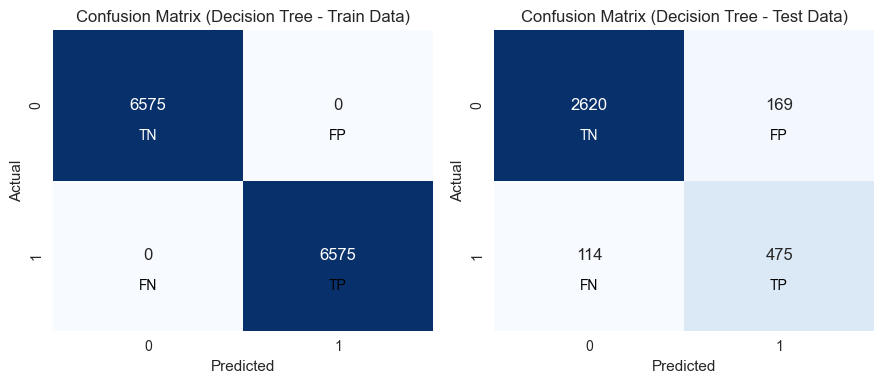

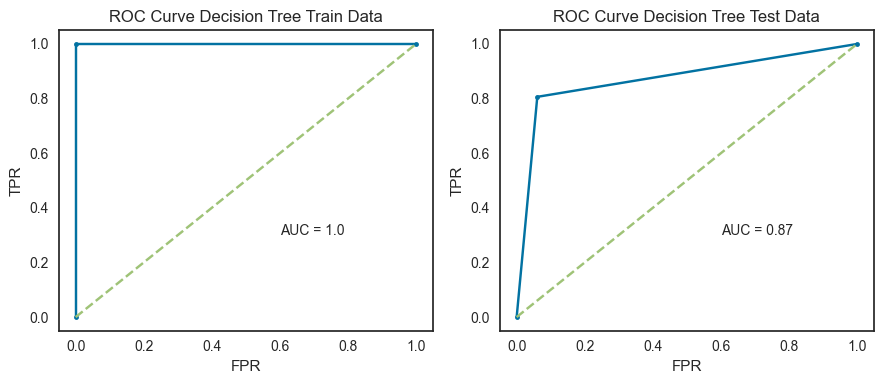

In [129]:
plot_model_evaluation_smote(dtcla, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Decision Tree")

Model: Decision Tree
Cross-Validation Scores: [0.7878327  0.98555133 0.98098859 0.97642586 0.97414449]
Mean CV Score: 0.941
Cross-Validation Variance: 0.006



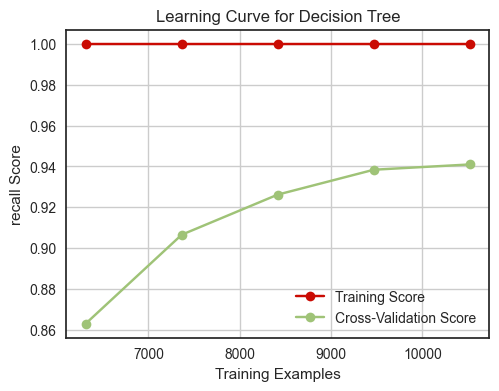

In [130]:
plot_model_learning_curve_smote(dtcla, "Decision Tree", X_train_smote, y_train_smote)

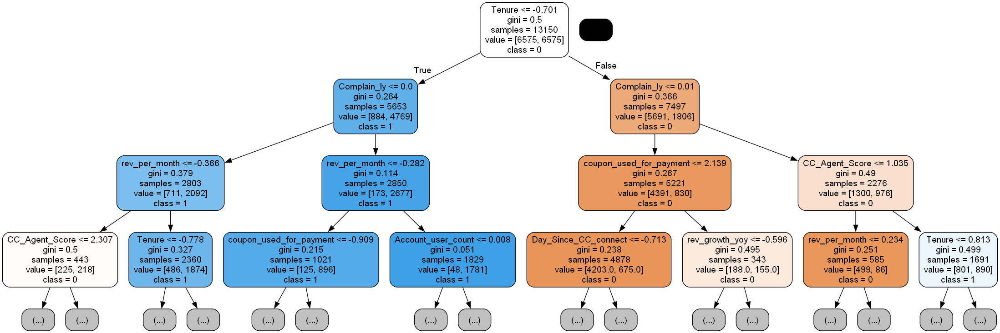

In [131]:
from sklearn import tree
import pydotplus
from IPython.display import Image

train_char_label = ['0', '1']

dot_data = tree.export_graphviz(dtcla, out_file=None, feature_names=list(X_train_smote), class_names=train_char_label, filled=True, rounded=True, max_depth=3)
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

In [132]:
# importance of features in the tree building ( The importance of a feature is computed as the
#(normalized) total reduction of the criterion brought by that feature. It is also known as the Gini importance )

# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(dtcla.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Tenure                   0.435086
CC_Agent_Score           0.070634
rev_per_month            0.066509
Complain_ly              0.059014
rev_growth_yoy           0.054827
Day_Since_CC_connect     0.046541
cashback                 0.044826
Payment                  0.038118
CC_Contacted_LY          0.033447
coupon_used_for_payment  0.030055
City_Tier                0.025780
Account_user_count       0.025066
account_segment          0.022697
Login_device             0.018295
Marital_Status           0.011300
Service_Score            0.009766
Gender                   0.008039


# Random Forest Model

In [133]:
rfcl = RandomForestClassifier(random_state=42)
rfcl.fit(X_train_smote, y_train_smote)

RandomForestClassifier(random_state=42)

In [134]:
# Make predictions on the training and test data
pred_train = rfcl.predict(X_train_smote)
pred_test = rfcl.predict(X_test_smote)

In [135]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      6575
         1.0       1.00      1.00      1.00      6575

    accuracy                           1.00     13150
   macro avg       1.00      1.00      1.00     13150
weighted avg       1.00      1.00      1.00     13150

                   Train data Confusion Matrix
 [[6575    0]
 [   0 6575]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.98      0.98      2789
         1.0       0.92      0.90      0.91       589

    accuracy                           0.97      3378
   macro avg       0.95      0.94      0.95      3378
weighted avg       0.97      0.97      0.97      3378

                   Test data Confusion Matrix
 [[2741   48]
 [  56  533]]


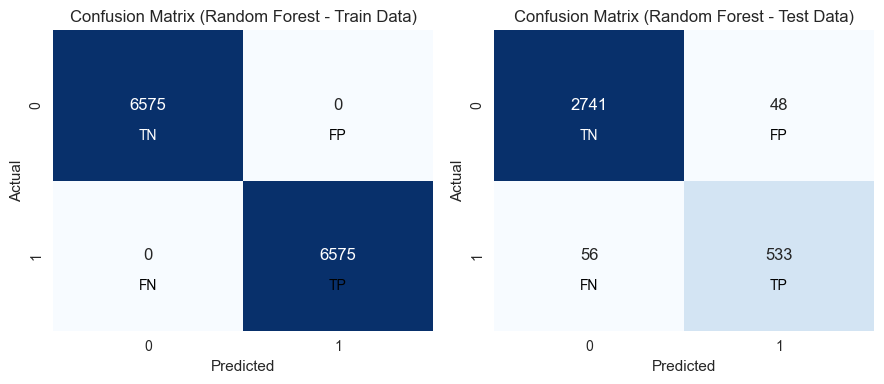

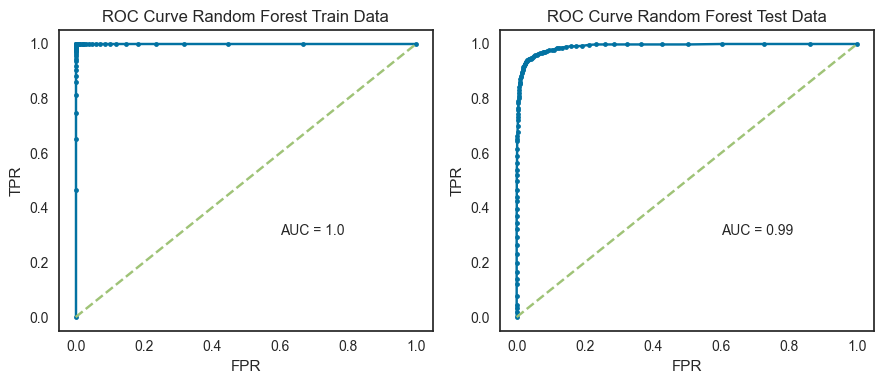

In [136]:
plot_model_evaluation_smote(rfcl, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Random Forest")

Model: Random Forest
Cross-Validation Scores: [0.921673   0.99619772 0.99847909 0.99619772 0.99771863]
Mean CV Score: 0.982
Cross-Validation Variance: 0.001



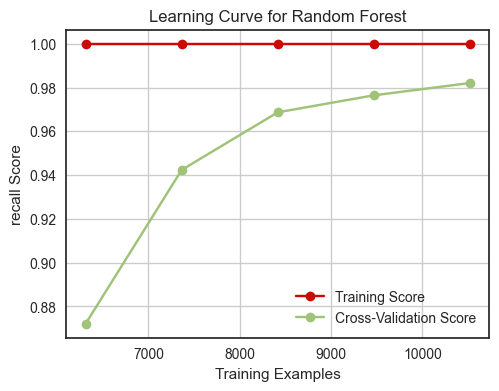

In [137]:
plot_model_learning_curve_smote(rfcl, "Random Forest", X_train_smote, y_train_smote)

In [138]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(rfcl.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Tenure                   0.306464
Complain_ly              0.077165
Day_Since_CC_connect     0.064230
cashback                 0.064109
rev_per_month            0.053144
rev_growth_yoy           0.050550
CC_Agent_Score           0.050038
Account_user_count       0.047952
account_segment          0.045474
CC_Contacted_LY          0.045159
coupon_used_for_payment  0.040414
Marital_Status           0.038159
Payment                  0.037901
Service_Score            0.026964
City_Tier                0.020947
Login_device             0.016638
Gender                   0.014692


# LDA

In [139]:
lda = LinearDiscriminantAnalysis()
lda.fit(X_train_smote, y_train_smote)

LinearDiscriminantAnalysis()

In [140]:
pred_train = lda.predict(X_train_smote)
pred_test = lda.predict(X_test_smote)

In [141]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.79      0.74      0.77      6575
         1.0       0.76      0.80      0.78      6575

    accuracy                           0.77     13150
   macro avg       0.77      0.77      0.77     13150
weighted avg       0.77      0.77      0.77     13150

                   Train data Confusion Matrix
 [[4896 1679]
 [1325 5250]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.94      0.73      0.82      2789
         1.0       0.38      0.78      0.51       589

    accuracy                           0.74      3378
   macro avg       0.66      0.75      0.66      3378
weighted avg       0.84      0.74      0.77      3378

                   Test data Confusion Matrix
 [[2031  758]
 [ 129  460]]


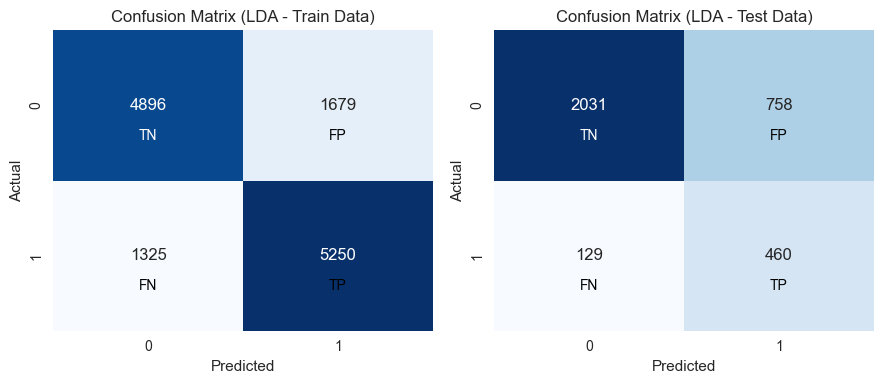

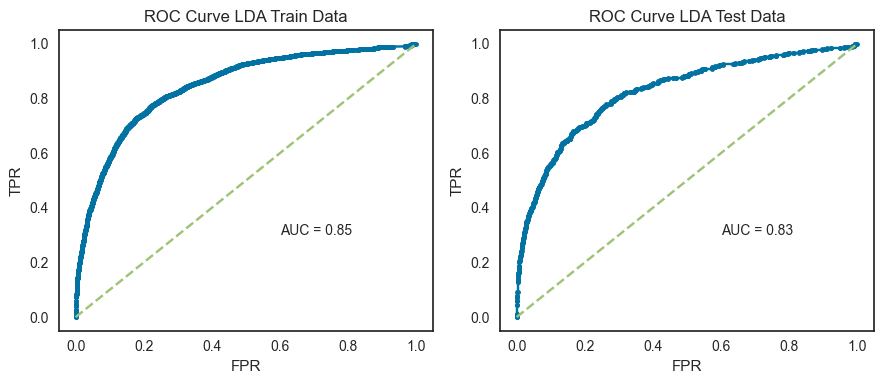

In [142]:
plot_model_evaluation_smote(lda, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "LDA")

Model: LDA
Cross-Validation Scores: [0.78707224 0.80912548 0.80304183 0.79011407 0.79619772]
Mean CV Score: 0.797
Cross-Validation Variance: 0.000



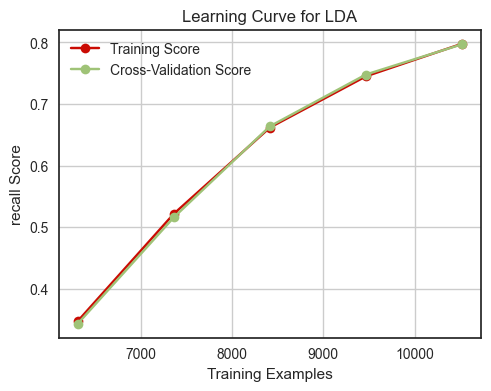

In [143]:
plot_model_learning_curve_smote(lda, "LDA", X_train_smote, y_train_smote)

In [144]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(lda.coef_[0], columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Complain_ly              1.645344
rev_per_month            0.724557
Marital_Status           0.518342
Gender                   0.388392
Account_user_count       0.344449
coupon_used_for_payment  0.301741
City_Tier                0.297146
CC_Agent_Score           0.276090
CC_Contacted_LY          0.254574
Service_Score            0.004196
Payment                 -0.169541
rev_growth_yoy          -0.200951
Login_device            -0.330471
account_segment         -0.352941
Day_Since_CC_connect    -0.495847
Tenure                  -0.682603
cashback                -1.059492


# K-Nearest Neighbors (KNN)

In [145]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 3, weights = 'uniform')

In [146]:
knn.fit(X_train_smote, y_train_smote)

KNeighborsClassifier(n_neighbors=3)

In [147]:
pred_train = knn.predict(X_train_smote)
pred_test = knn.predict(X_test_smote)

In [148]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      0.99      0.99      6575
         1.0       0.99      1.00      0.99      6575

    accuracy                           0.99     13150
   macro avg       0.99      0.99      0.99     13150
weighted avg       0.99      0.99      0.99     13150

                   Train data Confusion Matrix
 [[6503   72]
 [   2 6573]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      0.96      0.98      2789
         1.0       0.85      0.96      0.90       589

    accuracy                           0.96      3378
   macro avg       0.92      0.96      0.94      3378
weighted avg       0.97      0.96      0.96      3378

                   Test data Confusion Matrix
 [[2686  103]
 [  26  563]]


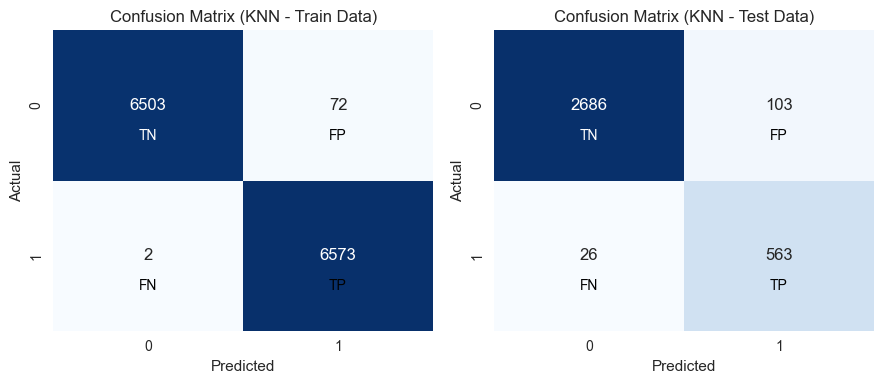

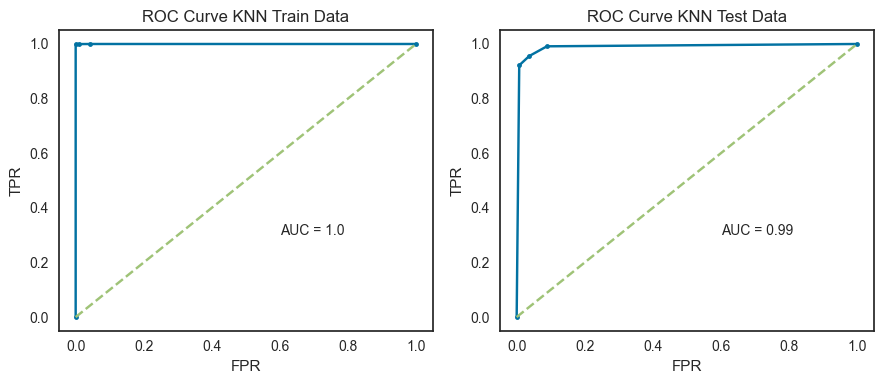

In [149]:
plot_model_evaluation_smote(knn, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "KNN")

Model: KNN
Cross-Validation Scores: [0.99619772 1.         1.         1.         0.99923954]
Mean CV Score: 0.999
Cross-Validation Variance: 0.000



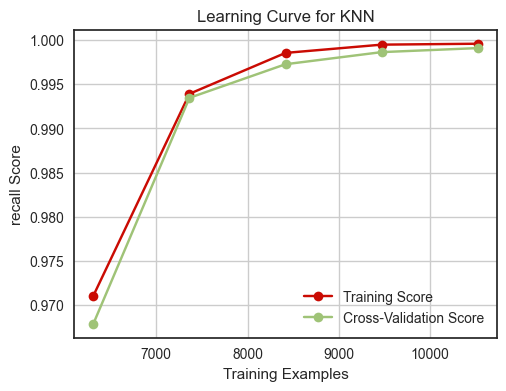

In [150]:
plot_model_learning_curve_smote(knn, "KNN", X_train_smote, y_train_smote)

CC_Agent_Score: 0.1414524714828897
City_Tier: 0.09070722433460074
Payment: 0.08513307984790872
rev_growth_yoy: 0.06888212927756651
account_segment: 0.06467680608365016
CC_Contacted_LY: 0.06205323193916349
Day_Since_CC_connect: 0.05682129277566537
Account_user_count: 0.042098859315589335
coupon_used_for_payment: 0.03603802281368819
Tenure: 0.026646387832699615
Marital_Status: 0.021855513307984752
Service_Score: 0.008479087452471456
Complain_ly: 0.005133079847908728
Gender: 0.004228136882129252
Login_device: 0.0032395437262357054
rev_per_month: 0.000897338403041803
cashback: 0.0004486692015208904


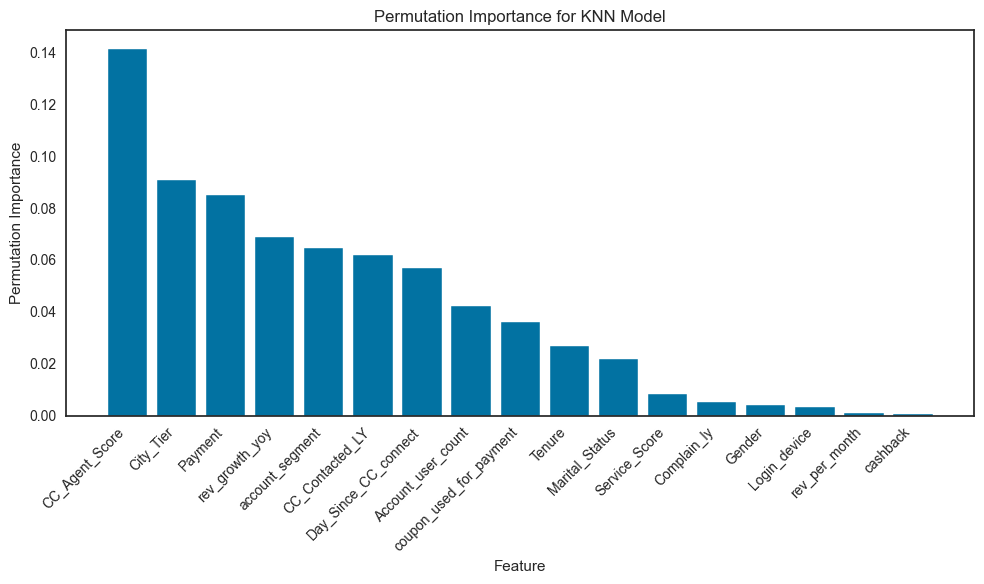

In [258]:
from sklearn.inspection import permutation_importance
# Perform permutation importance
result = permutation_importance(knn, X_train_smote, y_train_smote, n_repeats=10, random_state=42)

# Map feature importances to feature names
feature_names = X_train_smote.columns
feature_importance = dict(zip(feature_names, result.importances_mean))

# Print or sort features by importance
sorted_features = sorted(feature_importance.items(), key=lambda x: abs(x[1]), reverse=True)

# Print or display sorted feature importances
for feature, importance in sorted_features:
    print(f"{feature}: {importance}")

# Optional: Plot sorted feature importances
plt.figure(figsize=(10, 6))
plt.bar([x[0] for x in sorted_features], [x[1] for x in sorted_features], align='center')
plt.xticks(rotation=45, ha='right')
plt.xlabel('Feature')
plt.ylabel('Permutation Importance')
plt.title('Permutation Importance for KNN Model')
plt.tight_layout()
plt.show()

# Naive Bays

In [151]:
#Naive Bayes Classfier
from sklearn.naive_bayes import BernoulliNB

NB_model = BernoulliNB()
NB = NB_model.fit(X_train_smote, y_train_smote)
pred = NB.predict(X_test_smote)
pred_prob = NB.predict_proba(X_test_smote)

In [152]:
pred_train = NB_model.predict(X_train_smote)
pred_test = NB_model.predict(X_test_smote)

In [153]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.77      0.70      0.73      6575
         1.0       0.72      0.79      0.76      6575

    accuracy                           0.75     13150
   macro avg       0.75      0.75      0.74     13150
weighted avg       0.75      0.75      0.74     13150

                   Train data Confusion Matrix
 [[4597 1978]
 [1373 5202]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.93      0.69      0.80      2789
         1.0       0.34      0.76      0.47       589

    accuracy                           0.71      3378
   macro avg       0.64      0.73      0.63      3378
weighted avg       0.83      0.71      0.74      3378

                   Test data Confusion Matrix
 [[1937  852]
 [ 143  446]]


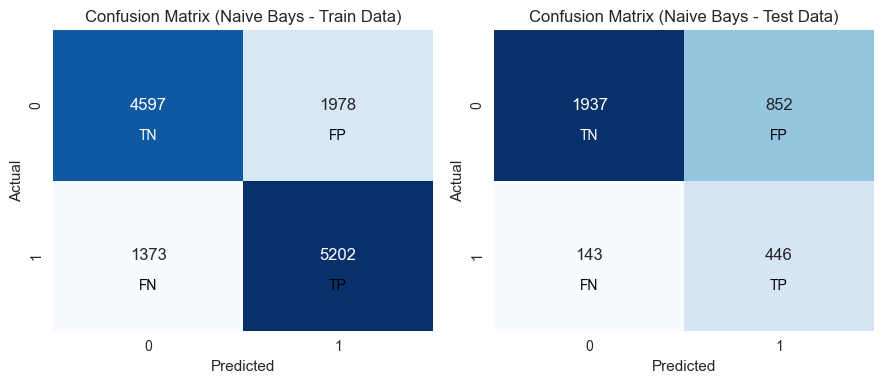

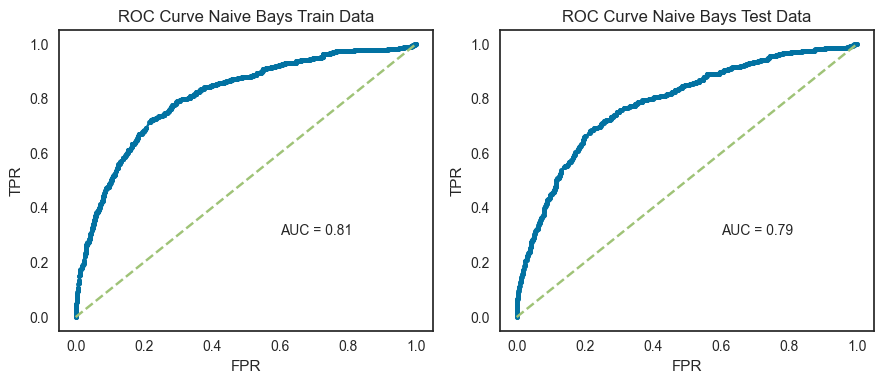

In [154]:
plot_model_evaluation_smote(NB_model, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Naive Bays")

Model: Naive Bays
Cross-Validation Scores: [0.7460076  0.78631179 0.79923954 0.78555133 0.81444867]
Mean CV Score: 0.786
Cross-Validation Variance: 0.001



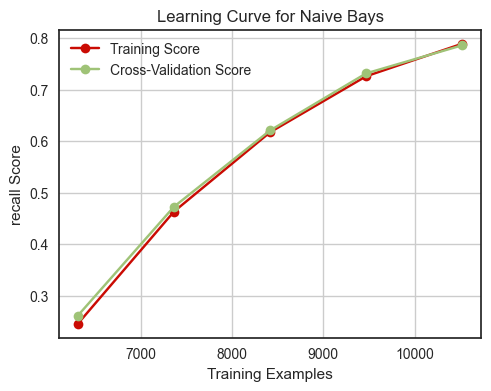

In [155]:
plot_model_learning_curve_smote(NB_model, "Naive Bays", X_train_smote, y_train_smote)

# Logistic Regression

In [156]:
from sklearn.linear_model import LogisticRegression
# Initialize and fit the logistic regression model
logit = LogisticRegression()
logit.fit(X_train_smote, y_train_smote)

LogisticRegression()

In [157]:
# Predictions
pred_train = logit.predict(X_train_smote)
pred_test = logit.predict(X_test_smote)

In [158]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.80      0.77      0.79      6575
         1.0       0.78      0.81      0.79      6575

    accuracy                           0.79     13150
   macro avg       0.79      0.79      0.79     13150
weighted avg       0.79      0.79      0.79     13150

                   Train data Confusion Matrix
 [[5060 1515]
 [1252 5323]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.94      0.76      0.84      2789
         1.0       0.41      0.79      0.54       589

    accuracy                           0.76      3378
   macro avg       0.68      0.77      0.69      3378
weighted avg       0.85      0.76      0.79      3378

                   Test data Confusion Matrix
 [[2109  680]
 [ 124  465]]


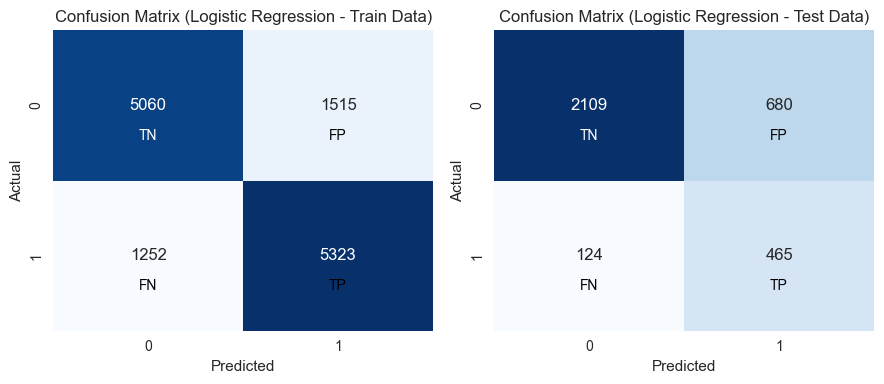

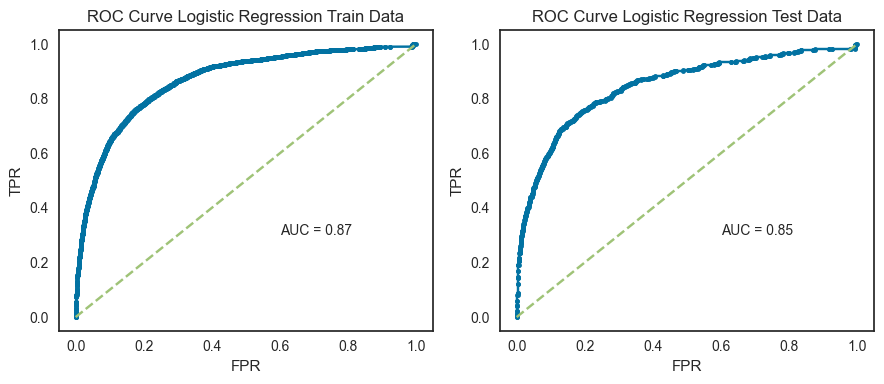

In [159]:
# Plot model evaluation
plot_model_evaluation_smote(logit, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Logistic Regression")

Model: Logistic Regression
Cross-Validation Scores: [0.79467681 0.81064639 0.81977186 0.80608365 0.81140684]
Mean CV Score: 0.809
Cross-Validation Variance: 0.000



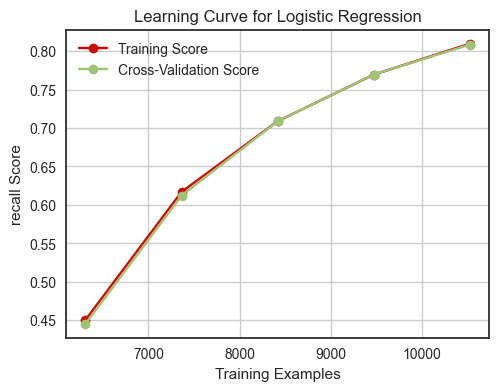

In [160]:
# Plot learning curve
plot_model_learning_curve_smote(logit, "Logistic Regression", X_train_smote, y_train_smote)

In [161]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(logit.coef_[0], columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Complain_ly              1.504698
rev_per_month            0.985187
Marital_Status           0.467312
Gender                   0.395286
coupon_used_for_payment  0.369560
Account_user_count       0.313159
City_Tier                0.283744
CC_Agent_Score           0.264380
CC_Contacted_LY          0.252468
Service_Score            0.015213
Payment                 -0.173849
rev_growth_yoy          -0.189178
Login_device            -0.302245
account_segment         -0.394620
Day_Since_CC_connect    -0.467906
cashback                -0.889380
Tenure                  -1.262873


# Model Tuning- Ensemble methods & Hyperparameter Tuning

# Regularised Decision Tree

# With SMOTE

In [162]:
# Defining the hyperparameter grid with max_depth, min_samples_split, and min_samples_leaf
param_grid = {
    'max_depth': [7, 8, 9, 10, 11, 12],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [163]:
reg_dtcl = DecisionTreeClassifier(random_state=42, criterion='gini')
grid_search = GridSearchCV(reg_dtcl, param_grid, cv=5, scoring='recall')
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_depth': [7, 8, 9, 10, 11, 12],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10]},
             scoring='recall')

In [164]:
# Best hyperparameters
best_max_depth = grid_search.best_params_['max_depth']
best_min_samples_split = grid_search.best_params_['min_samples_split']
best_min_samples_leaf = grid_search.best_params_['min_samples_leaf']

print("Best max_depth:", best_max_depth)
print("Best min_samples_split:", best_min_samples_split)
print("Best min_samples_leaf:", best_min_samples_leaf)

Best max_depth: 12
Best min_samples_split: 2
Best min_samples_leaf: 1


In [165]:
# Create a DecisionTreeClassifier with the best hyperparameters
reg_dtcl = DecisionTreeClassifier(
    max_depth=best_max_depth,
    min_samples_split=best_min_samples_split,
    min_samples_leaf=best_min_samples_leaf,
    random_state=42,
    criterion='gini')

In [166]:
reg_dtcl.fit(X_train_smote, y_train_smote)

DecisionTreeClassifier(max_depth=12, random_state=42)

In [167]:
pred_train = reg_dtcl.predict(X_train_smote)
pred_test = reg_dtcl.predict(X_test_smote)

In [168]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.98      0.98      6575
         1.0       0.98      0.98      0.98      6575

    accuracy                           0.98     13150
   macro avg       0.98      0.98      0.98     13150
weighted avg       0.98      0.98      0.98     13150

                   Train data Confusion Matrix
 [[6458  117]
 [ 135 6440]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.95      0.94      0.95      2789
         1.0       0.73      0.78      0.75       589

    accuracy                           0.91      3378
   macro avg       0.84      0.86      0.85      3378
weighted avg       0.91      0.91      0.91      3378

                   Test data Confusion Matrix
 [[2616  173]
 [ 131  458]]


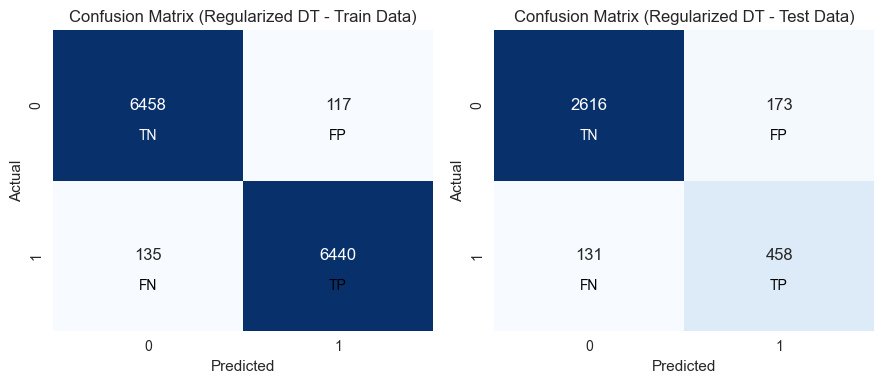

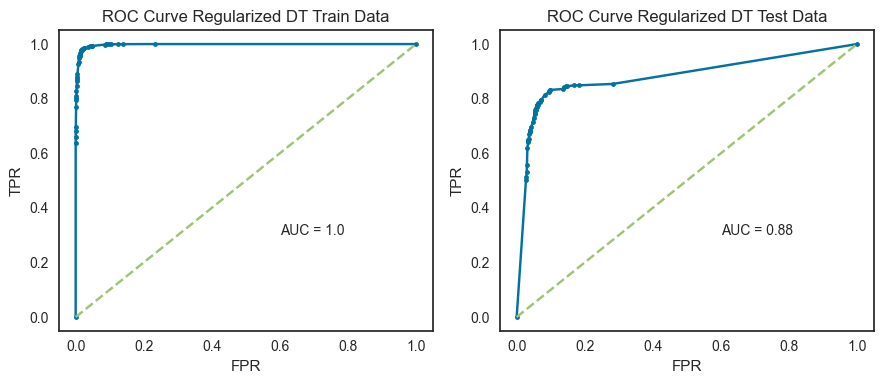

In [169]:
plot_model_evaluation_smote(reg_dtcl, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Regularized DT")

Model: Regularized Decision Tree
Cross-Validation Scores: [0.80684411 0.97490494 0.96806084 0.96882129 0.95589354]
Mean CV Score: 0.935
Cross-Validation Variance: 0.004



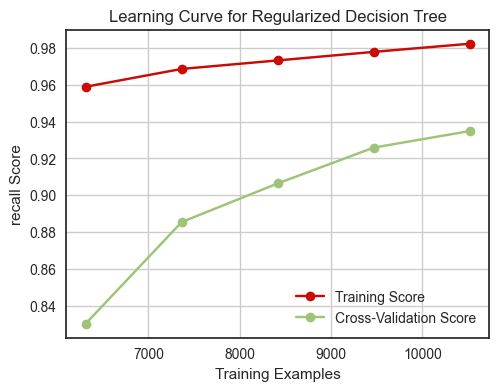

In [170]:
plot_model_learning_curve_smote(reg_dtcl, "Regularized Decision Tree", X_train_smote, y_train_smote)

In [171]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(reg_dtcl.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Tenure                   0.458156
CC_Agent_Score           0.069648
rev_per_month            0.067679
Complain_ly              0.063405
rev_growth_yoy           0.054367
Day_Since_CC_connect     0.049447
Payment                  0.038404
CC_Contacted_LY          0.035825
cashback                 0.034887
coupon_used_for_payment  0.025542
City_Tier                0.023000
Account_user_count       0.022819
account_segment          0.020295
Login_device             0.015896
Marital_Status           0.009378
Service_Score            0.007279
Gender                   0.003973


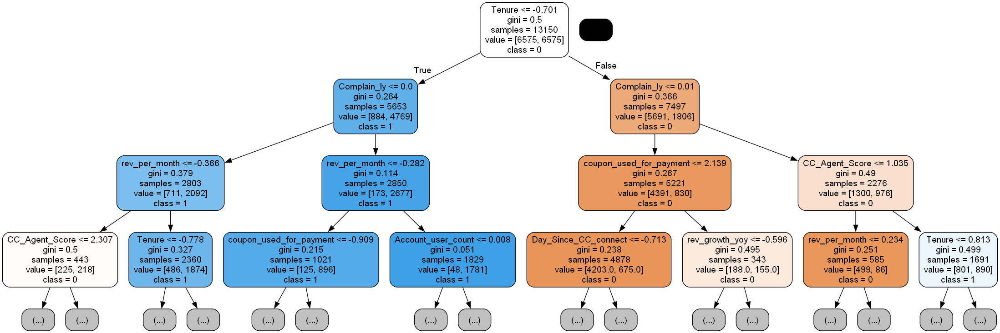

In [172]:
# Define the maximum depth you want to visualize
train_char_label = ['0', '1']

dot_data = tree.export_graphviz(reg_dtcl, out_file=None, feature_names=list(X_train_smote), class_names=train_char_label, filled=True, rounded=True, max_depth=3)
graph = pydotplus.graph_from_dot_data(dot_data)
Image(graph.create_png())

# Bagging

In [173]:
from sklearn.ensemble import BaggingClassifier
bagging_classifier = BaggingClassifier(
    estimator=reg_dtcl,  #  regularized Decision Tree
    n_estimators=10,
    random_state=42
)

In [174]:
bagging_classifier.fit(X_train_smote, y_train_smote)

BaggingClassifier(estimator=DecisionTreeClassifier(max_depth=12,
                                                   random_state=42),
                  random_state=42)

In [175]:
pred_train = bagging_classifier.predict(X_train_smote)
pred_test = bagging_classifier.predict(X_test_smote)

In [176]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.99      0.99      0.99      6575
         1.0       0.99      0.99      0.99      6575

    accuracy                           0.99     13150
   macro avg       0.99      0.99      0.99     13150
weighted avg       0.99      0.99      0.99     13150

                   Train data Confusion Matrix
 [[6504   71]
 [  52 6523]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.95      0.96      2789
         1.0       0.77      0.84      0.80       589

    accuracy                           0.93      3378
   macro avg       0.87      0.89      0.88      3378
weighted avg       0.93      0.93      0.93      3378

                   Test data Confusion Matrix
 [[2645  144]
 [  96  493]]


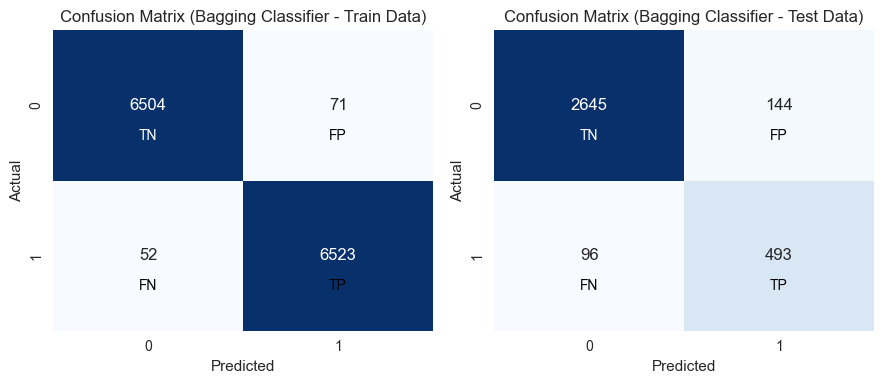

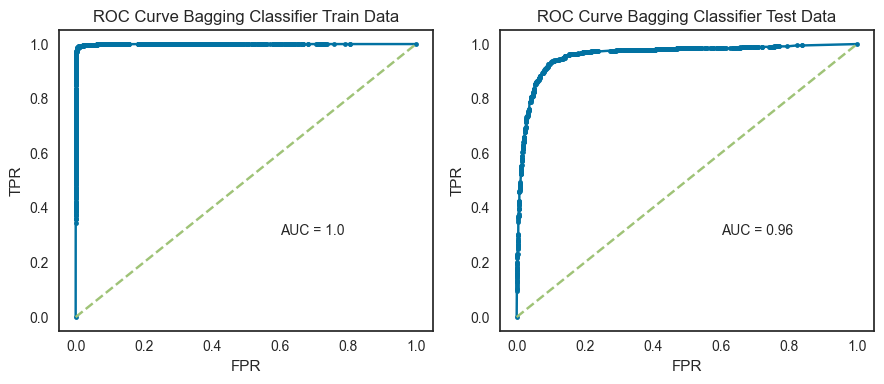

In [177]:
plot_model_evaluation_smote(bagging_classifier, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Bagging Classifier")

Model: Bagging Classifier
Cross-Validation Scores: [0.84410646 0.99011407 0.9878327  0.98098859 0.98707224]
Mean CV Score: 0.958
Cross-Validation Variance: 0.003



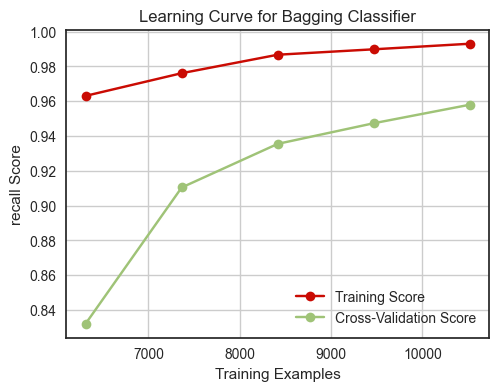

In [178]:
plot_model_learning_curve_smote(bagging_classifier, "Bagging Classifier", X_train_smote, y_train_smote)

# Tuned LDA

In [179]:
#Discriminant Analysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

param_grid = {'solver': ['lsqr', 'eigen', 'svd'],
              'tol': [0.1, 0.01, 0.001]
              }
model = LinearDiscriminantAnalysis()
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='recall')

In [180]:
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=5, estimator=LinearDiscriminantAnalysis(),
             param_grid={'solver': ['lsqr', 'eigen', 'svd'],
                         'tol': [0.1, 0.01, 0.001]},
             scoring='recall')

In [181]:
grid_search.best_params_

{'solver': 'lsqr', 'tol': 0.1}

In [182]:
best_lda = grid_search.best_estimator_

In [183]:
Y_train_tlda = best_lda.predict(X_train_smote)
Y_test_tlda = best_lda.predict(X_test_smote)

In [184]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, Y_train_tlda))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, Y_train_tlda))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, Y_test_tlda))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, Y_test_tlda))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.79      0.74      0.77      6575
         1.0       0.76      0.80      0.78      6575

    accuracy                           0.77     13150
   macro avg       0.77      0.77      0.77     13150
weighted avg       0.77      0.77      0.77     13150

                   Train data Confusion Matrix
 [[4896 1679]
 [1325 5250]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.94      0.73      0.82      2789
         1.0       0.38      0.78      0.51       589

    accuracy                           0.74      3378
   macro avg       0.66      0.75      0.66      3378
weighted avg       0.84      0.74      0.77      3378

                   Test data Confusion Matrix
 [[2031  758]
 [ 129  460]]


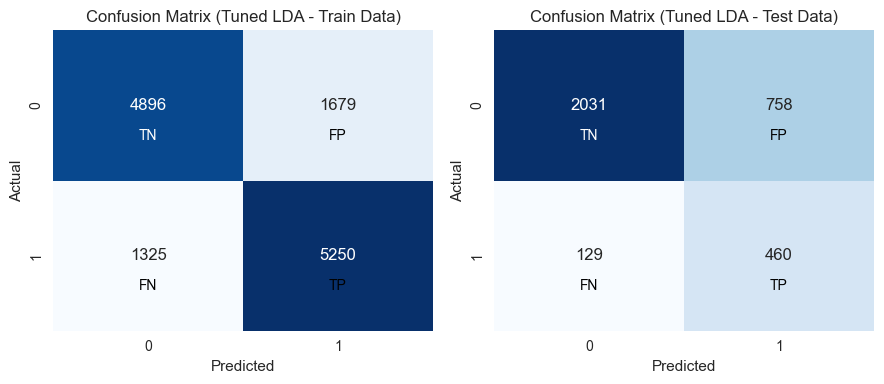

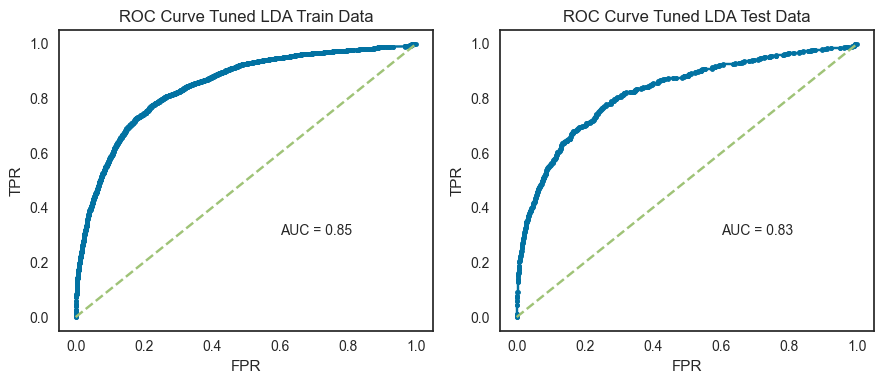

In [185]:
plot_model_evaluation_smote(best_lda, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Tuned LDA")

Model: Tuned LDA
Cross-Validation Scores: [0.78707224 0.80912548 0.80304183 0.79011407 0.79619772]
Mean CV Score: 0.797
Cross-Validation Variance: 0.000



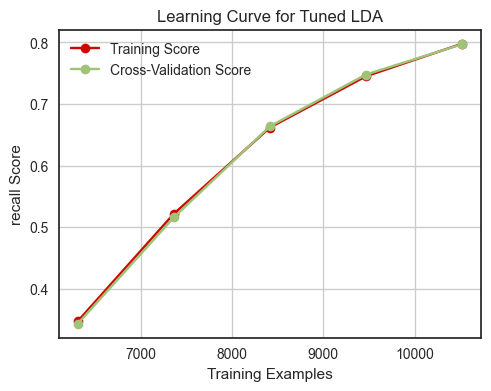

In [186]:
plot_model_learning_curve_smote(best_lda, "Tuned LDA", X_train_smote, y_train_smote)

In [187]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(best_lda.coef_[0], columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Complain_ly              1.645594
rev_per_month            0.724667
Marital_Status           0.518421
Gender                   0.388451
Account_user_count       0.344501
coupon_used_for_payment  0.301786
City_Tier                0.297191
CC_Agent_Score           0.276132
CC_Contacted_LY          0.254613
Service_Score            0.004197
Payment                 -0.169567
rev_growth_yoy          -0.200981
Login_device            -0.330521
account_segment         -0.352995
Day_Since_CC_connect    -0.495923
Tenure                  -0.682707
cashback                -1.059654


# Random Forest with Tuning

In [188]:
# Random Forest model
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

# Defining the hyperparameter grid

param_grid = {
    'max_depth': [4, 5, 6, 7],
    'max_features': [1, 2, 3],
    'min_samples_leaf': [1, 2, 3],
    'min_samples_split': [6, 8, 10],
    'n_estimators': [101, 301, 501],
    'random_state': [42]
}
rfcl = RandomForestClassifier()
grid_search = GridSearchCV(estimator=rfcl, param_grid=param_grid, cv=5, n_jobs=-1)
grid_search.fit(X_train_smote, y_train_smote)

# Get the best hyperparameters
best_params = grid_search.best_params_
print(best_params)

{'max_depth': 7, 'max_features': 1, 'min_samples_leaf': 1, 'min_samples_split': 8, 'n_estimators': 301, 'random_state': 42}


{'max_depth': 7, 'max_features': 1, 'min_samples_leaf': 1, 'min_samples_split': 8, 'n_estimators': 301, 'random_state': 42}

In [189]:
param_grid = {'max_depth': [7],
              'max_features': [1],
              'min_samples_leaf': [1],
              'min_samples_split': [8],
              'n_estimators': [301],
              'class_weight' : ['balanced']
              }
model = RandomForestClassifier(random_state = 42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall',  n_jobs=-1)

In [190]:
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=5, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'class_weight': ['balanced'], 'max_depth': [7],
                         'max_features': [1], 'min_samples_leaf': [1],
                         'min_samples_split': [8], 'n_estimators': [301]},
             scoring='recall')

In [191]:
grid_search.best_params_

{'class_weight': 'balanced',
 'max_depth': 7,
 'max_features': 1,
 'min_samples_leaf': 1,
 'min_samples_split': 8,
 'n_estimators': 301}

In [192]:
trf_smote = grid_search.best_estimator_

In [193]:
pred_train = trf_smote.predict(X_train_smote)
pred_test = trf_smote.predict(X_test_smote)

In [194]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.91      0.92      0.91      6575
         1.0       0.92      0.91      0.91      6575

    accuracy                           0.91     13150
   macro avg       0.91      0.91      0.91     13150
weighted avg       0.91      0.91      0.91     13150

                   Train data Confusion Matrix
 [[6050  525]
 [ 600 5975]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.95      0.92      0.93      2789
         1.0       0.66      0.78      0.72       589

    accuracy                           0.89      3378
   macro avg       0.81      0.85      0.82      3378
weighted avg       0.90      0.89      0.90      3378

                   Test data Confusion Matrix
 [[2554  235]
 [ 130  459]]


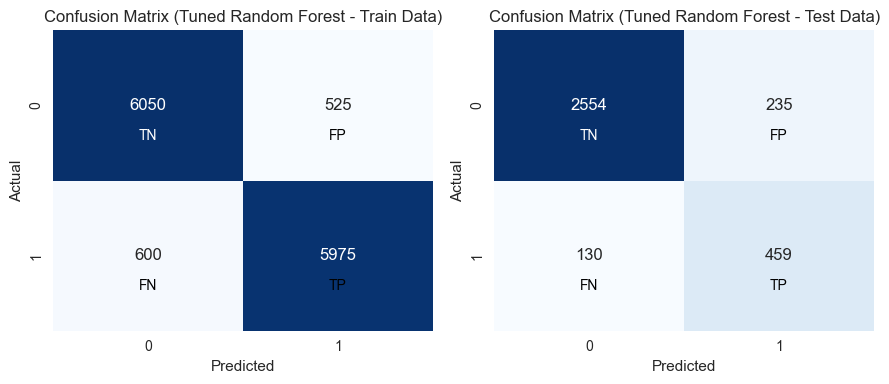

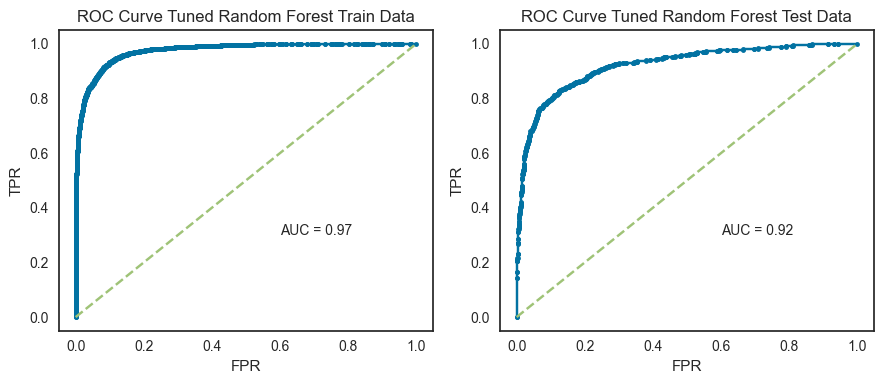

In [195]:
plot_model_evaluation_smote(trf_smote, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Tuned Random Forest")

Model: Tuned Random Forest
Cross-Validation Scores: [0.79315589 0.92471483 0.93307985 0.91558935 0.93079848]
Mean CV Score: 0.899
Cross-Validation Variance: 0.003



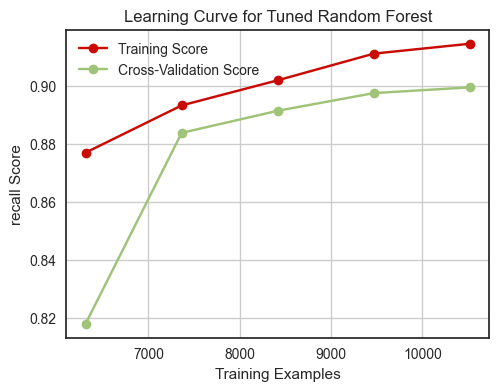

In [196]:
plot_model_learning_curve_smote(trf_smote, "Tuned Random Forest", X_train_smote, y_train_smote)

In [197]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(trf_smote.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Tenure                   0.293865
Complain_ly              0.089767
Day_Since_CC_connect     0.075501
cashback                 0.066465
account_segment          0.064492
Marital_Status           0.058381
coupon_used_for_payment  0.044827
Account_user_count       0.044469
Service_Score            0.039619
rev_per_month            0.039113
rev_growth_yoy           0.037453
CC_Agent_Score           0.034056
CC_Contacted_LY          0.033663
Payment                  0.026938
City_Tier                0.018718
Login_device             0.018067
Gender                   0.014607


# Tuned Logit

In [198]:
# Define the parameter grid
param_grid = {
    'penalty': ['l1', 'l2', 'elasticnet', 'none'],
    'C': [0.1, 1, 10, 100, 1000],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
    'max_iter': [100, 200, 300]
}

In [199]:
# Initialize logistic regression model
logit = LogisticRegression()

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=logit, param_grid=param_grid, cv=5, scoring='recall', verbose=1, n_jobs=-1)

# Fit GridSearchCV
grid_search.fit(X_train_smote, y_train_smote)

Fitting 5 folds for each of 300 candidates, totalling 1500 fits


GridSearchCV(cv=5, estimator=LogisticRegression(), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10, 100, 1000],
                         'max_iter': [100, 200, 300],
                         'penalty': ['l1', 'l2', 'elasticnet', 'none'],
                         'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag',
                                    'saga']},
             scoring='recall', verbose=1)

In [200]:
# Print best parameters and best score
print("Best Parameters:", grid_search.best_params_)
print("Best Recall Score:", grid_search.best_score_)

# Get the best model
best_logit = grid_search.best_estimator_

Best Parameters: {'C': 0.1, 'max_iter': 100, 'penalty': 'l2', 'solver': 'liblinear'}
Best Recall Score: 0.8149049429657795


In [201]:
# Predictions
pred_train = best_logit.predict(X_train_smote)
pred_test = best_logit.predict(X_test_smote)

In [202]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.81      0.76      0.78      6575
         1.0       0.78      0.82      0.79      6575

    accuracy                           0.79     13150
   macro avg       0.79      0.79      0.79     13150
weighted avg       0.79      0.79      0.79     13150

                   Train data Confusion Matrix
 [[5023 1552]
 [1215 5360]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.94      0.76      0.84      2789
         1.0       0.41      0.79      0.54       589

    accuracy                           0.76      3378
   macro avg       0.68      0.77      0.69      3378
weighted avg       0.85      0.76      0.79      3378

                   Test data Confusion Matrix
 [[2113  676]
 [ 124  465]]


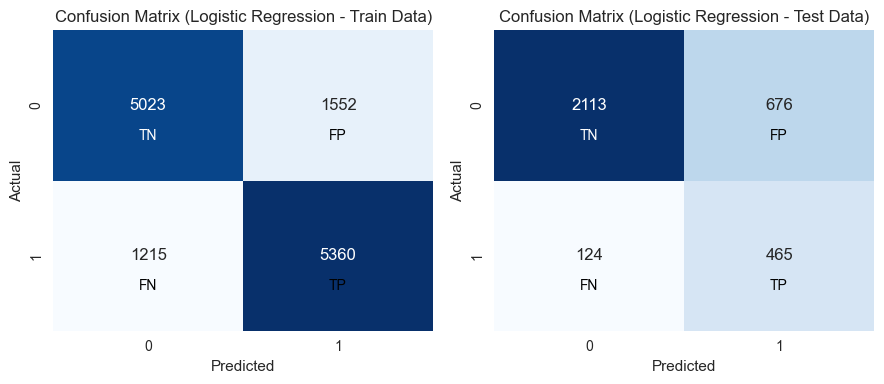

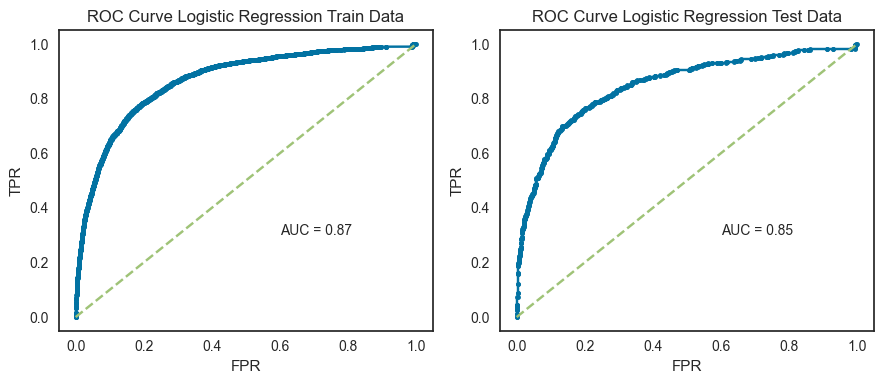

In [203]:
# Plot model evaluation
plot_model_evaluation_smote(best_logit, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Logistic Regression")

Model: Logistic Regression
Cross-Validation Scores: [0.79771863 0.81901141 0.82585551 0.81368821 0.81825095]
Mean CV Score: 0.815
Cross-Validation Variance: 0.000



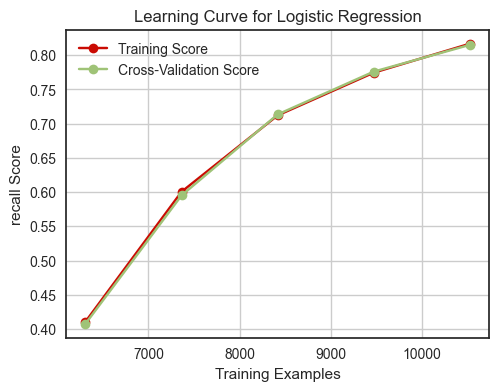

In [204]:
# Plot learning curve
plot_model_learning_curve_smote(best_logit, "Logistic Regression", X_train_smote, y_train_smote)

In [205]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(best_logit.coef_[0], columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Complain_ly              1.446763
rev_per_month            0.932148
Marital_Status           0.432121
coupon_used_for_payment  0.361403
Gender                   0.353418
Account_user_count       0.290638
City_Tier                0.272706
CC_Agent_Score           0.250499
CC_Contacted_LY          0.250275
Service_Score           -0.035645
rev_growth_yoy          -0.179492
Payment                 -0.181934
Login_device            -0.328045
account_segment         -0.401052
Day_Since_CC_connect    -0.465703
cashback                -0.796509
Tenure                  -1.240932


# Adaboost

In [206]:
from sklearn.ensemble import AdaBoostClassifier
from xgboost import XGBClassifier

In [207]:
param_grid = {'n_estimators': [50, 100, 200, 301, 501]}
model = AdaBoostClassifier(estimator=reg_dtcl, random_state=42)
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=10, scoring='recall', n_jobs=-1)

In [208]:
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=10,
             estimator=AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=12,
                                                                           random_state=42),
                                          random_state=42),
             n_jobs=-1, param_grid={'n_estimators': [50, 100, 200, 301, 501]},
             scoring='recall')

In [209]:
grid_search.best_params_

{'n_estimators': 100}

In [210]:
abcl = grid_search.best_estimator_

In [211]:
pred_train = abcl.predict(X_train_smote)
pred_test = abcl.predict(X_test_smote)

In [212]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      6575
         1.0       1.00      1.00      1.00      6575

    accuracy                           1.00     13150
   macro avg       1.00      1.00      1.00     13150
weighted avg       1.00      1.00      1.00     13150

                   Train data Confusion Matrix
 [[6575    0]
 [   0 6575]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.99      0.98      2789
         1.0       0.97      0.88      0.92       589

    accuracy                           0.97      3378
   macro avg       0.97      0.94      0.95      3378
weighted avg       0.97      0.97      0.97      3378

                   Test data Confusion Matrix
 [[2771   18]
 [  68  521]]


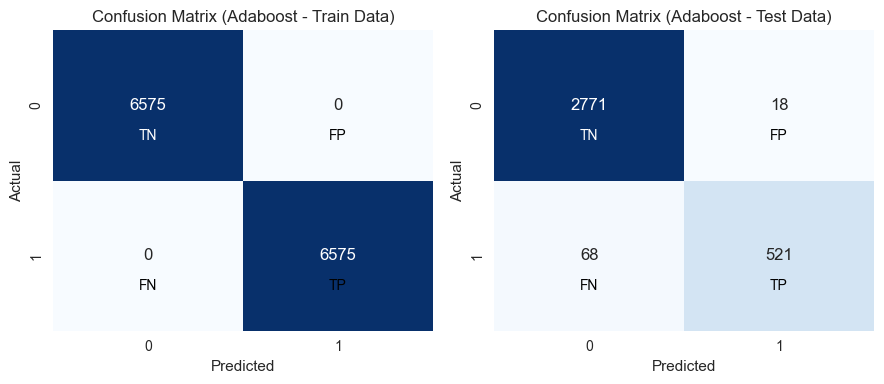

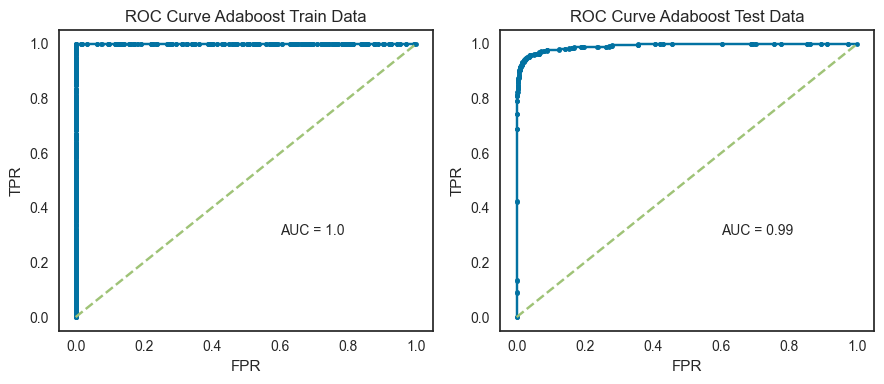

In [213]:
plot_model_evaluation_smote(abcl, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Adaboost")

Model: Adaboost
Cross-Validation Scores: [0.92623574 0.99923954 1.         0.99923954 1.        ]
Mean CV Score: 0.985
Cross-Validation Variance: 0.001



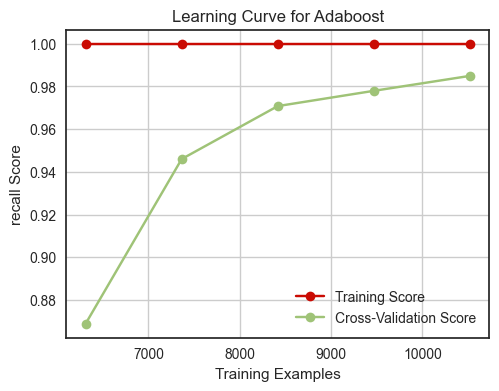

In [214]:
plot_model_learning_curve_smote(abcl, "Adaboost", X_train_smote, y_train_smote)

In [215]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(abcl.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
rev_growth_yoy           0.127147
CC_Contacted_LY          0.117519
cashback                 0.112058
Day_Since_CC_connect     0.105633
Tenure                   0.079100
rev_per_month            0.078046
Complain_ly              0.063981
coupon_used_for_payment  0.062841
Marital_Status           0.055312
CC_Agent_Score           0.052890
Account_user_count       0.031710
Payment                  0.030706
Service_Score            0.022557
Login_device             0.020395
Gender                   0.014039
City_Tier                0.013925
account_segment          0.012139


# XGBoost with Hyperparameter Tuning

In [216]:
#Parameters to find best params
param_grid = {
    'learning_rate': [0.2, 0.1, 0.05],
    'max_depth': [6, 8, 10],
    'colsample_bytree': [0.9, 0.8, 0.7],
    'colsample_bynode': [1, 0.9],
    'colsample_bylevel': [0.9, 0.8],
    'scale_pos_weight': [0.2, 0.4],
    'subsample': [0.9, 0.8, 0.7],
    'gamma': [0, 0.5, 1],
}

model = XGBClassifier(random_state = 42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall', n_jobs=-1)

In [217]:
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=42, ...),
             n_jobs=-1,
             param_grid={'colsample_bylevel': [0.9, 0.8],
                         'colsample_bynode': [1, 0.9],
                         'colsample_bytree': [0.9, 0.8, 0.7],
                         'gamma': [0, 0.5, 1],
                         'learning_rate': [0.2, 0.1, 0.05],
                         'max_depth': [6, 8, 10],
                         'scale_pos_weight': [0.2, 0.4],
                         'subsample': [0.9, 0.8, 0.7]},
             scoring='recall')

In [218]:
grid_search.best_params_

{'colsample_bylevel': 0.8,
 'colsample_bynode': 0.9,
 'colsample_bytree': 0.9,
 'gamma': 0,
 'learning_rate': 0.1,
 'max_depth': 10,
 'scale_pos_weight': 0.4,
 'subsample': 0.9}

In [219]:
best_xgb = grid_search.best_estimator_

In [220]:
pred_train = best_xgb.predict(X_train_smote)
pred_test = best_xgb.predict(X_test_smote)

In [221]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      6575
         1.0       1.00      1.00      1.00      6575

    accuracy                           1.00     13150
   macro avg       1.00      1.00      1.00     13150
weighted avg       1.00      1.00      1.00     13150

                   Train data Confusion Matrix
 [[6575    0]
 [  21 6554]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.99      0.98      2789
         1.0       0.95      0.83      0.88       589

    accuracy                           0.96      3378
   macro avg       0.96      0.91      0.93      3378
weighted avg       0.96      0.96      0.96      3378

                   Test data Confusion Matrix
 [[2761   28]
 [ 101  488]]


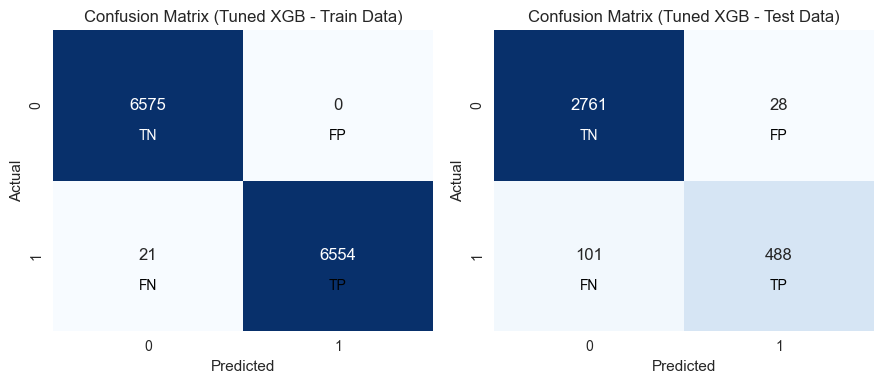

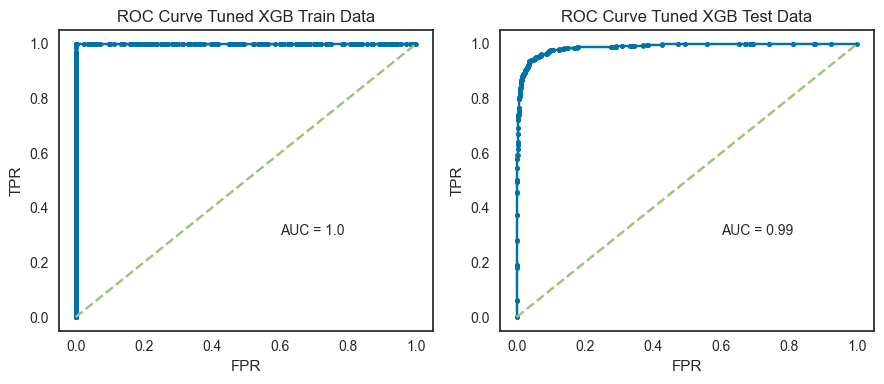

In [222]:
plot_model_evaluation_smote(best_xgb, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Tuned XGB")

Model: Tuned XGB
Cross-Validation Scores: [0.79239544 0.99771863 1.         0.99771863 0.99923954]
Mean CV Score: 0.957
Cross-Validation Variance: 0.007



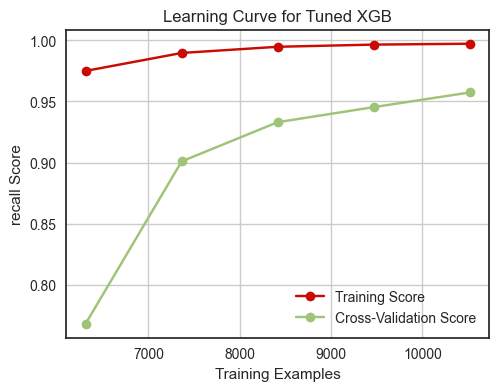

In [223]:
plot_model_learning_curve_smote(best_xgb, "Tuned XGB", X_train_smote, y_train_smote)

In [224]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(best_xgb.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                              Imp
Tenure                   0.216515
Complain_ly              0.214166
account_segment          0.070805
Account_user_count       0.048207
Login_device             0.047651
rev_per_month            0.045492
CC_Agent_Score           0.042610
City_Tier                0.041969
Day_Since_CC_connect     0.041380
Payment                  0.036921
coupon_used_for_payment  0.033946
Service_Score            0.033051
Marital_Status           0.032986
Gender                   0.025331
rev_growth_yoy           0.024200
CC_Contacted_LY          0.022900
cashback                 0.021869


# CatBoost with Hyperparameter Tuning

In [225]:
from catboost import CatBoostClassifier

param_grid = {
    'depth': [6, 8, 10],
    'learning_rate': [0.1, 0.05, 0.01],
    'iterations': [100, 200, 300],
    'l2_leaf_reg': [3, 5, 7],
}
catboost_model = CatBoostClassifier(random_state=42, verbose=0)
grid_search = GridSearchCV(catboost_model, param_grid, cv=5, scoring='recall', n_jobs=-1)

In [226]:
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x0000024264E6C8C0>,
             n_jobs=-1,
             param_grid={'depth': [6, 8, 10], 'iterations': [100, 200, 300],
                         'l2_leaf_reg': [3, 5, 7],
                         'learning_rate': [0.1, 0.05, 0.01]},
             scoring='recall')

In [227]:
grid_search.best_params_

{'depth': 10, 'iterations': 200, 'l2_leaf_reg': 3, 'learning_rate': 0.05}

In [228]:
best_catboost = grid_search.best_estimator_

In [229]:
best_catboost.fit(X_train_smote, y_train_smote)

In [230]:
pred_train = best_catboost.predict(X_train_smote)
pred_test = best_catboost.predict(X_test_smote)

In [231]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      6575
         1.0       1.00      1.00      1.00      6575

    accuracy                           1.00     13150
   macro avg       1.00      1.00      1.00     13150
weighted avg       1.00      1.00      1.00     13150

                   Train data Confusion Matrix
 [[6574    1]
 [   1 6574]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.99      0.98      2789
         1.0       0.95      0.91      0.93       589

    accuracy                           0.97      3378
   macro avg       0.96      0.95      0.96      3378
weighted avg       0.97      0.97      0.97      3378

                   Test data Confusion Matrix
 [[2758   31]
 [  54  535]]


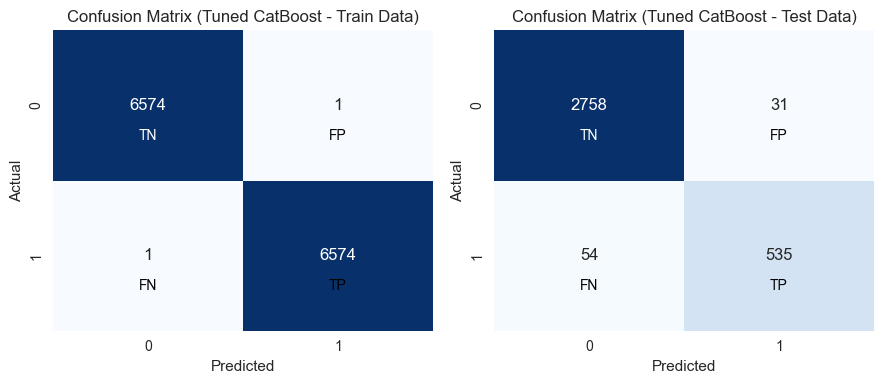

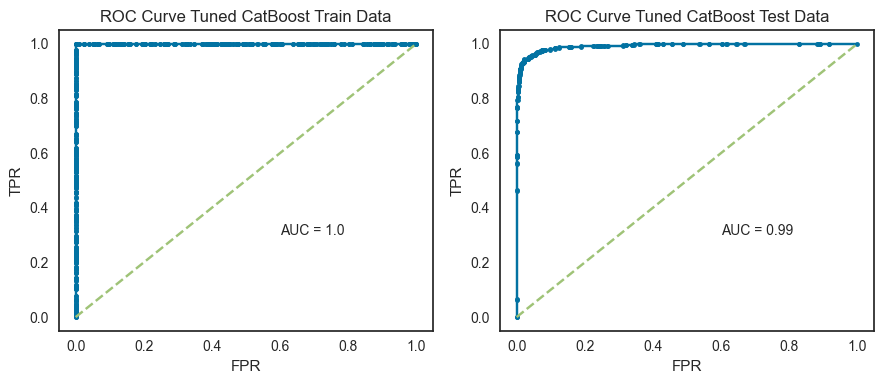

In [232]:
plot_model_evaluation_smote(best_catboost, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Tuned CatBoost")

Model: Tuned CatBoost
Cross-Validation Scores: [0.89277567 0.99847909 1.         0.99923954 0.99923954]
Mean CV Score: 0.978
Cross-Validation Variance: 0.002



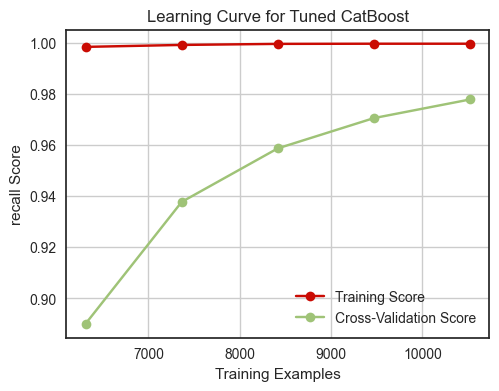

In [233]:
plot_model_learning_curve_smote(best_catboost, "Tuned CatBoost", X_train_smote, y_train_smote)

In [234]:
# Create the DataFrame for feature importances
feature_importance_df = pd.DataFrame(best_catboost.feature_importances_, columns=["Imp"], index=X_train_smote.columns)

# Sort the DataFrame by feature importances in descending order
sorted_feature_importance_df = feature_importance_df.sort_values(by="Imp", ascending=False)

# Print the sorted DataFrame
print(sorted_feature_importance_df)

                               Imp
Tenure                   14.933099
CC_Agent_Score            9.186420
Complain_ly               8.746497
Marital_Status            6.512211
Day_Since_CC_connect      6.432569
rev_growth_yoy            5.459310
account_segment           5.401589
Payment                   5.392603
rev_per_month             5.349482
City_Tier                 5.174698
coupon_used_for_payment   5.111868
Gender                    4.726957
Login_device              4.244853
CC_Contacted_LY           3.939592
Account_user_count        3.792719
cashback                  2.868297
Service_Score             2.727236


# Neural Network (ANN)

In [235]:
from sklearn.neural_network import MLPClassifier
ann = MLPClassifier(hidden_layer_sizes = (50, 1), random_state = 42, max_iter = 1000, activation = 'relu', solver = 'adam', tol = 0.00001)
ann.fit(X_train_smote, y_train_smote)

MLPClassifier(hidden_layer_sizes=(50, 1), max_iter=1000, random_state=42,
              tol=1e-05)

In [236]:
pred_train = ann.predict(X_train_smote)
pred_test = ann.predict(X_test_smote)

In [237]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       0.92      0.99      0.96      6575
         1.0       0.99      0.91      0.95      6575

    accuracy                           0.95     13150
   macro avg       0.96      0.95      0.95     13150
weighted avg       0.96      0.95      0.95     13150

                   Train data Confusion Matrix
 [[6537   38]
 [ 568 6007]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.96      0.97      0.97      2789
         1.0       0.87      0.79      0.83       589

    accuracy                           0.94      3378
   macro avg       0.91      0.88      0.90      3378
weighted avg       0.94      0.94      0.94      3378

                   Test data Confusion Matrix
 [[2719   70]
 [ 124  465]]


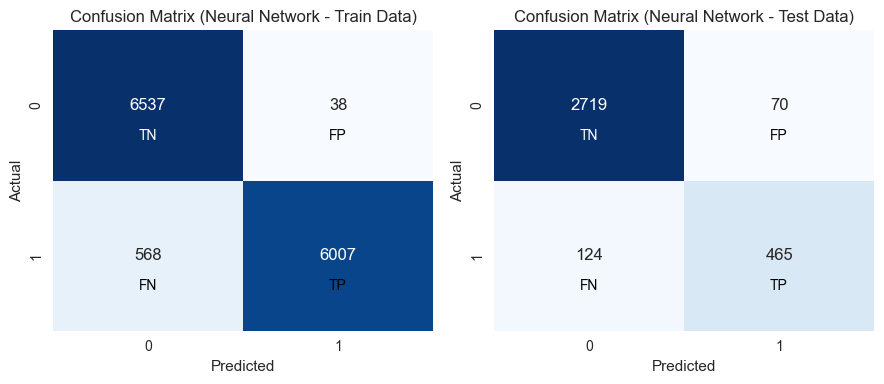

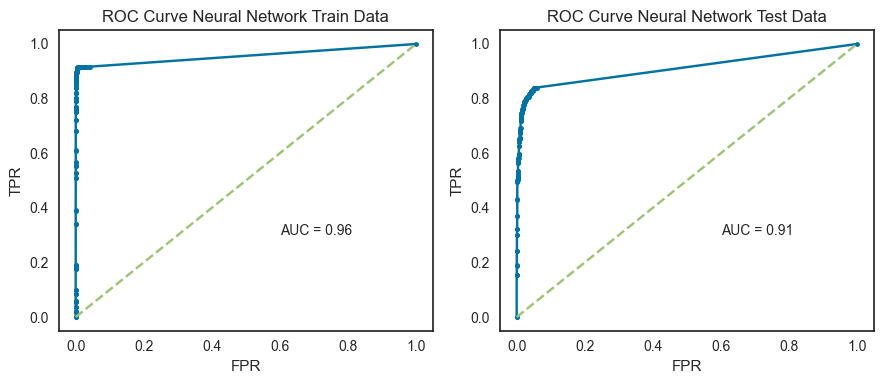

In [238]:
plot_model_evaluation_smote(ann, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "Neural Network")

Model: Neural Network
Cross-Validation Scores: [0.89125475 0.90798479 0.8973384  0.90190114 0.92319392]
Mean CV Score: 0.904
Cross-Validation Variance: 0.000



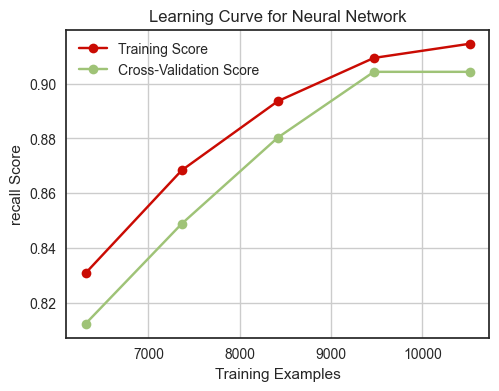

In [239]:
plot_model_learning_curve_smote(ann, "Neural Network", X_train_smote, y_train_smote)

# SVM

In [240]:
from sklearn.svm import SVC
param_grid = {
    'C': [0.1, 1, 10],
    'gamma': [0.01, 0.1, 1],
    'kernel': ['rbf', 'poly'],
    'class_weight': ['balanced']
}

model = SVC(probability = True, random_state =  42)
grid_search = GridSearchCV(estimator = model, param_grid = param_grid, cv = 5, scoring = 'recall',  n_jobs=-1)

In [241]:
grid_search.fit(X_train_smote, y_train_smote)

GridSearchCV(cv=5, estimator=SVC(probability=True, random_state=42), n_jobs=-1,
             param_grid={'C': [0.1, 1, 10], 'class_weight': ['balanced'],
                         'gamma': [0.01, 0.1, 1], 'kernel': ['rbf', 'poly']},
             scoring='recall')

In [242]:
grid_search.best_params_

{'C': 10, 'class_weight': 'balanced', 'gamma': 0.1, 'kernel': 'rbf'}

In [243]:
svm = grid_search.best_estimator_

In [244]:
pred_train = svm.predict(X_train_smote)
pred_test = svm.predict(X_test_smote)

In [245]:
# Train set Classification Report
print("                   Train data Classification Report\n", classification_report(y_train_smote, pred_train))
# Train set Confusion Matrix
print("                   Train data Confusion Matrix\n", confusion_matrix(y_train_smote, pred_train))
# Test set Classification Report
print("                   Test data Classification Report\n", classification_report(y_test_smote, pred_test))
# Test set Confusion Matrix
print("                   Test data Confusion Matrix\n", confusion_matrix(y_test_smote, pred_test))

                   Train data Classification Report
               precision    recall  f1-score   support

         0.0       1.00      0.99      1.00      6575
         1.0       0.99      1.00      1.00      6575

    accuracy                           1.00     13150
   macro avg       1.00      1.00      1.00     13150
weighted avg       1.00      1.00      1.00     13150

                   Train data Confusion Matrix
 [[6535   40]
 [   4 6571]]
                   Test data Classification Report
               precision    recall  f1-score   support

         0.0       0.98      0.98      0.98      2789
         1.0       0.92      0.92      0.92       589

    accuracy                           0.97      3378
   macro avg       0.95      0.95      0.95      3378
weighted avg       0.97      0.97      0.97      3378

                   Test data Confusion Matrix
 [[2740   49]
 [  45  544]]


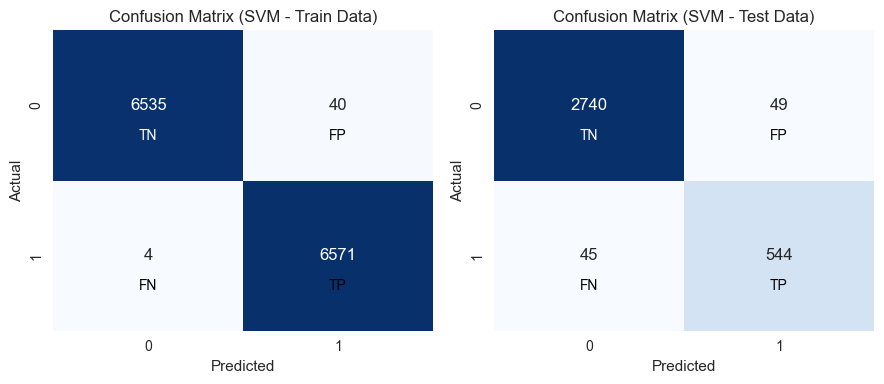

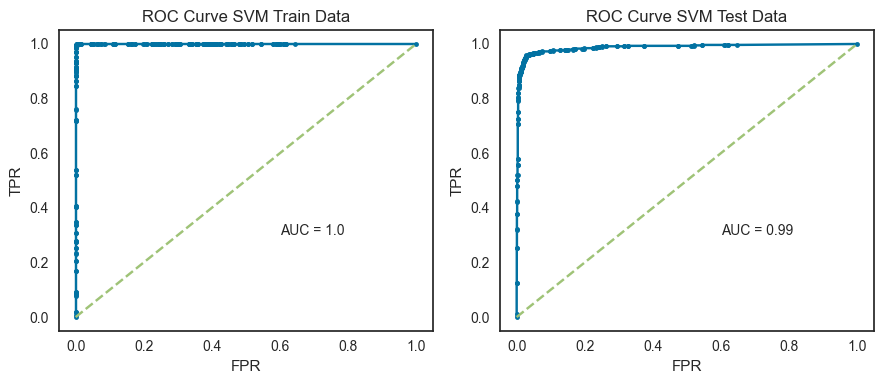

In [246]:
plot_model_evaluation_smote(svm, X_train_smote, y_train_smote, X_test_smote, y_test_smote, "SVM")

Model: SVM
Cross-Validation Scores: [0.99543726 0.99923954 0.99923954 1.         0.99923954]
Mean CV Score: 0.999
Cross-Validation Variance: 0.000



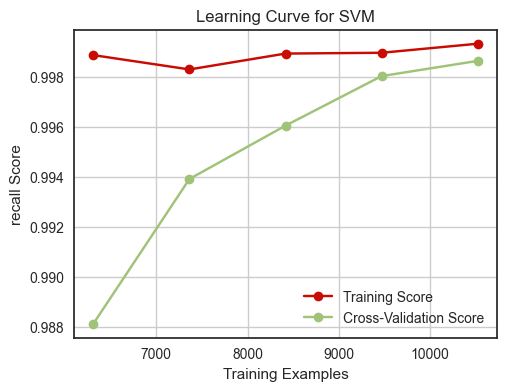

In [247]:
plot_model_learning_curve_smote(svm, "SVM", X_train_smote, y_train_smote)

In [248]:
from sklearn.inspection import permutation_importance

result = permutation_importance(svm, X_train_smote, y_train_smote, n_repeats=10, random_state=42)

# Map feature importances to feature names
feature_names = X_train_smote.columns
feature_importance = dict(zip(feature_names, result.importances_mean))

# Print or sort features by importance
sorted_features = sorted(feature_importance.items(), key=lambda x: abs(x[1]), reverse=True)

# Print or display sorted feature importances
for feature, importance in sorted_features:
    print(f"{feature}: {importance}")

Tenure: 0.1614980988593156
CC_Agent_Score: 0.13028136882129285
account_segment: 0.1052091254752852
City_Tier: 0.1016577946768061
Day_Since_CC_connect: 0.09539923954372624
Complain_ly: 0.09409885931558938
Payment: 0.08888973384030421
rev_growth_yoy: 0.07668441064638784
CC_Contacted_LY: 0.06851711026615973
Account_user_count: 0.05492775665399241
coupon_used_for_payment: 0.04268441064638785
Gender: 0.04047148288973388
Marital_Status: 0.03968821292775669
Service_Score: 0.029368821292775692
Login_device: 0.016288973384030438
rev_per_month: 0.012707224334600786
cashback: 0.00117110266159699


# Model Comparison

In [251]:
#Defining models
models = [
    ("Decision Tree", dtcla),
    ("Random Forest", rfcl),
    ("Linear Discriminant Analysis", lda),
    ("Logistic Regression", logit),
    ("Random Forest", rfcl),
    ("KNN", knn),
    ("Naive Bayes", NB_model),
    ("Neural Network", ann),
    ("Support Vector", svm),
    ("Regularized Decision Tree", reg_dtcl),
    ("Tuned LDA", best_lda),
    ("Tuned Logit", best_logit),
    ("Bagging Classifier",bagging_classifier ),
    ("Tuned Random Forest", trf_smote),
    ("Tuned Adaboost", abcl),
    ("Tuned XGBoost", best_xgb),
    ("Tuned Catboost", best_catboost),
]

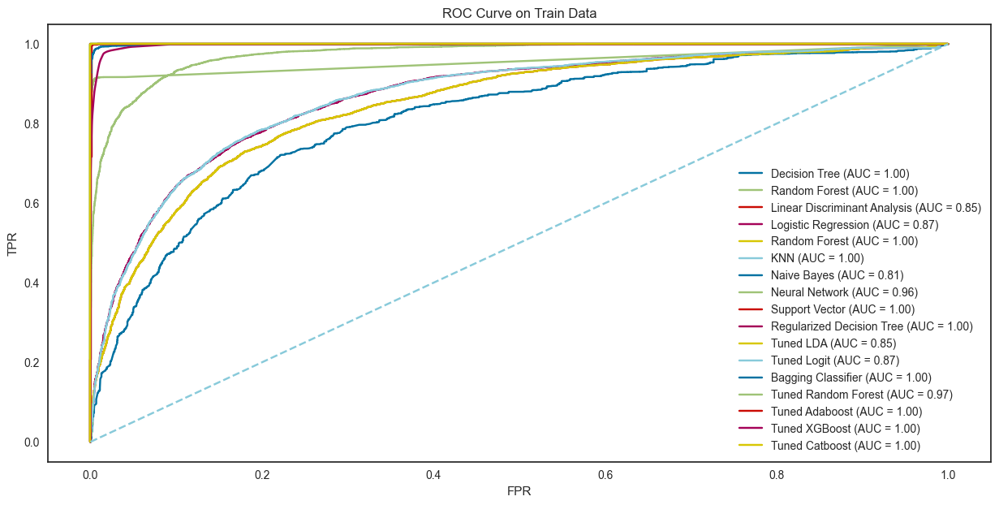

In [253]:
from sklearn.metrics import roc_curve, auc
# Fit all models if they are not already fitted
for model_name, model in models:
    if not hasattr(model, 'is_fitted_') or not model.is_fitted_:
        model.fit(X_train_smote, y_train_smote)
        model.is_fitted_ = True  # Mark the model as fitted

# ROC for Train data
plt.figure(figsize=[15, 7])
plt.title('ROC Curve on Train Data')
plt.xlabel('FPR')
plt.ylabel('TPR')

for model_name, model in models:
    if "predict_proba" in dir(model):
        pred_prob_train = model.predict_proba(X_train_smote)[:, 1]
    else:
        pred_prob_train = model.decision_function(X_train_smote)
    fpr_train, tpr_train, thresholds_train = roc_curve(y_train_smote, pred_prob_train)
    roc_auc = auc(fpr_train, tpr_train)
    plt.plot(fpr_train, tpr_train, label=f"{model_name} (AUC = {roc_auc:.2f})")

plt.plot([0, 1], [0, 1], linestyle='--')
plt.legend()
plt.show()

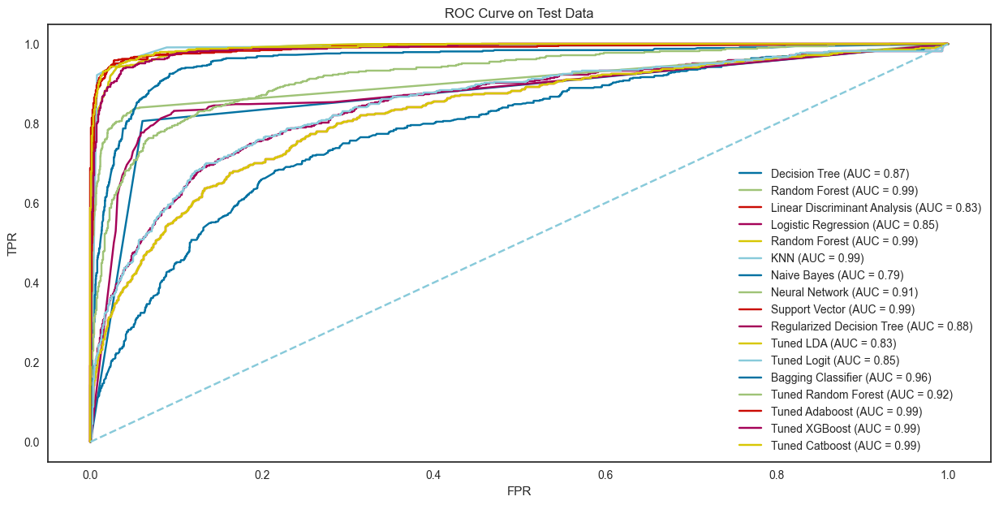

In [254]:
#ROC for Test data

plt.figure(figsize=[15, 7])
plt.title('ROC Curve on Test Data')
plt.xlabel('FPR')
plt.ylabel('TPR')

for model_name, model in models:
    if "fit" in dir(model):
        if "predict_proba" in dir(model):
            pred_prob_test = model.predict_proba(X_test_smote)[:, 1]
        else:
            pred_prob_test = model.decision_function(X_test_smote)
    else:
        if "predict_proba" in dir(model):
            pred_prob_test = model.fit(X_train_smote, y_train_smote).predict_proba(X_test_smote)[:, 1]
        else:
            pred_prob_test = model.fit(X_train_smote, y_train_smote).decision_function(X_test_smote)
    fpr_test, tpr_test, thresholds_test = roc_curve(y_test_smote, pred_prob_test)
    roc_auc = auc(fpr_test, tpr_test)
    plt.plot(fpr_test, tpr_test, label=f"{model_name} (AUC = {roc_auc:.2f})")
plt.plot([0, 1], [0, 1], linestyle='--')
plt.legend()
plt.show()

In [255]:
#Train data
from sklearn.metrics import classification_report, accuracy_score

classification_reports = {}
class_labels = ['Majority', 'Minority']
metrics = ['precision', 'recall', 'f1-score']

for model_name, model in models:
    predictions = model.predict(X_train_smote)
    report = classification_report(y_train_smote, predictions, target_names=class_labels, output_dict=True)
    accuracy = accuracy_score(y_train_smote, predictions)
    report['accuracy'] = accuracy
    classification_reports[model_name] = report

summary_table = pd.DataFrame()

for model_name, report in classification_reports.items():
    model_metrics = {}
    for class_label in class_labels:
        for metric in metrics:
            model_metrics[f'{class_label} {metric}'] = report[class_label][metric]
    model_metrics['accuracy'] = report['accuracy']
    summary_table[model_name] = model_metrics

summary_table = summary_table.T.sort_values(by='Minority recall', ascending=False)

# Print the summary table
print("Classification Reports for Minority and Majority Classes- Train:")
display(summary_table)

Classification Reports for Minority and Majority Classes- Train:


,Majority precision,Majority recall,Majority f1-score,Minority precision,Minority recall,Minority f1-score,accuracy
Decision Tree,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Random Forest,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Tuned Adaboost,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
Tuned Catboost,0.999848,0.999848,0.999848,0.999848,0.999848,0.999848,0.999848
KNN,0.999693,0.989049,0.994343,0.989165,0.999696,0.994402,0.994373
Support Vector,0.999388,0.993916,0.996645,0.993949,0.999392,0.996663,0.996654
Tuned XGBoost,0.996816,1.000000,0.998406,1.000000,0.996806,0.998400,0.998403
Bagging Classifier,0.992068,0.989202,0.990633,0.989233,0.992091,0.990660,0.990646
Regularized Decision Tree,0.979524,0.982205,0.980863,0.982156,0.979468,0.980810,0.980837
Neural Network,0.920056,0.994221,0.955702,0.993714,0.913612,0.951981,0.953916


In [256]:
#Test data
classification_reports = {}
class_labels = ['Majority', 'Minority']
metrics = ['precision', 'recall', 'f1-score']
for model_name, model in models:
    predictions = model.predict(X_test_smote)
    report = classification_report(y_test_smote, predictions, target_names=class_labels, output_dict=True)
    accuracy = accuracy_score(y_test_smote, predictions)
    report['accuracy'] = accuracy
    classification_reports[model_name] = report
summary_table = pd.DataFrame()
for model_name, report in classification_reports.items():
    model_metrics = {}
    for class_label in class_labels:
        for metric in metrics:
            model_metrics[f'{class_label} {metric}'] = report[class_label][metric]
    model_metrics['accuracy'] = report['accuracy']
    summary_table[model_name] = model_metrics
summary_table = summary_table.T.sort_values(by='Minority recall', ascending=False)
# Print the summary table
print("Classification Reports for Minority and Majority Classes- Test:")
display(summary_table)

Classification Reports for Minority and Majority Classes- Test:


,Majority precision,Majority recall,Majority f1-score,Minority precision,Minority recall,Minority f1-score,accuracy
KNN,0.990413,0.963069,0.976550,0.845345,0.955857,0.897211,0.961812
Support Vector,0.983842,0.982431,0.983136,0.917369,0.923599,0.920474,0.972173
Tuned Catboost,0.980797,0.988885,0.984824,0.945230,0.908319,0.926407,0.974837
Random Forest,0.976445,0.980997,0.978716,0.907986,0.887946,0.897854,0.964772
Tuned Adaboost,0.976048,0.993546,0.984719,0.966605,0.884550,0.923759,0.974541
Bagging Classifier,0.964976,0.948369,0.956600,0.773940,0.837012,0.804241,0.928952
Tuned XGBoost,0.964710,0.989961,0.977172,0.945736,0.828523,0.883258,0.961812
Decision Tree,0.958303,0.939405,0.948760,0.737578,0.806452,0.770479,0.916223
Logistic Regression,0.944469,0.756185,0.839904,0.406114,0.789474,0.536332,0.761989
Neural Network,0.956384,0.974901,0.965554,0.869159,0.789474,0.827402,0.942570


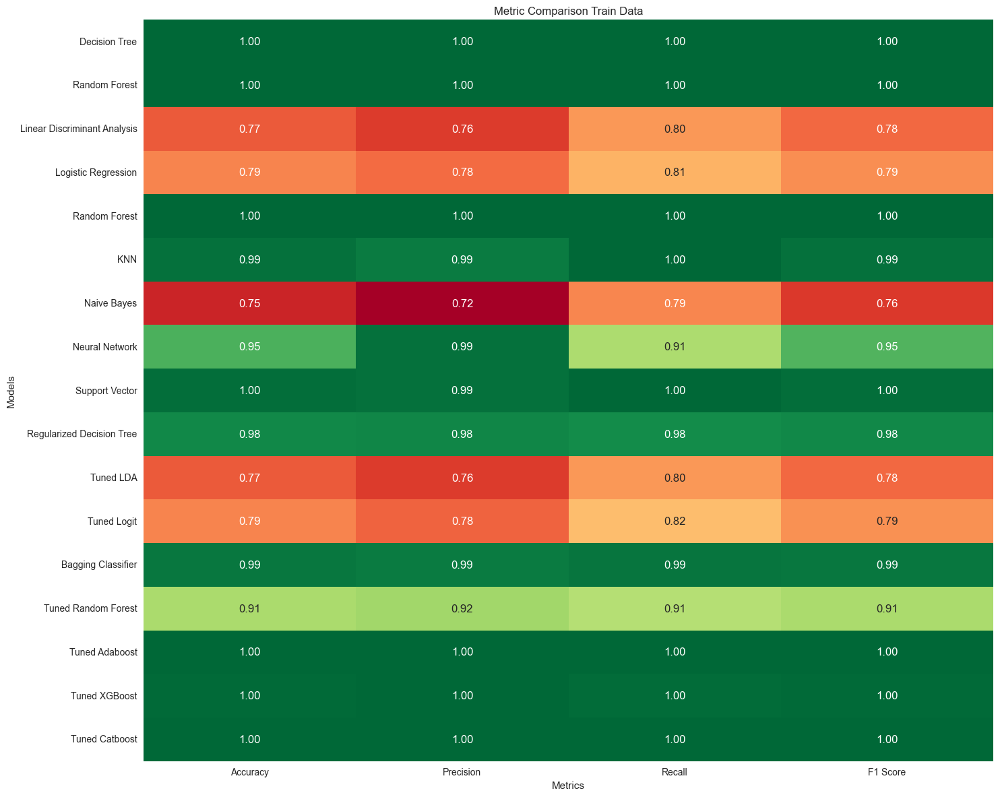

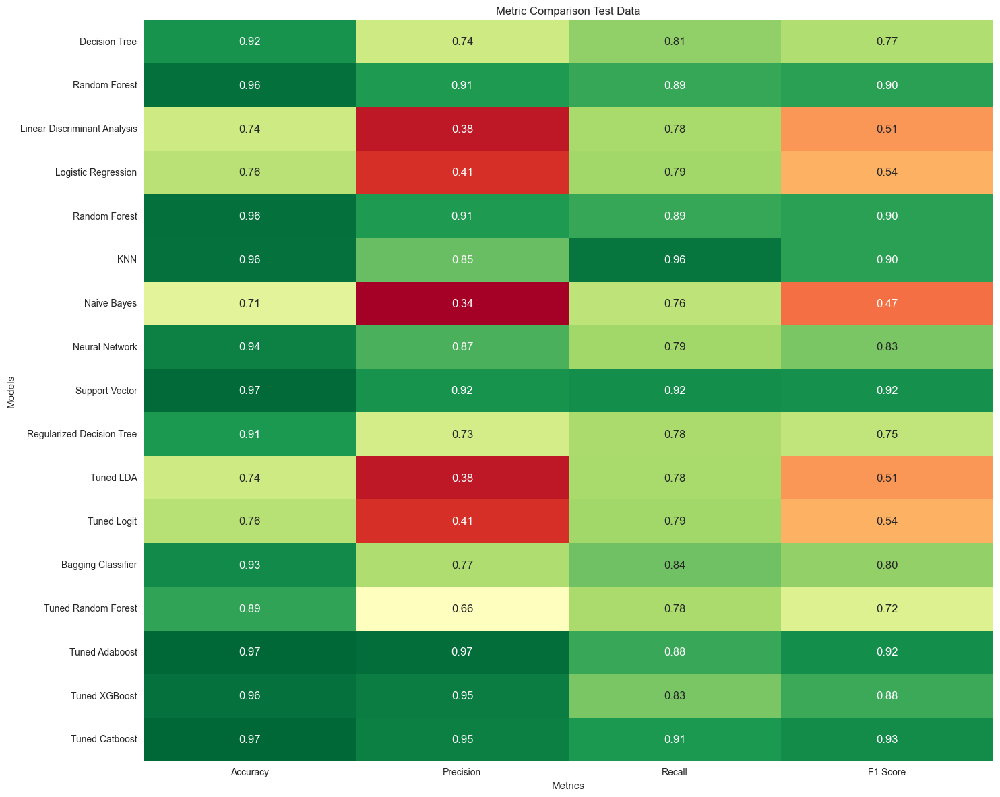

In [257]:
#Metric Comparision visulization
metric_labels = ["Accuracy", "Precision", "Recall", "F1 Score"]

# Plot for Train Data
fig, ax = plt.subplots(figsize=(15, 12))
metric_data = []
for model_name, model in models:
    prediction = model.predict(X_train_smote)
    metrics = [accuracy_score, precision_score, recall_score, f1_score]
    metric_scores = [metric(y_train_smote, prediction) for metric in metrics]
    metric_data.append(metric_scores)

sns.heatmap(metric_data, annot=True, fmt=".2f", cbar=False, cmap="RdYlGn", 
            xticklabels=metric_labels, yticklabels=[model_name for model_name, _ in models], ax=ax)
ax.set_title(f"Metric Comparison Train Data")
ax.tick_params(axis='y', rotation=0)
ax.set_xlabel("Metrics")
ax.set_ylabel("Models")
plt.tight_layout()
plt.show()

# Plot for Test Data
fig, ax = plt.subplots(figsize=(15, 12))
metric_data = []
for model_name, model in models:
    prediction = model.predict(X_test_smote)
    metrics = [accuracy_score, precision_score, recall_score, f1_score]
    metric_scores = [metric(y_test_smote, prediction) for metric in metrics]
    metric_data.append(metric_scores)

sns.heatmap(metric_data, annot=True, fmt=".2f", cbar=False, cmap="RdYlGn", 
            xticklabels=metric_labels, yticklabels=[model_name for model_name, _ in models], ax=ax)
ax.set_title(f"Metric Comparison Test Data")
ax.tick_params(axis='y', rotation=0)
ax.set_xlabel("Metrics")
ax.set_ylabel("Models")
plt.tight_layout()
plt.show()